In [162]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import minimize
from astropy.io import fits
from scipy.signal import argrelextrema
from scipy.optimize import differential_evolution, curve_fit
from scipy.stats import linregress
from numpy import polyfit
from astropy.modeling import models, fitting

In [163]:
#all the fits files for the same star
fits_filenames = [
                  '/home/donlon/Desktop/data/kepler_data/nr_lyrae/q1.fits',
                  '/home/donlon/Desktop/data/kepler_data/nr_lyrae/q2.fits',
                  '/home/donlon/Desktop/data/kepler_data/nr_lyrae/q3.fits',
                  '/home/donlon/Desktop/data/kepler_data/nr_lyrae/q4.fits',
                  '/home/donlon/Desktop/data/kepler_data/nr_lyrae/q5.fits',
                  '/home/donlon/Desktop/data/kepler_data/nr_lyrae/q6.fits',
                  '/home/donlon/Desktop/data/kepler_data/nr_lyrae/q7.fits',
                  '/home/donlon/Desktop/data/kepler_data/nr_lyrae/q8.fits',
                  '/home/donlon/Desktop/data/kepler_data/nr_lyrae/q9.fits',
                  '/home/donlon/Desktop/data/kepler_data/nr_lyrae/q10.fits',
                  '/home/donlon/Desktop/data/kepler_data/nr_lyrae/q11.fits',
                  '/home/donlon/Desktop/data/kepler_data/nr_lyrae/q12.fits',
                  '/home/donlon/Desktop/data/kepler_data/nr_lyrae/q13.fits',
                  '/home/donlon/Desktop/data/kepler_data/nr_lyrae/q14.fits',
                  '/home/donlon/Desktop/data/kepler_data/nr_lyrae/q15.fits',
                  '/home/donlon/Desktop/data/kepler_data/nr_lyrae/q16.fits',
                  '/home/donlon/Desktop/data/kepler_data/nr_lyrae/q17.fits',
                 ]

#load in all the data and build the dictionaries
data = {}
i = 0
for f in fits_filenames:
    
    hdul = fits.open(f)
    splits = [] #context, this may not be required
    
    #split the data up more
    
    #define the splitting for each data period
    len_hdul = len(hdul[1].data['time'])
    if (i != 0) and (f != fits_filenames[-1]): #skip the first and the last, they're already smaller
        n_splits = 8
        splits = [np.arange(j*len_hdul//n_splits, (j+1)*len_hdul//n_splits) for j in range(n_splits)]
    else:
        splits = [np.arange(0, len_hdul)]
    
    for split in splits: #there will only be 1 split if you don't need to split up that data
        
        # Read in the "BJDREF" which is the time offset of the time array.
        bjdrefi = hdul[1].header['BJDREFI']
        bjdreff = hdul[1].header['BJDREFF']

        # Read in the columns of data.
        times = hdul[1].data['time'][split]
        sap_fluxes = hdul[1].data['SAP_FLUX'][split]
        pdcsap_fluxes = hdul[1].data['PDCSAP_FLUX'][split]

        bjds = times + bjdrefi + bjdreff 

        sample_spacing = (bjds[-1] - bjds[0])/len(bjds)
        sample_rate = 1/sample_spacing

        data[i] = {
                   'bjds': bjds,
                   'sap_fluxes': sap_fluxes,
                   'pdcsap_fluxes': pdcsap_fluxes,
                   'sample_spacing': sample_spacing,
                   'sample_rate': sample_rate
                  }
        
        i += 1
    
print('data read in successfully')


data read in successfully


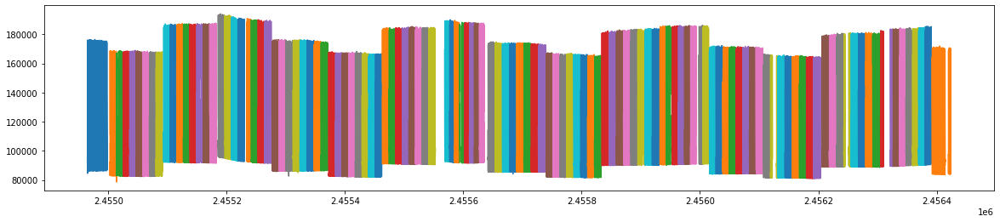

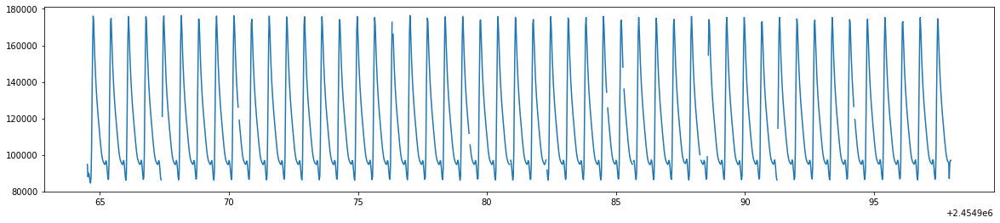

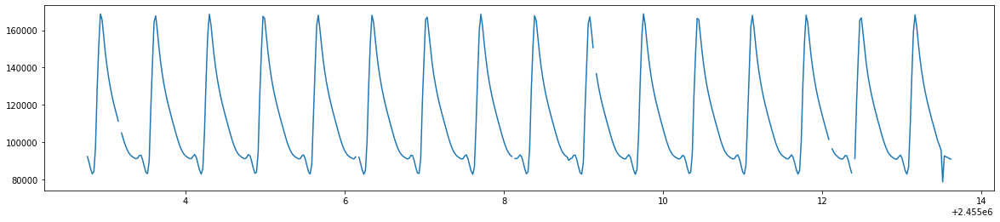

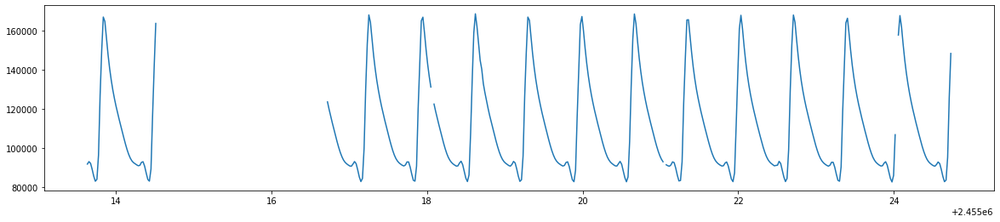

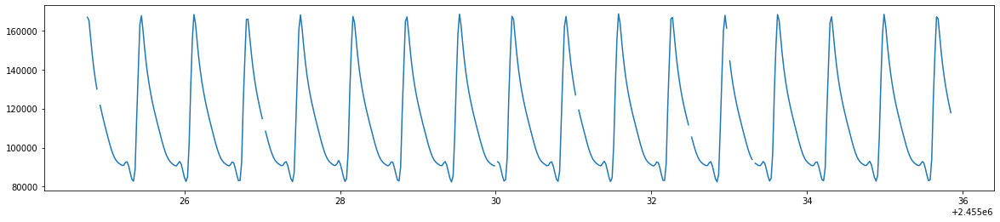

...

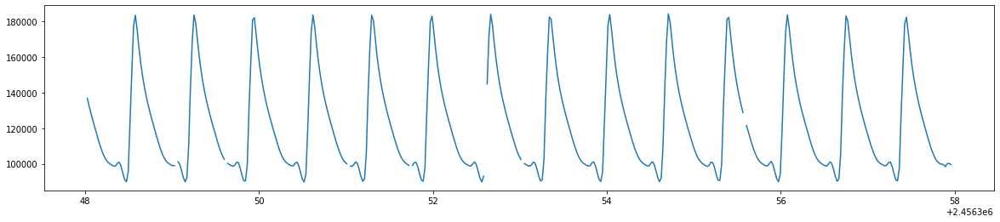

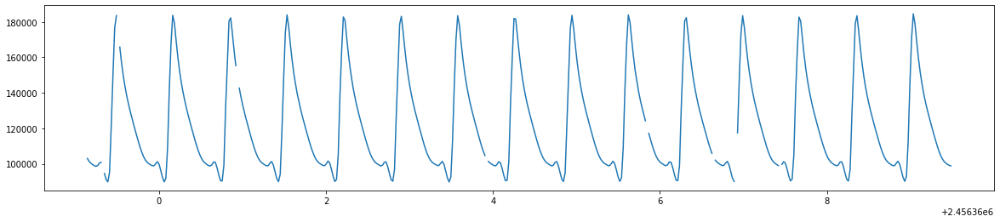

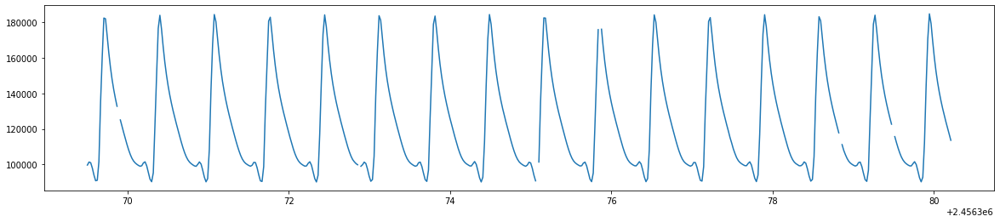

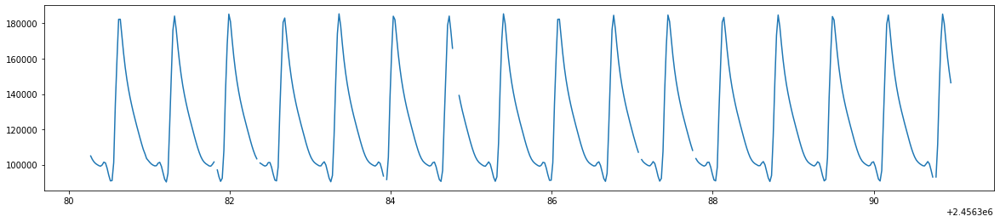

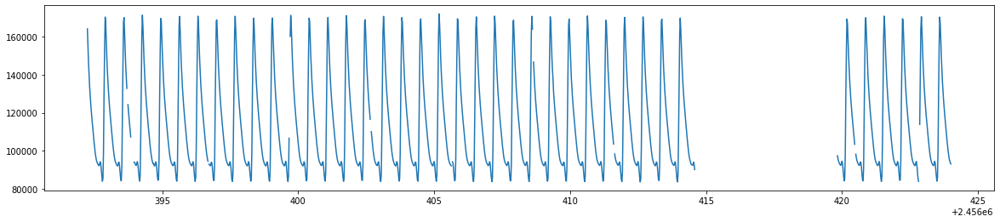

In [164]:
#make some plots of the data

#all the data
fig = plt.figure(figsize=(20, 4))
for key in data.keys():
    plt.plot(data[key]['bjds'], data[key]['pdcsap_fluxes'])
plt.show()

#each time slice
for key in data.keys():
    fig = plt.figure(figsize=(20, 4))
    plt.plot(data[key]['bjds'], data[key]['pdcsap_fluxes'])
    plt.show()

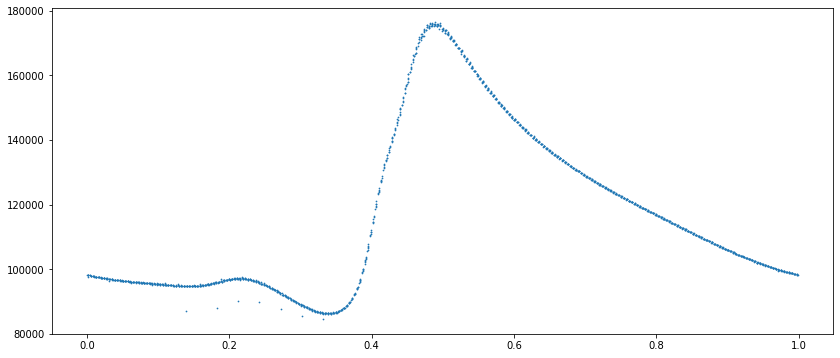

/tmp/ipykernel_62213/3282634693.py:5: RuntimeWarning: invalid value encountered in remainder
  folded_bjds = (data[key]['bjds'] % period)/period


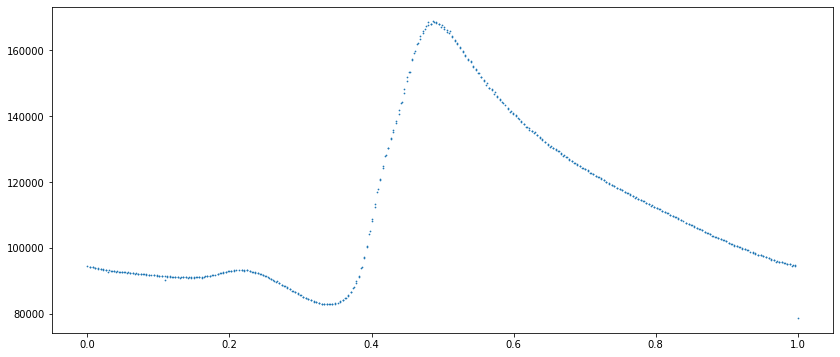

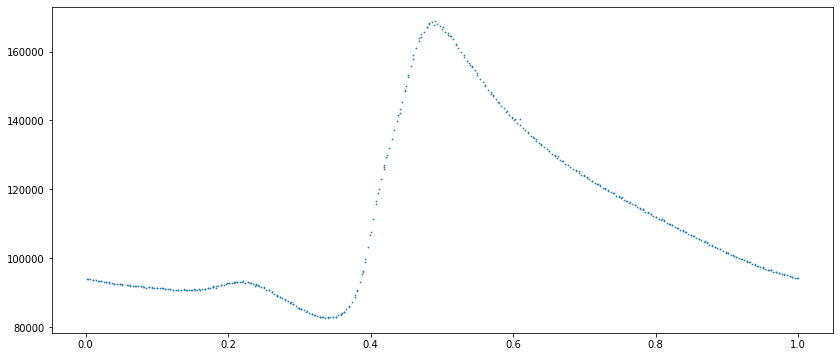

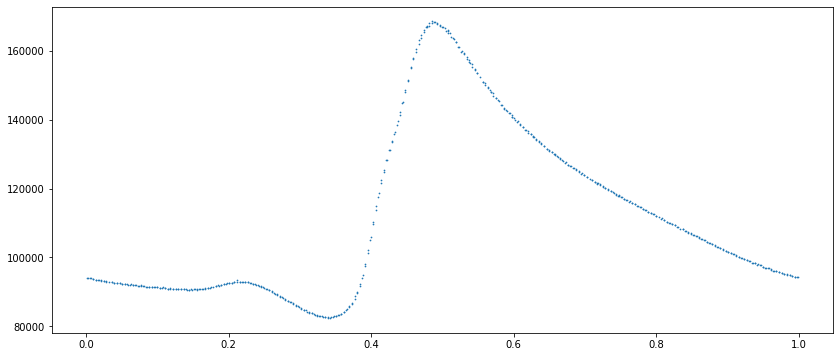

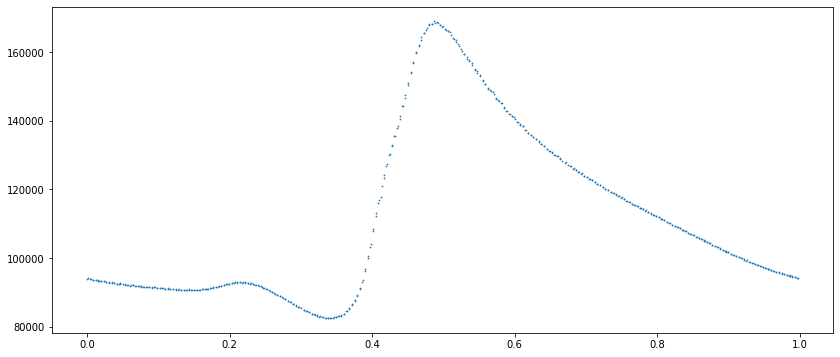

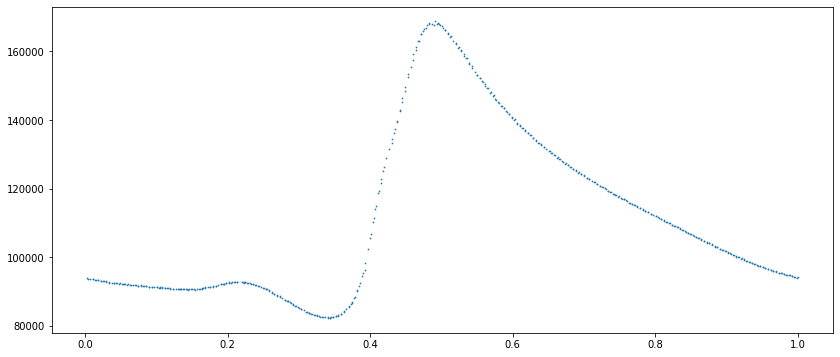

...

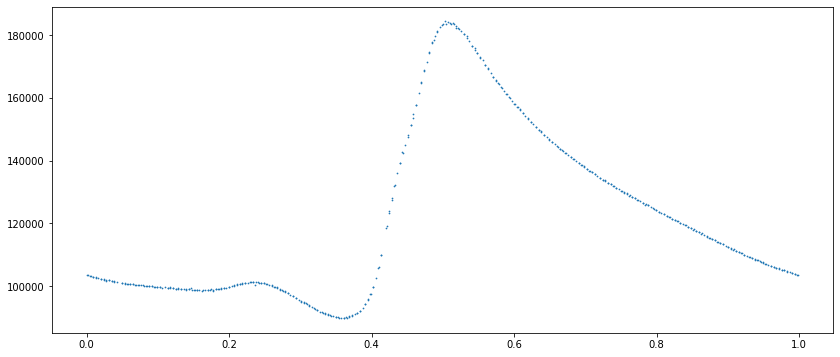

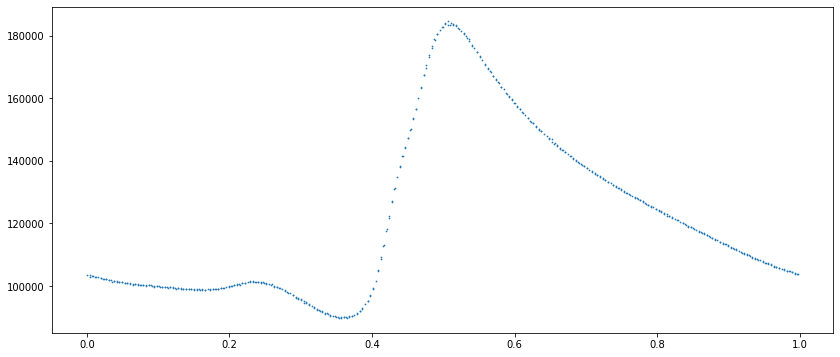

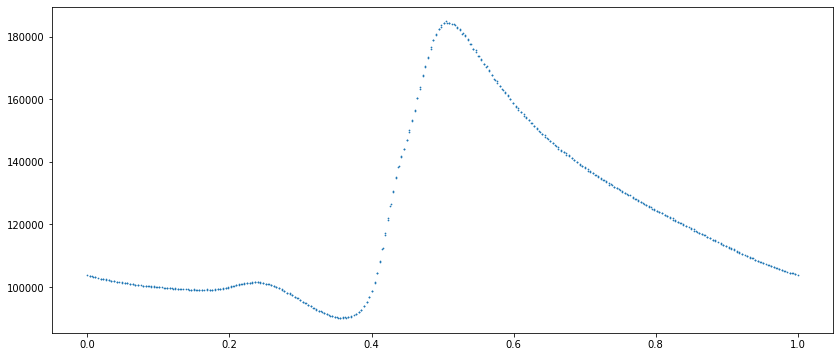

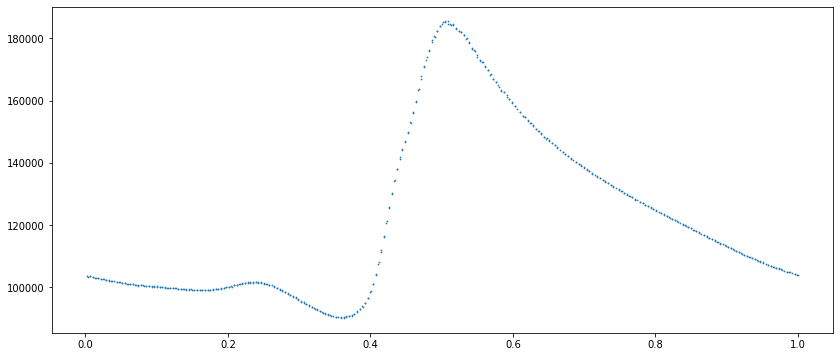

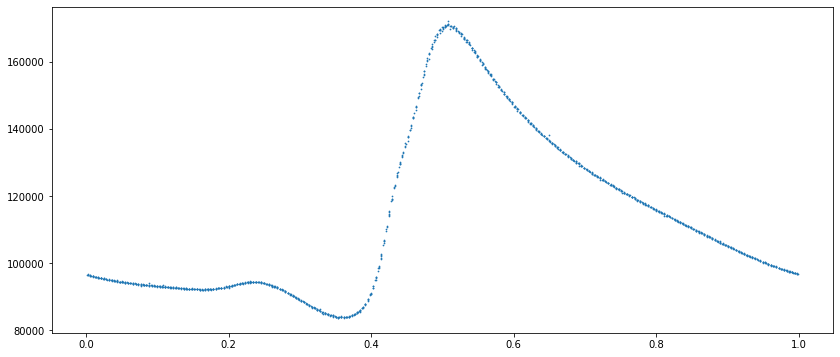

In [165]:
#plot folded data 
period = 0.68202 #BJDs, technically a period guess

for key in data.keys():
    folded_bjds = (data[key]['bjds'] % period)/period

    fig = plt.figure(figsize=(14, 6))
    plt.scatter(folded_bjds, data[key]['pdcsap_fluxes'], s=0.5)
    plt.show()

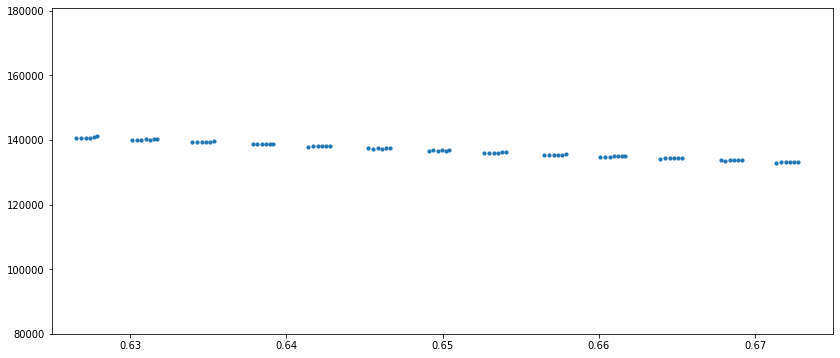

/tmp/ipykernel_62213/1671066977.py:2: RuntimeWarning: invalid value encountered in remainder
  folded_bjds = (data[key]['bjds'] % period)/period


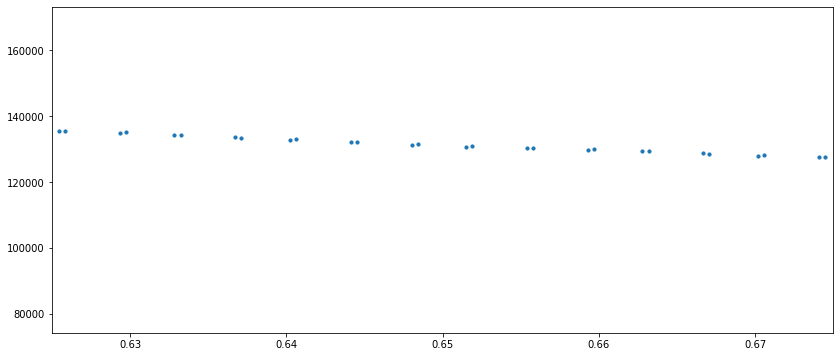

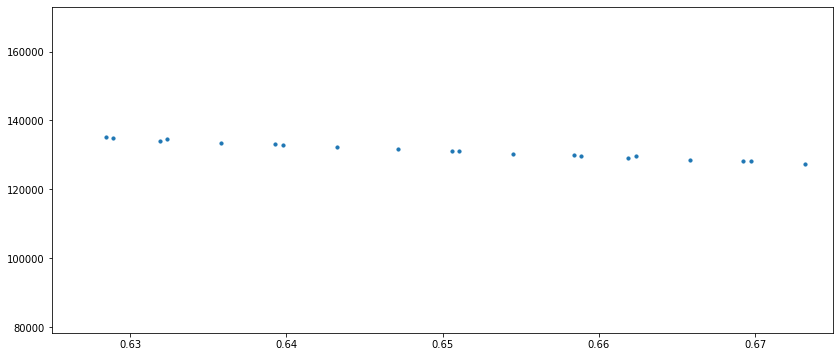

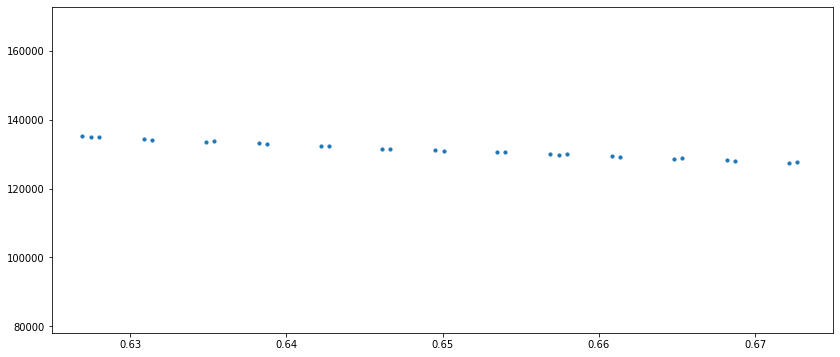

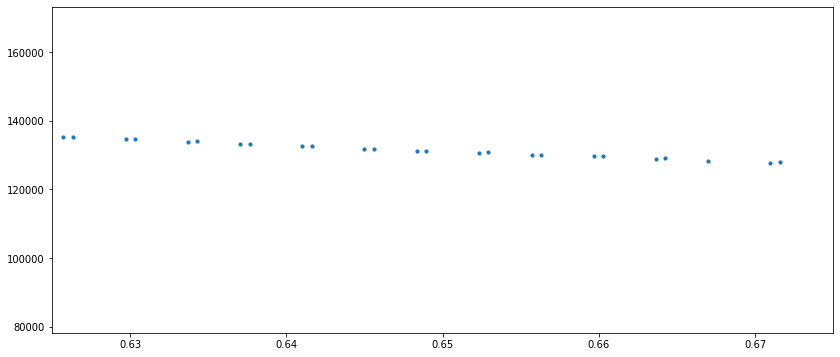

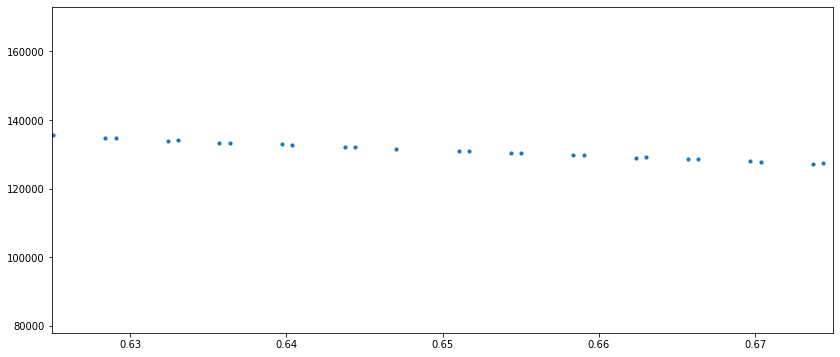

...

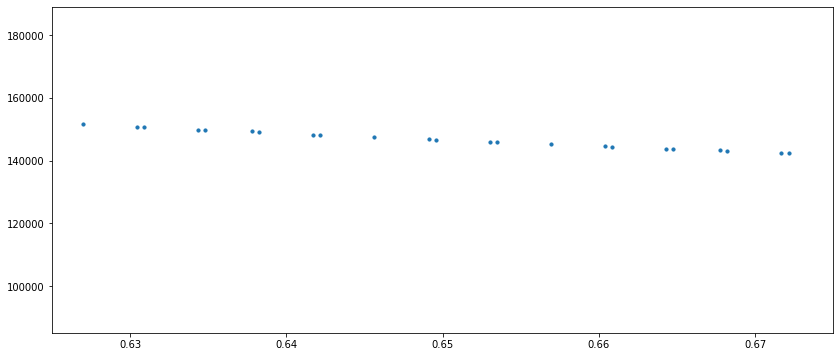

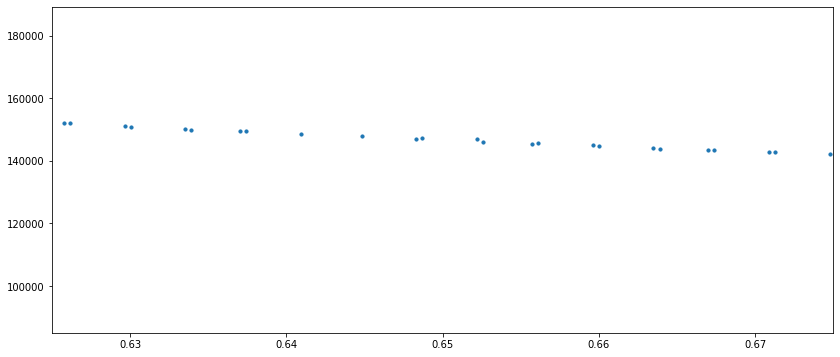

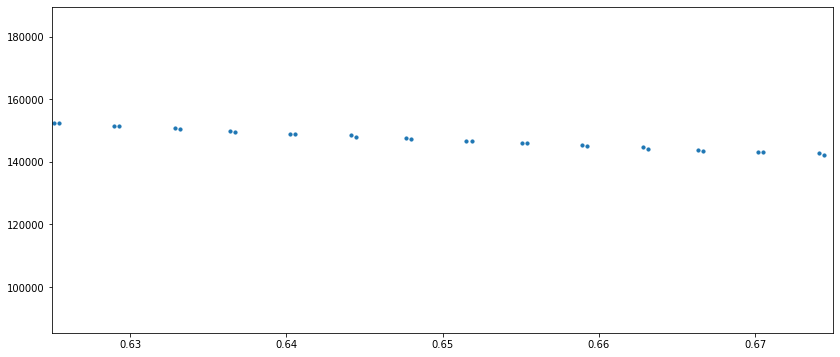

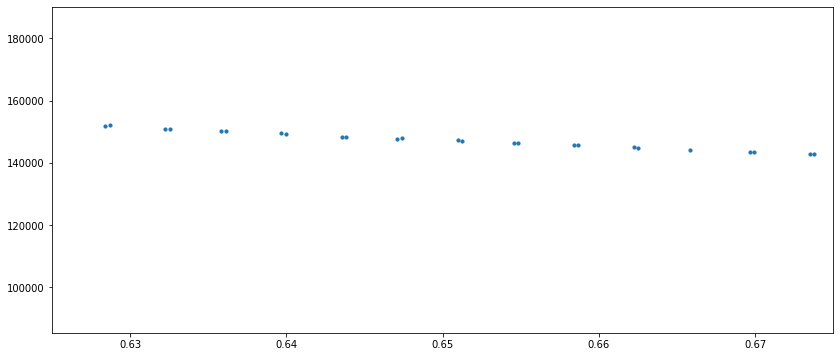

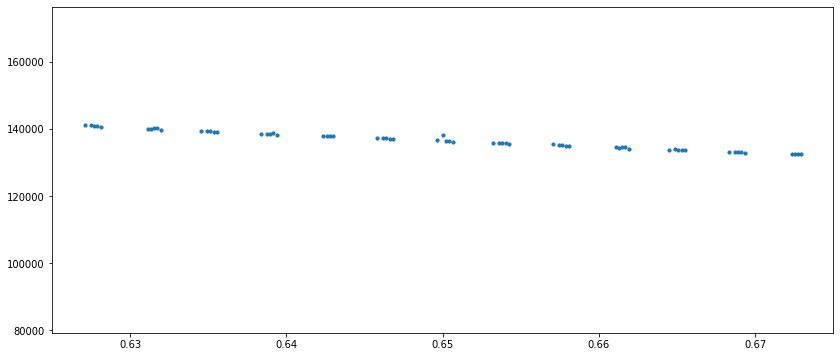

In [166]:
for key in data.keys():
    folded_bjds = (data[key]['bjds'] % period)/period

    fig = plt.figure(figsize=(14, 6))
    plt.scatter(folded_bjds, data[key]['pdcsap_fluxes'], s=10)
    plt.xlim(0.625, 0.675)
    plt.show()

In [199]:
scan_width = 0.000001
scan_n = 1e2

#the optimizer
def likelihood(period, data, verbose_out=False):
   
    #fold the data based on the period
    folded_bjds = (data['bjds'] % period)/period
    
    #bin the data (try 0.01 period bins)
    bin_width = 0.005
    binned_pdcsap_fluxes = []
    binned_bjds = []
    
    i = 0
    while i < 1:
        indx = (folded_bjds >= i)*(folded_bjds < i+bin_width)
        binned_pdcsap_fluxes.append(data['pdcsap_fluxes'][indx])
        binned_bjds.append(folded_bjds[indx])
        i += bin_width
        
    #i hate this
    binned_pdcsap_fluxes = np.array(binned_pdcsap_fluxes)
    binned_bjds = np.array(binned_bjds)
    
    #compute the dispersion of each bin w.r.t. a linear fit:    
    #then adjust the data according to that linear fit
    slope_adj_fluxes = []
    lfs = []
    for i in range(len(binned_bjds)):
        indx = (np.logical_not(np.isnan(binned_bjds[i])))*(np.logical_not(np.isnan(binned_pdcsap_fluxes[i])))
        if len(binned_pdcsap_fluxes[i][indx]) == 0:
            slope_adj_fluxes.append([np.nan, np.nan, np.nan])
        else:
            lf = linregress(binned_bjds[i][indx], binned_pdcsap_fluxes[i][indx])
            lfs.append(lf)
            slope_adj_fluxes.append([binned_pdcsap_fluxes[i][indx][j] - (lf[0]*binned_bjds[i][indx][j] + lf[1]) for j in range(len(binned_pdcsap_fluxes[i][indx]))])
    
        #these are to plot the linear fits if we think there's a problem with those
        #fig = plt.figure(figsize=(6, 6))
        #plt.scatter(binned_bjds[i][indx], binned_pdcsap_fluxes[i][indx])
        #plt.plot([np.min(binned_bjds[i][indx]), np.max(binned_bjds[i][indx])], [lf[0]*np.min(binned_bjds[i][indx]) + lf[1], lf[0]*np.max(binned_bjds[i][indx]) + lf[1]], c='k', ls='--')
        #plt.show()
    
    disps = np.array([np.nanstd(f) for f in slope_adj_fluxes])
    for i in range(len(disps)):
        if len(binned_pdcsap_fluxes[i]) == 0:
            disps[i] = np.nan
    
    #likelihood score is just the sum of all dispersions
    penalty = 1000 #penalize not having anything in a bin
    like = np.nansum(disps**2)/len(disps[np.logical_not(np.isnan(disps))]) + len(disps[np.isnan(disps)])*penalty
    
    if verbose_out:
        return like, disps, lfs
    else:
        return like

# def optimize_time_slices(data):
    
#     best_periods = []
    
#     for key in data.keys():
#         result = minimize(likelihood, period, args=data[key], bounds=[[0, 2]])
#         best_periods.append(result.x)
        
#     return best_periods

# def optimize_time_slices_de(data):
    
#     #differential evolution controls
#     pop_size = 10 #10 times number of parameters
#     diff_scaling_factor = 0.8
#     crossover_rate = 0.9
#     max_it = int(1e10)
    
#     best_periods = []
    
#     for key in data.keys():
#         result = differential_evolution(likelihood, 
#                                         [(period*0.95, period*1.05)], #bounds
#                                         args=(data[key],), 
#                                         maxiter=max_it, 
#                                         popsize=pop_size, 
#                                         mutation=diff_scaling_factor, 
#                                         recombination=crossover_rate, 
#                                         workers=-1, 
#                                         disp=False)
#         best_periods.append(result.x)
        
#     return best_periods

#brute force bc I think that the likelihood surface isn't actually differentiable
def scan_time_slices(data):
    
    times = np.arange(period-scan_n*scan_width, period+scan_n*scan_width, scan_width)
    
    best_periods = []
    all_like_list = []
    
    for key in data.keys():
        
        all_likes = []
    
        best_period = period
        best_like = likelihood(period, data[key])

        for p in times:
            like = likelihood(p, data[key])
            all_likes.append(like)
            if like < best_like:
                best_period = p
                best_like = like

        print('optimized split', key, '/', max(data.keys()))
        best_periods.append(best_period)
        all_like_list.append(all_likes)
        
    return best_periods, all_like_list, times

In [200]:
#optimize the period of each time slice
#best_periods = optimize_time_slices(data)
#best_periods = optimize_time_slices_de(data)
best_periods, all_like_list, times = scan_time_slices(data)
print('Optimized periods:', best_periods)

/tmp/ipykernel_62213/1414111325.py:23: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  binned_pdcsap_fluxes = np.array(binned_pdcsap_fluxes)
/tmp/ipykernel_62213/1414111325.py:24: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  binned_bjds = np.array(binned_bjds)


optimized split 0 / 121


/tmp/ipykernel_62213/1414111325.py:8: RuntimeWarning: invalid value encountered in remainder
  folded_bjds = (data['bjds'] % period)/period
/home/donlon/.local/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:160: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/home/donlon/.local/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:174: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/home/donlon/.local/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:176: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)
/home/donlon/.local/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1664: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


optimized split 1 / 121
optimized split 2 / 121
optimized split 3 / 121
optimized split 4 / 121


KeyboardInterrupt: 

period: 0.68201321625484
variance: 1.1448464257241213e-09


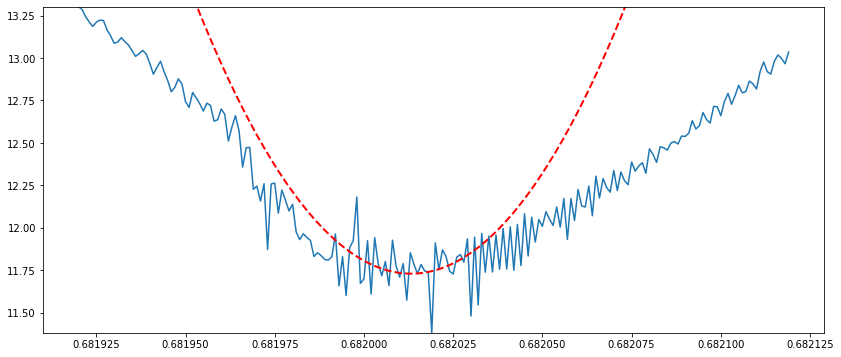

period: 0.6819758242379119
variance: 7.077061086330048e-09


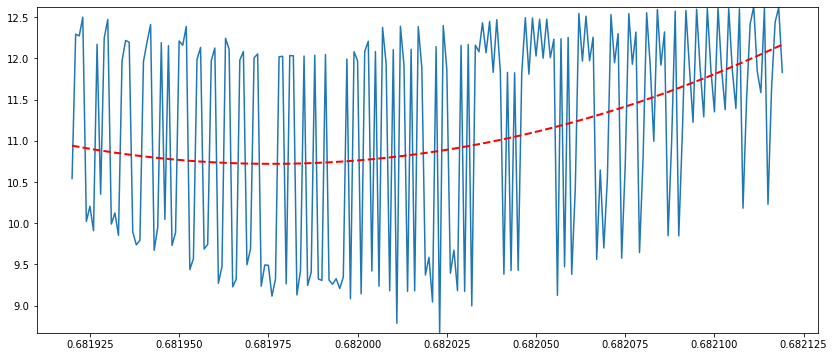

period: 0.6820863557103058
variance: 1.2446766658876424e-08


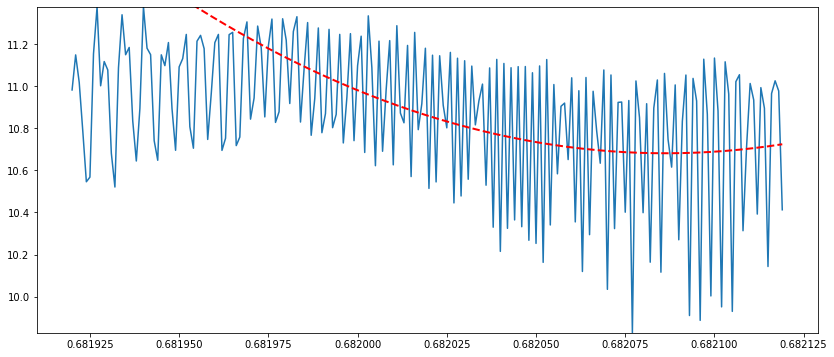

period: 0.6820208902697105
variance: 4.234504674181906e-09


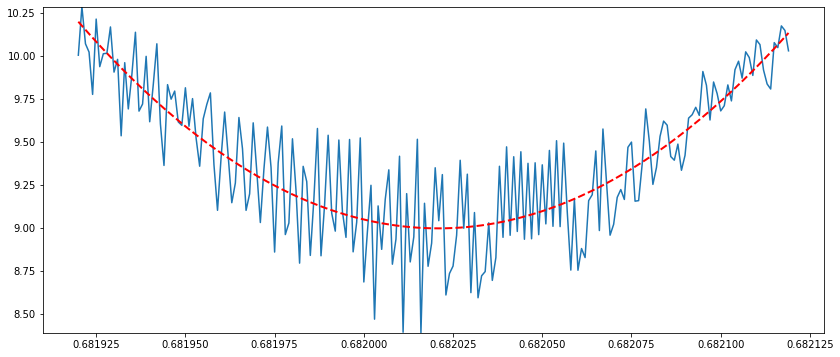

period: 0.6820221573529033
variance: 3.295812708547874e-09


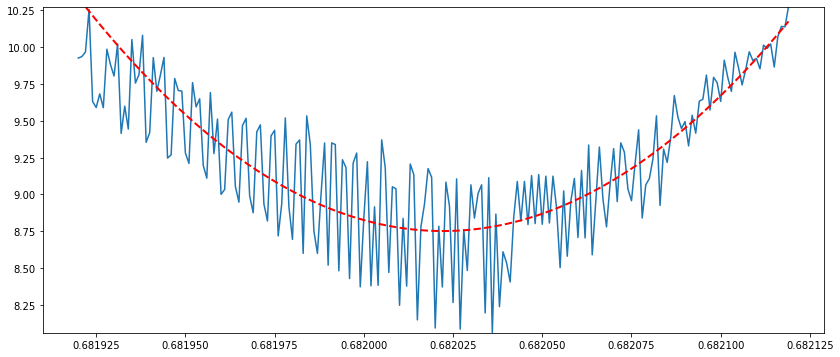

period: 0.6820358394906982
variance: 7.621214128799447e-09


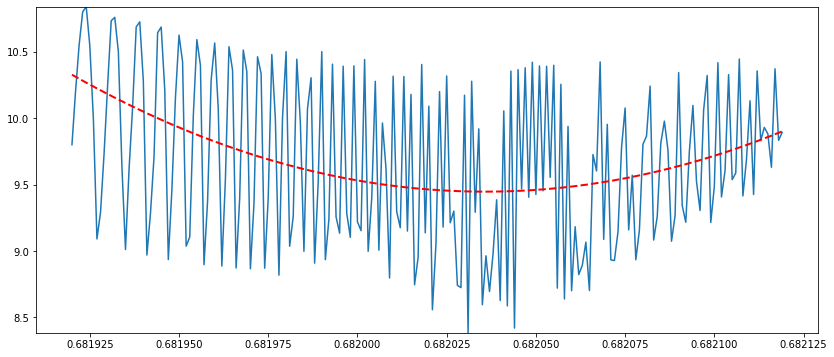

period: 0.6820011780141777
variance: 1.0054365926642283e-08


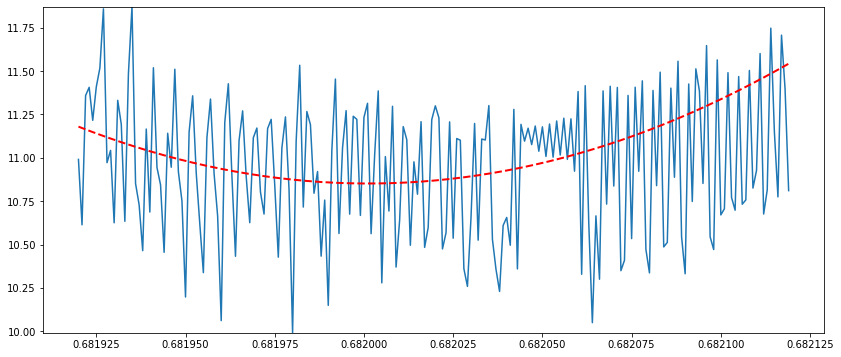

period: 0.6820067915232648
variance: 3.972082471810573e-09


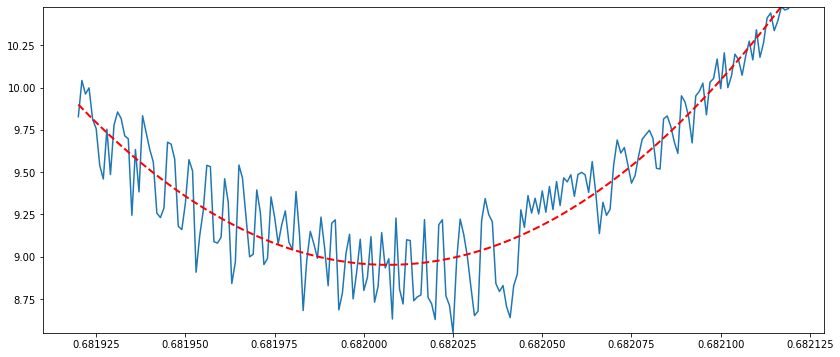

period: 0.6819860980030208
variance: 6.249900778774036e-09


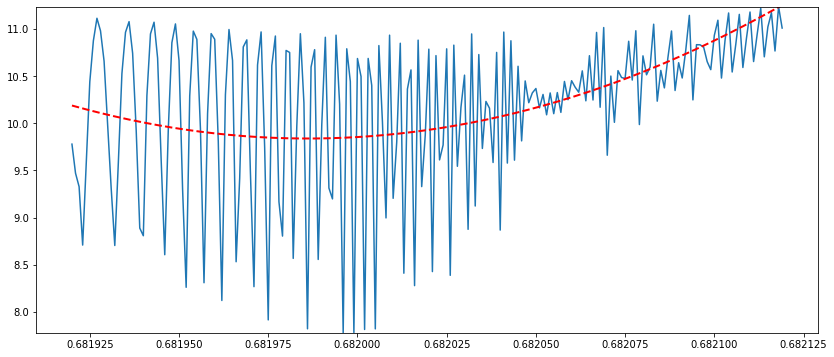

period: 0.6820287997244475
variance: 3.4089525552906463e-09


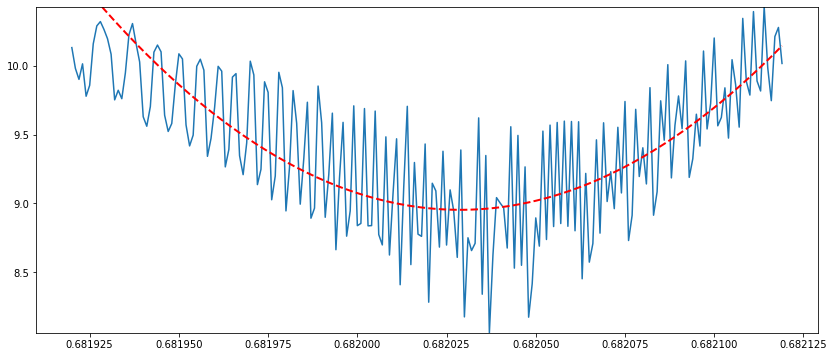

period: 0.6820562990581753
variance: 4.47382271283729e-09


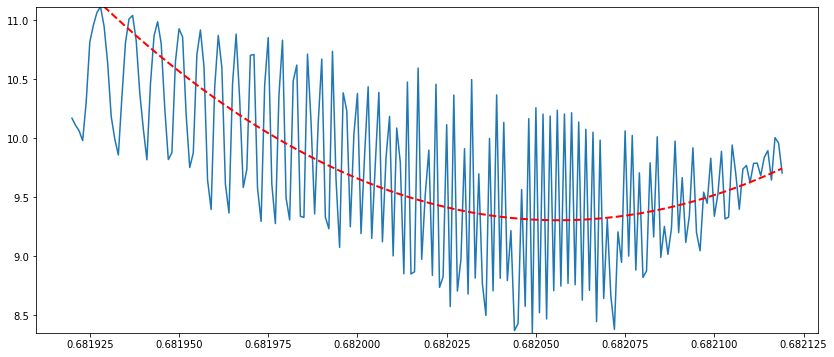

period: 0.6820048914134859
variance: 5.154219897771688e-09


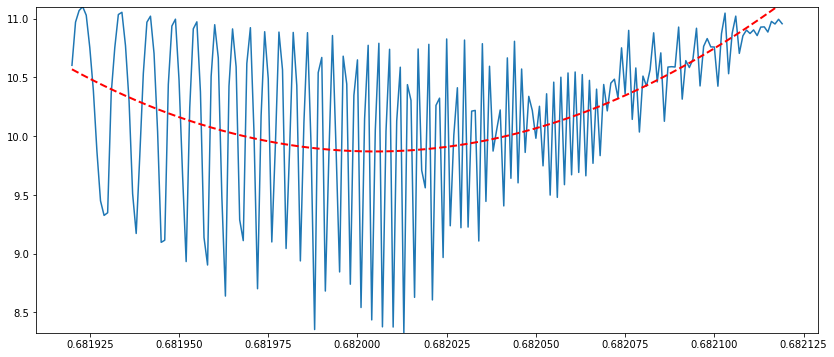

period: 0.6820333066887198
variance: 3.3478876161446256e-09


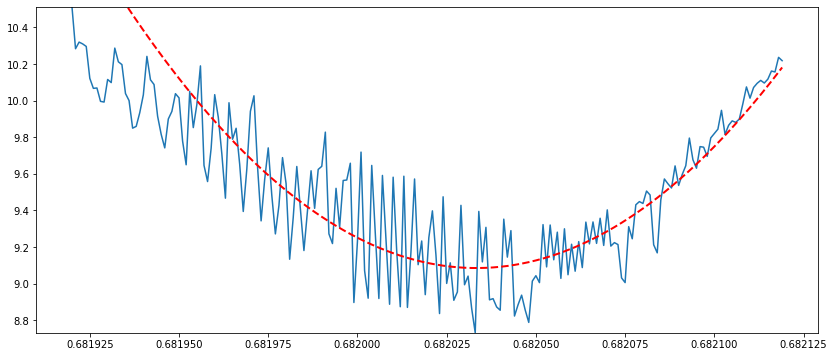

period: 0.6820496376939598
variance: 4.451233069277544e-09


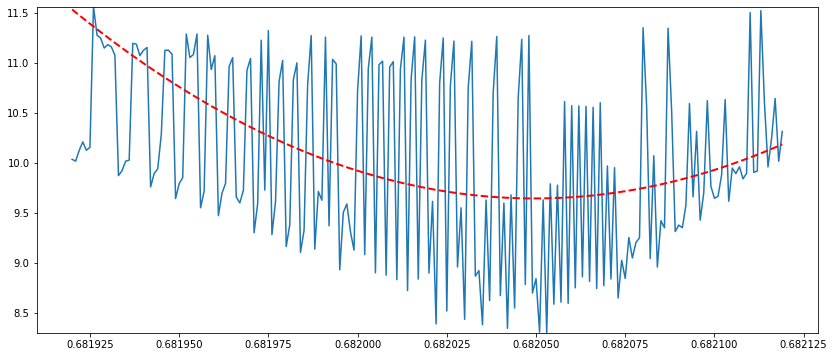

period: 0.6820370682439529
variance: 9.762416278207034e-09


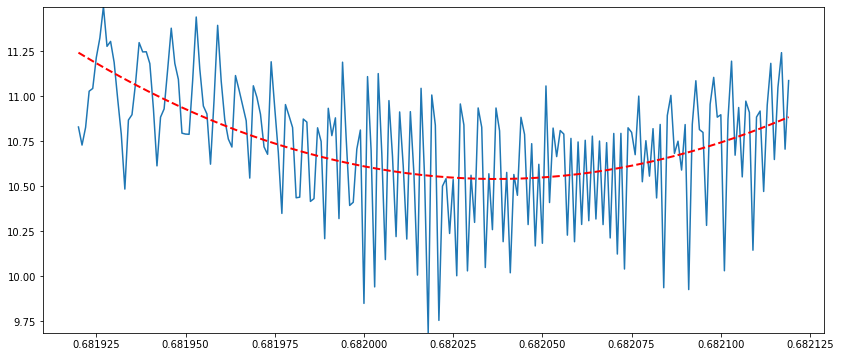

period: 0.6820318688867612
variance: 2.805442958805203e-09


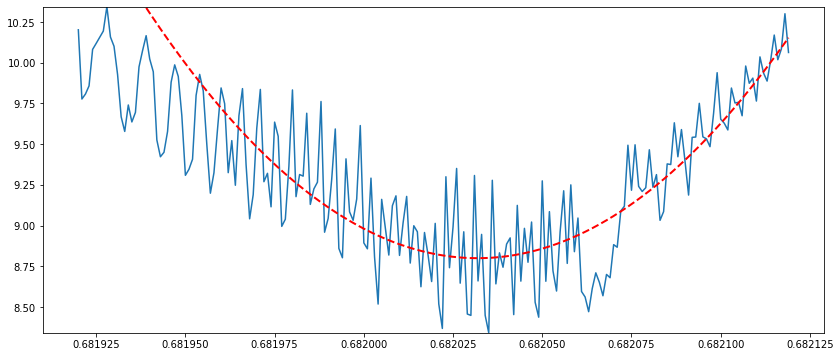

period: 0.6820091940303065
variance: 2.2717815803827094e-09


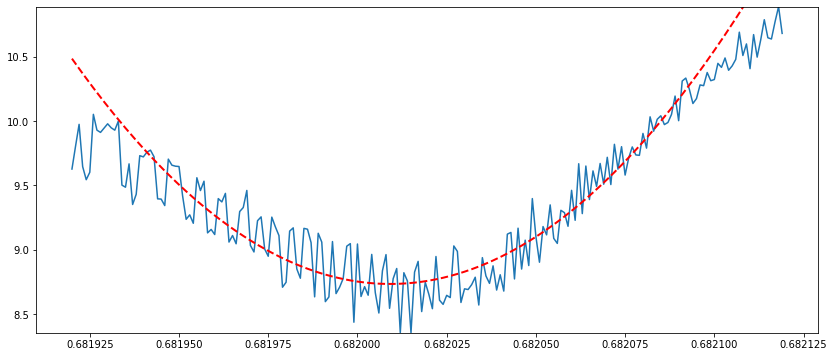

period: 0.6819889652645934
variance: 6.330471783957174e-09


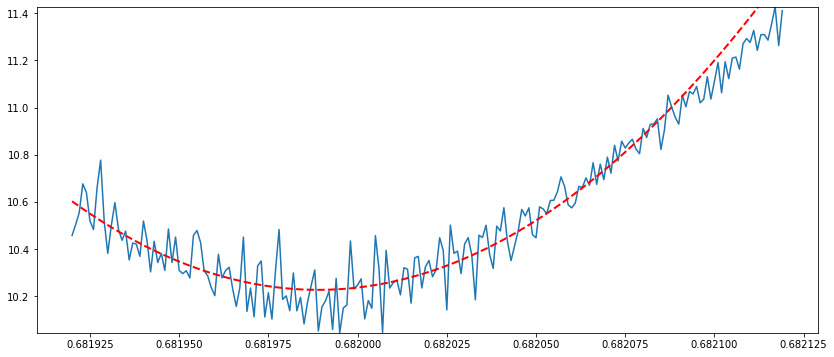

period: 0.6819793490885286
variance: 6.162006909277536e-09


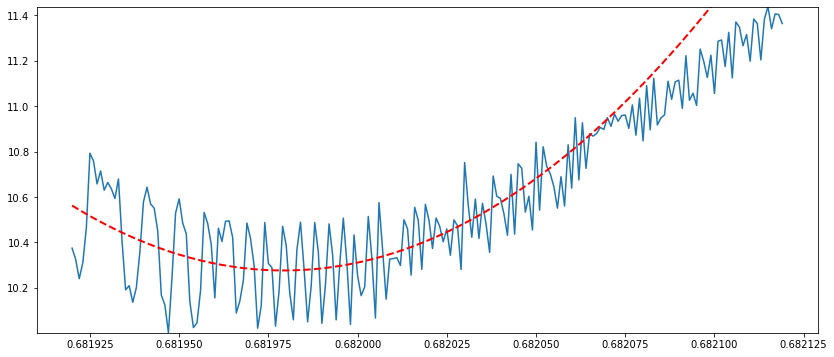

period: 0.6820207876354447
variance: 9.727478597801187e-09


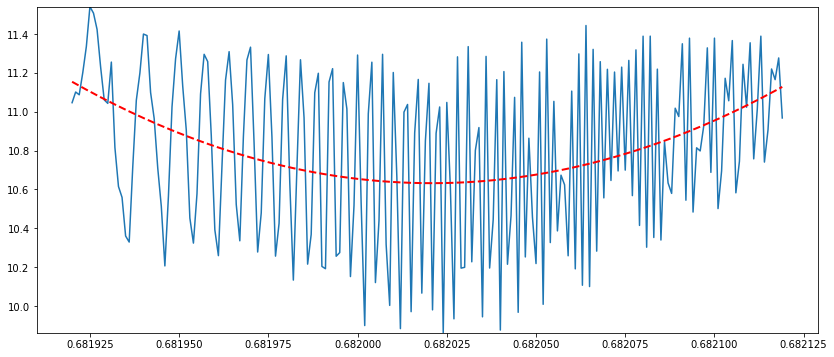

period: 0.6820117841529054
variance: 5.211780817075633e-09


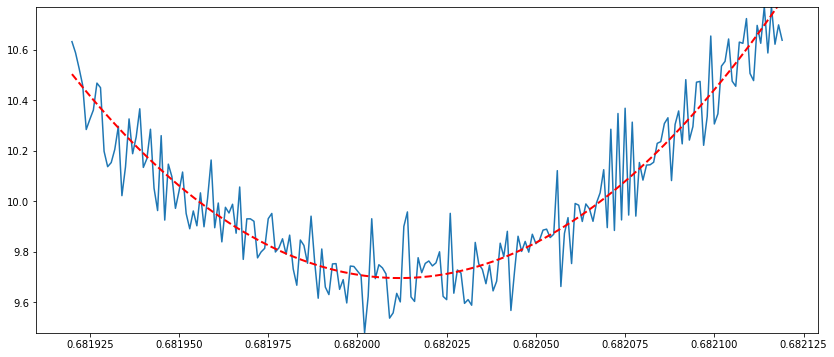

period: 0.6821110233103961
variance: 2.4032668342940033e-10


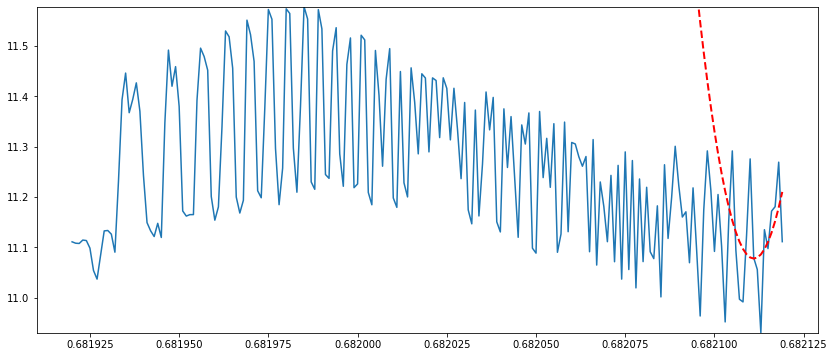

period: 0.6820192123803551
variance: 3.784485005765716e-09


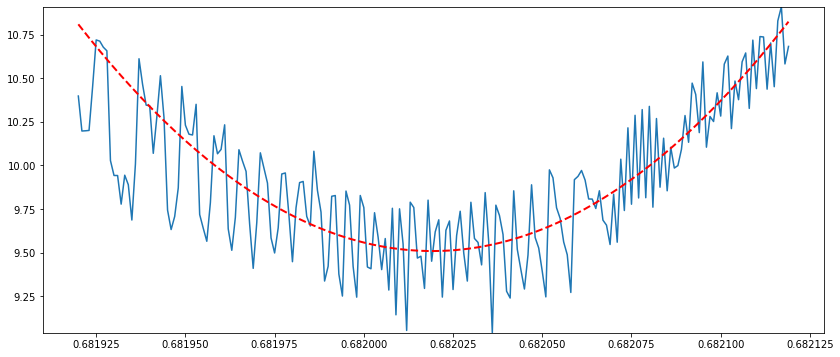

period: 0.6820139963647428
variance: 3.4202415482457748e-09


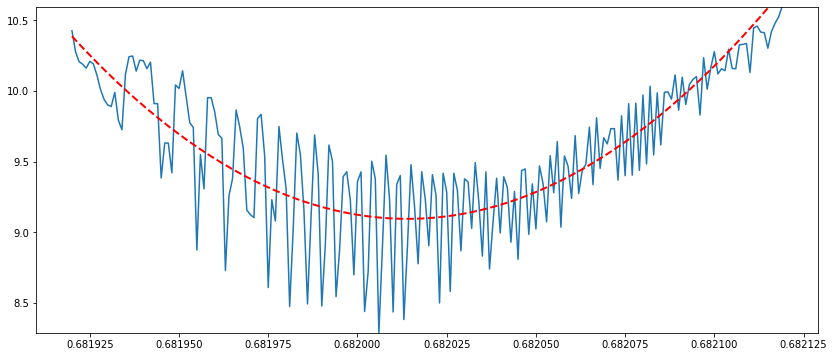

period: 0.6820185717628311
variance: 2.8276983294190883e-09


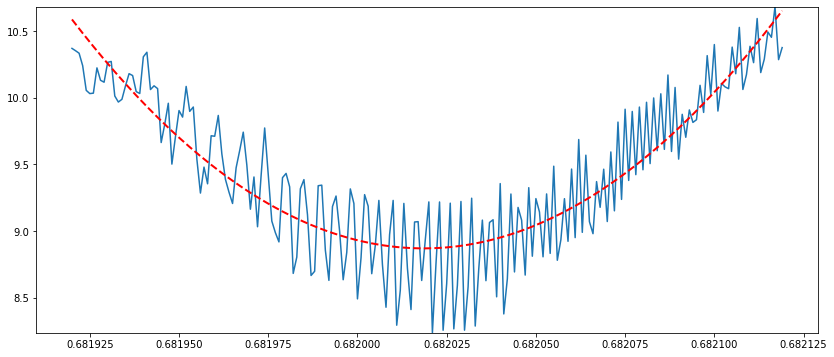

period: 0.6820256736303858
variance: 2.60616270038069e-09


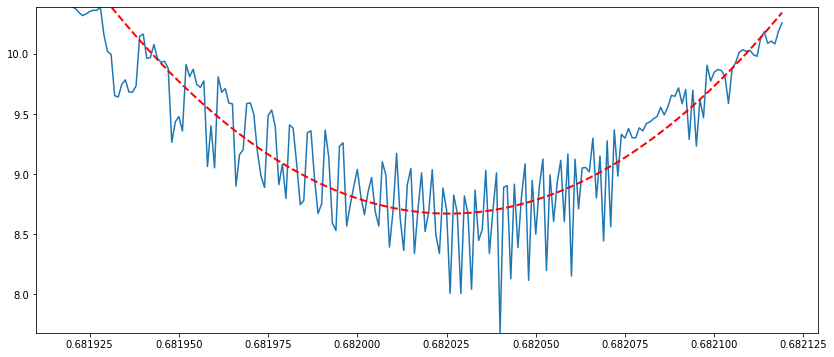

period: 0.682030782389338
variance: 2.5451998975237627e-09


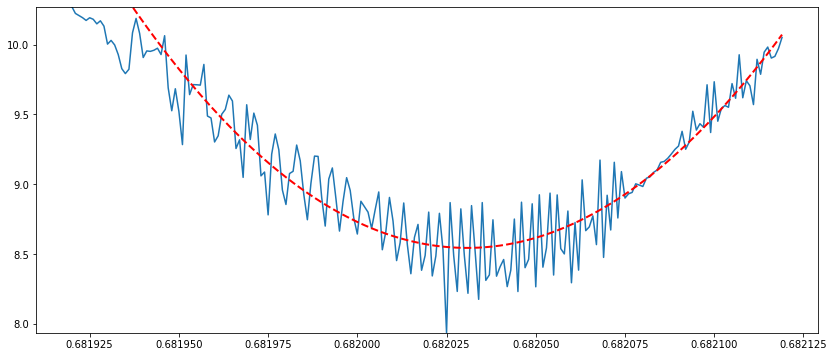

period: 0.6820367249065546
variance: 1.3439396450422375e-08


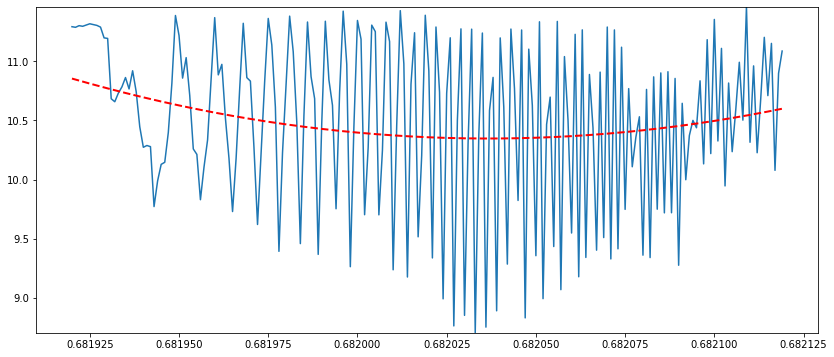

period: 0.6820136964638599
variance: 3.761953057262204e-09


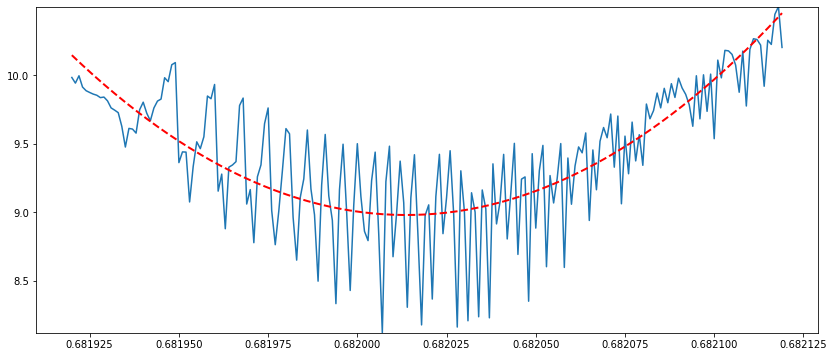

period: 0.6820153105788718
variance: 3.071592306377714e-09


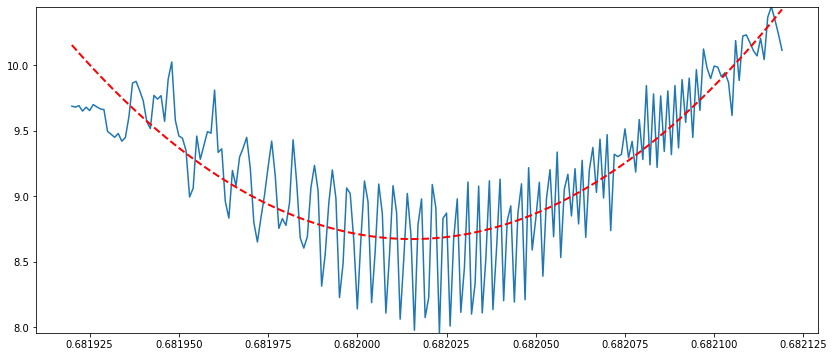

period: 0.682038562372226
variance: 4.350542654407282e-09


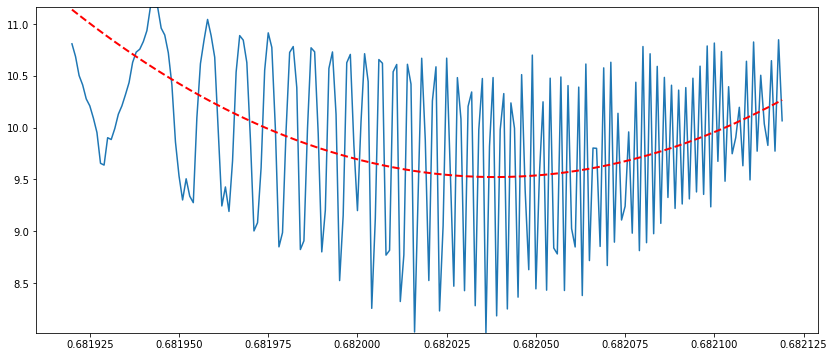

period: 0.682027248337089
variance: 3.0274922735310577e-09


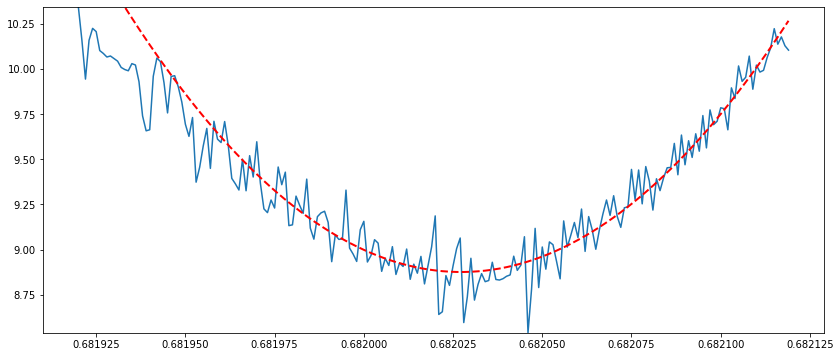

period: 0.6820173456536069
variance: 3.2077971930669414e-09


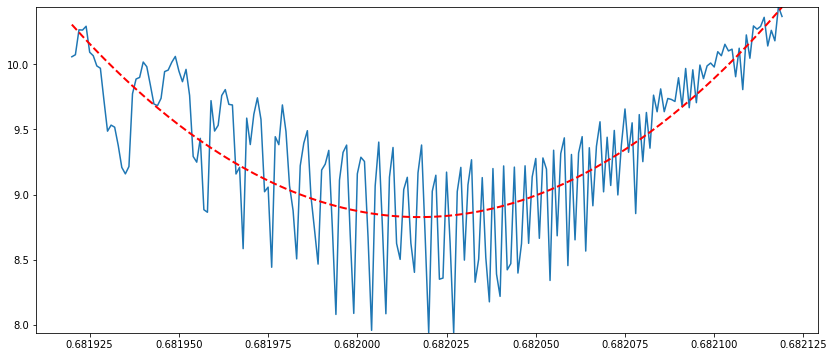

period: 0.6820061966852722
variance: 2.8617910458576042e-09


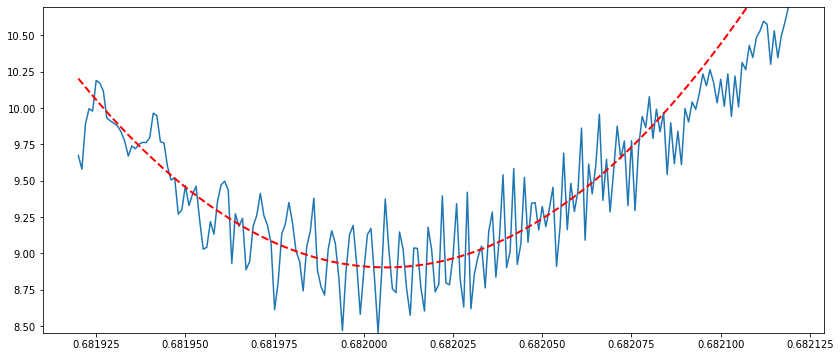

period: 0.6820348673832631
variance: 3.745473633822962e-09


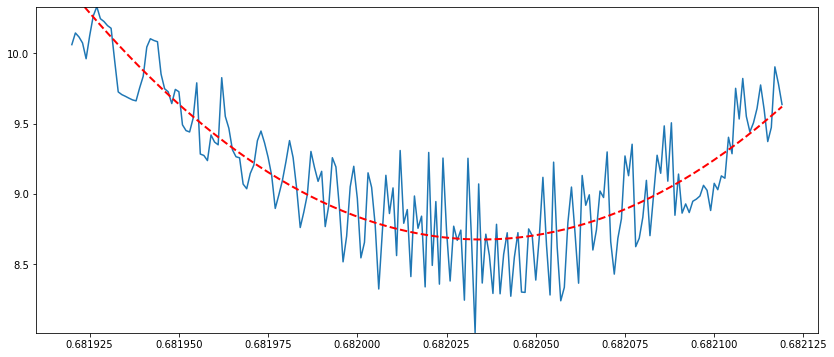

period: 0.6820317603852762
variance: 3.782516275618522e-09


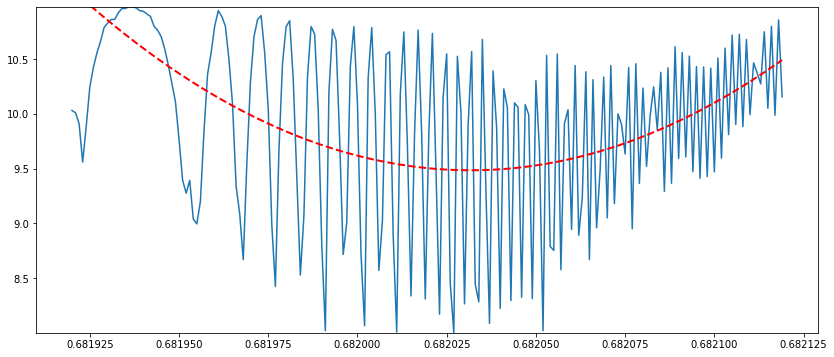

period: 0.68201006658807
variance: 3.274369918208785e-09


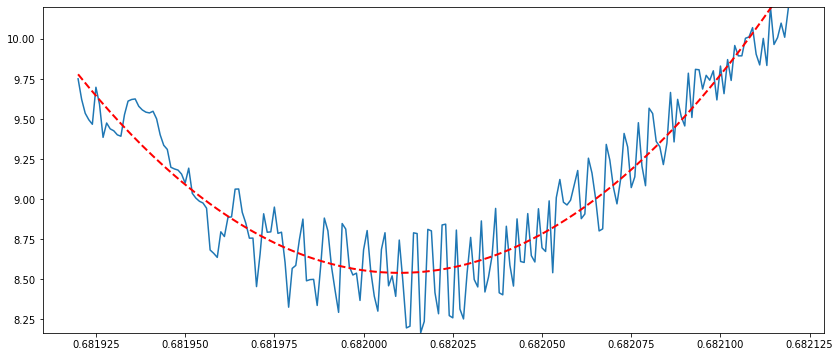

period: 0.6820173354077769
variance: 3.5539423469646733e-09


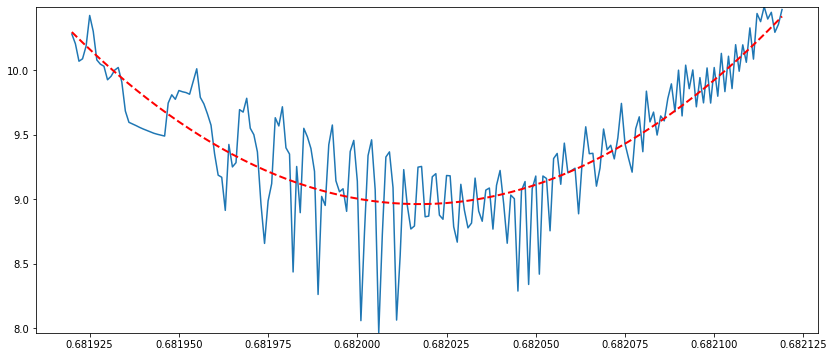

period: 0.6820118704792892
variance: 4.84543565545542e-09


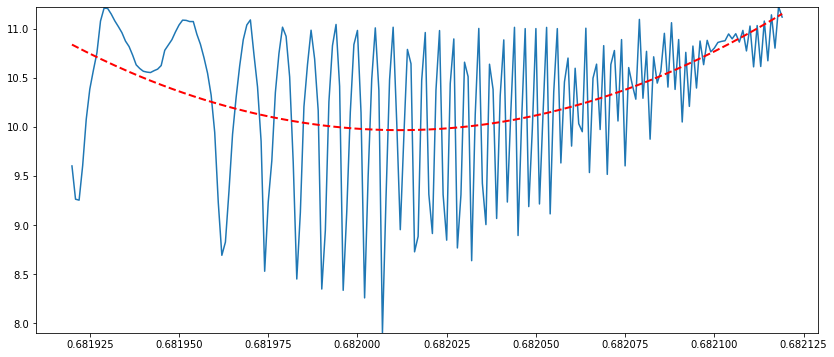

period: 0.6820303305027149
variance: 2.344224910435997e-09


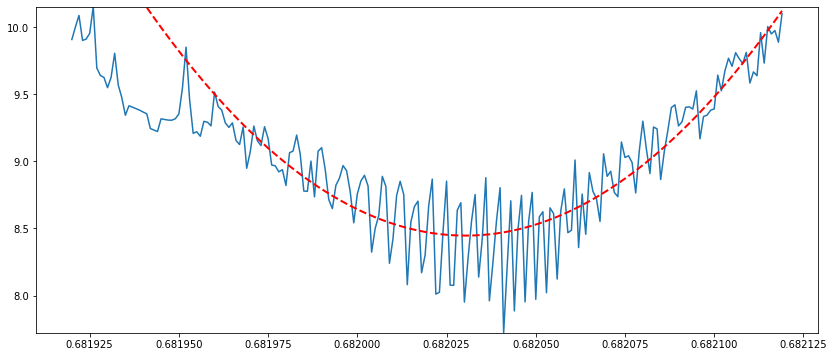

period: 0.6819926411321519
variance: 2.962528247270565e-09


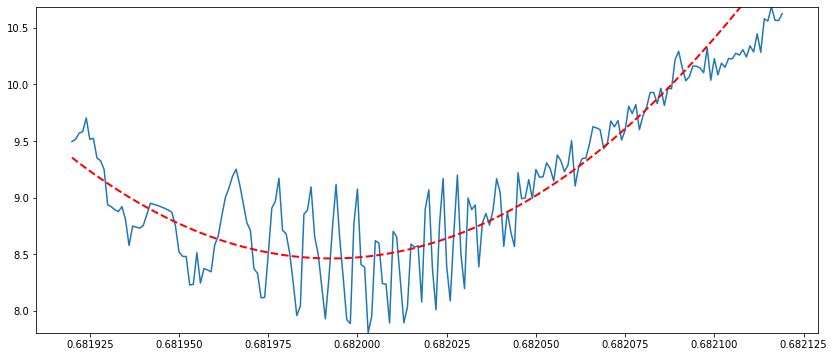

period: 0.6820013047523547
variance: 2.716481560639768e-09


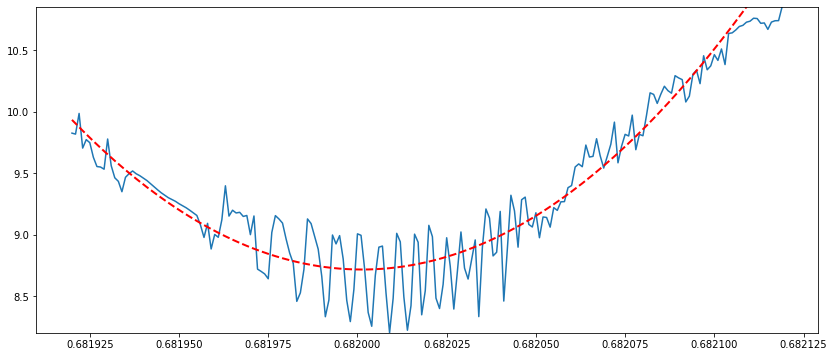

period: 0.6820336723817615
variance: 3.153759563170541e-09


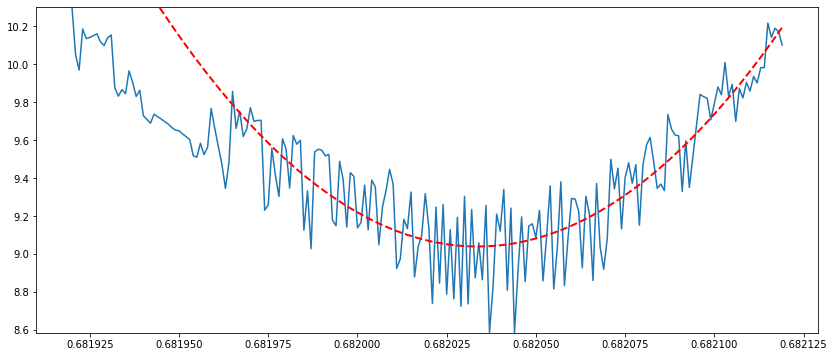

period: 0.6820178839684085
variance: 5.2708842446929176e-09


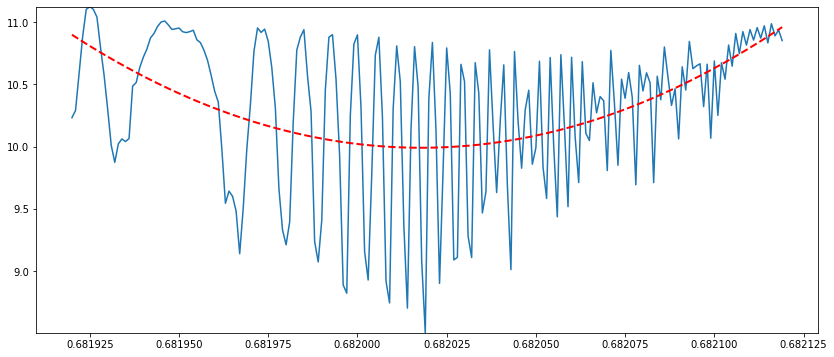

period: 0.6820105427394828
variance: 2.567692586293641e-09


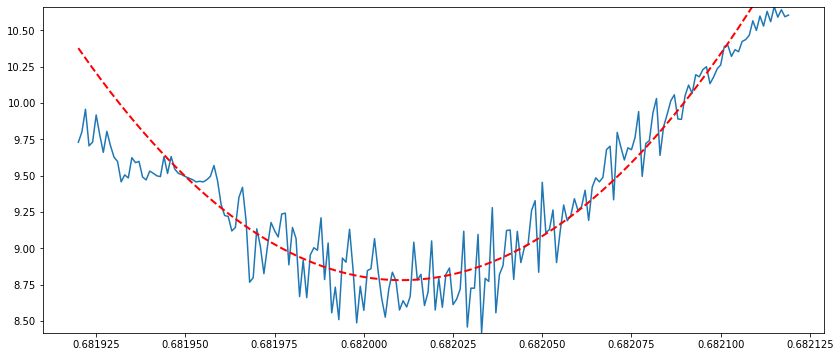

period: 0.6820264430204874
variance: 2.6617288200261672e-09


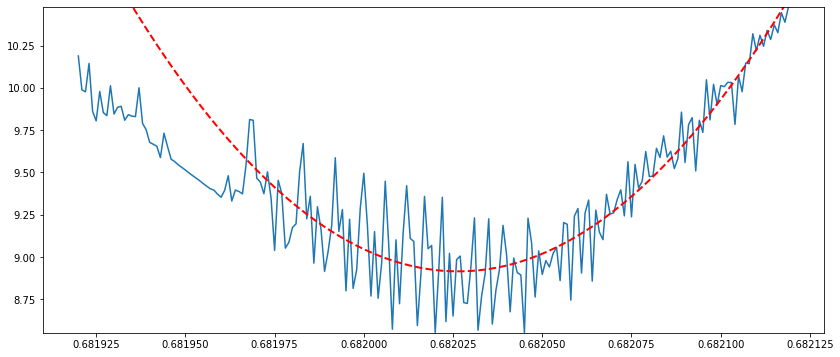

period: 0.6820197743026786
variance: 5.047507775154169e-09


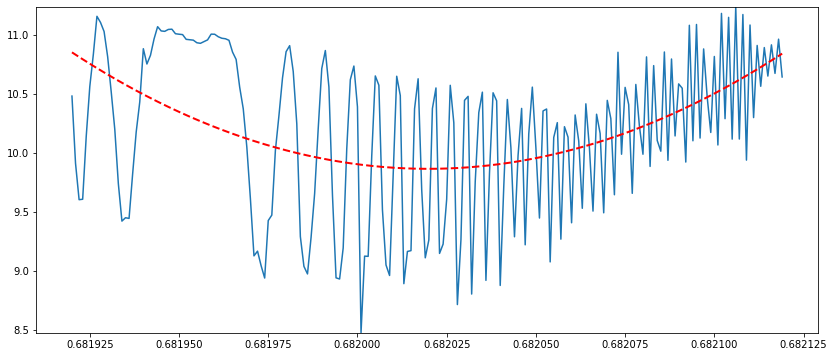

period: 0.682011273014684
variance: 3.0649022995373107e-09


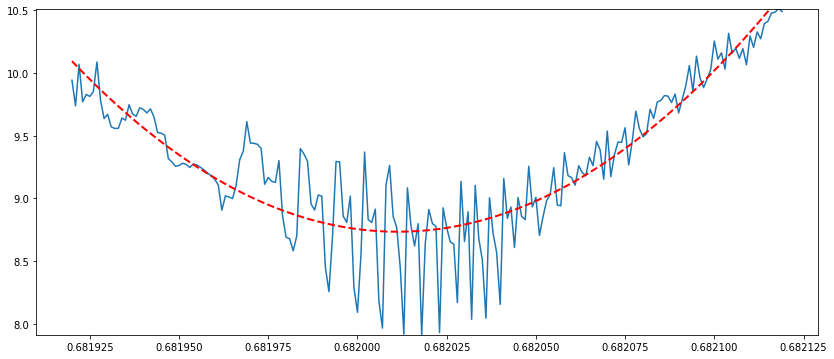

period: 0.6820017310802073
variance: 5.244708138383476e-09


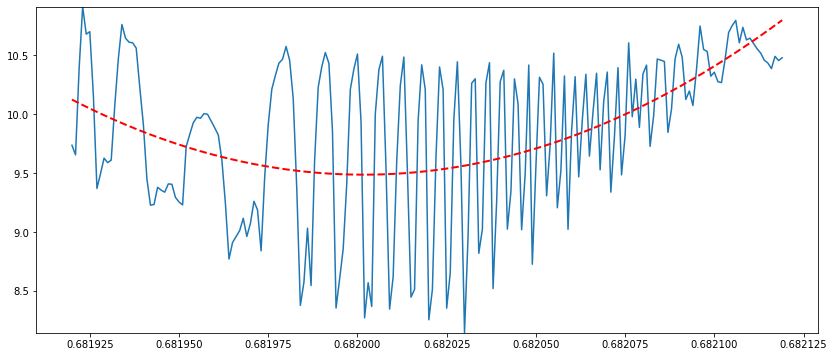

period: 0.6820840296245303
variance: -4.233789486849132e-10


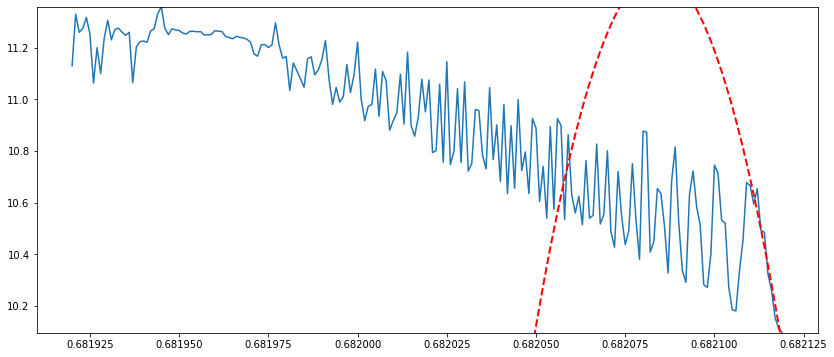

period: 0.6821206986221385
variance: 1.377504722534371e-10


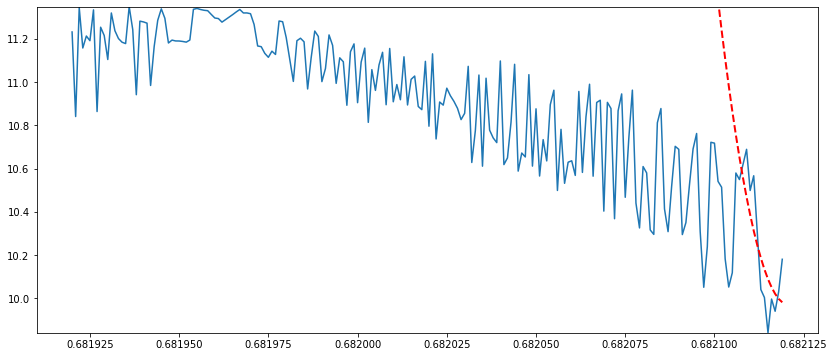

period: 0.6822447303123308
variance: 2.323732751547159e-08


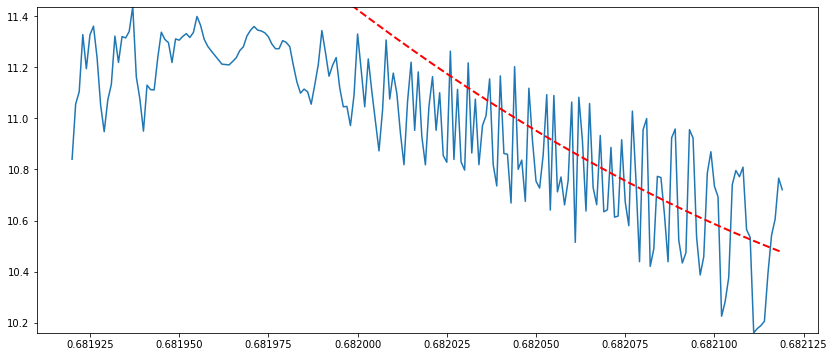

period: 0.6821036018265533
variance: 1.8050114253077787e-08


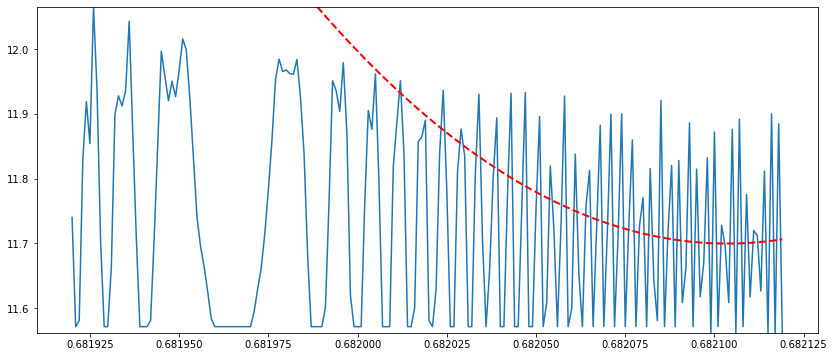

period: 0.682761408681122
variance: 1.4032958744012372e-07


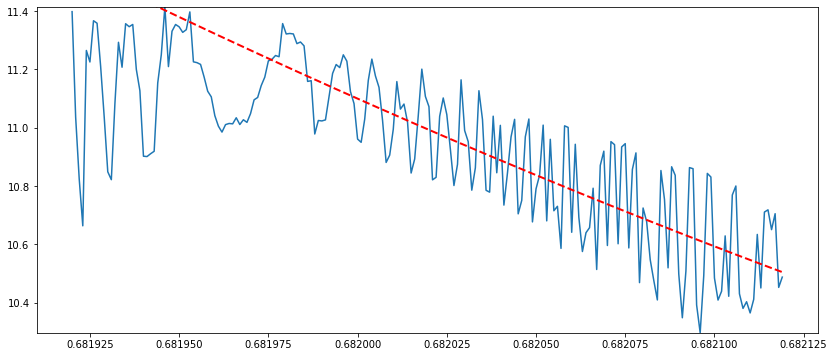

period: 0.6821077564468826
variance: 1.958810748563933e-09


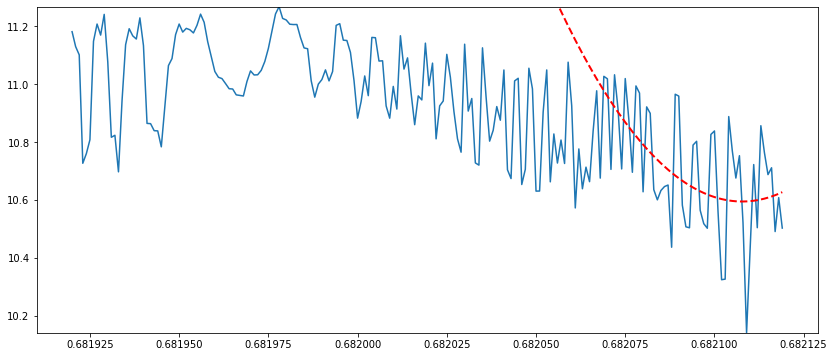

period: 0.6821836237152145
variance: 1.977675850909302e-08


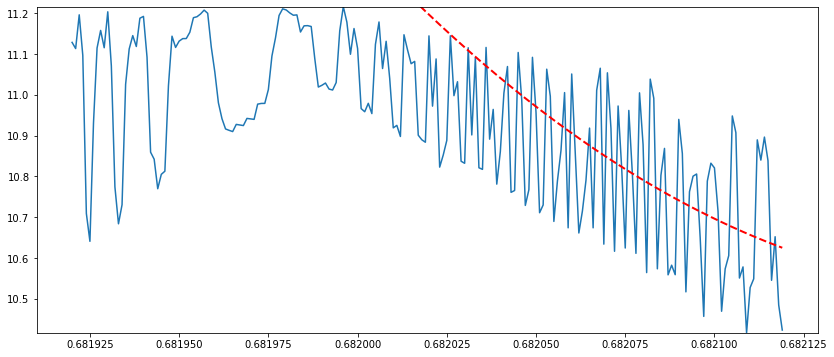

period: 0.6821130903455757
variance: -3.530525992396969e-11


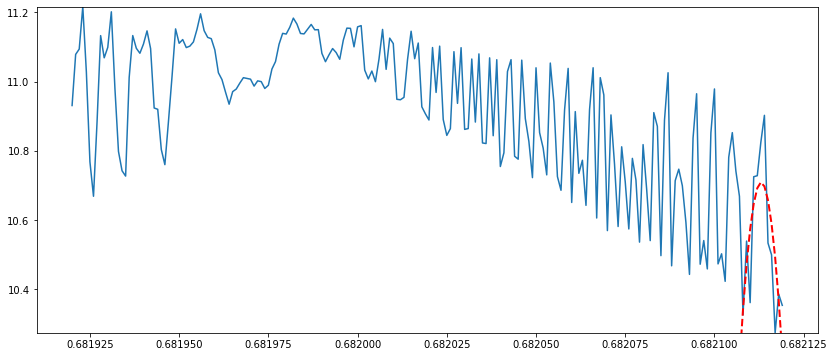

period: 0.6820228645041135
variance: 3.926296132922657e-09


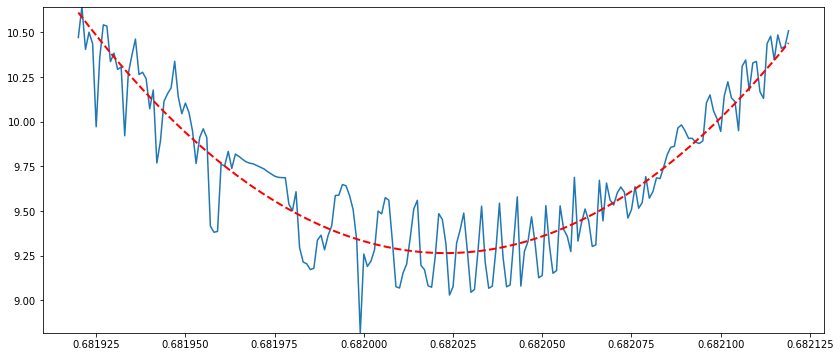

period: 0.6820460977665348
variance: 3.0239669605471766e-09


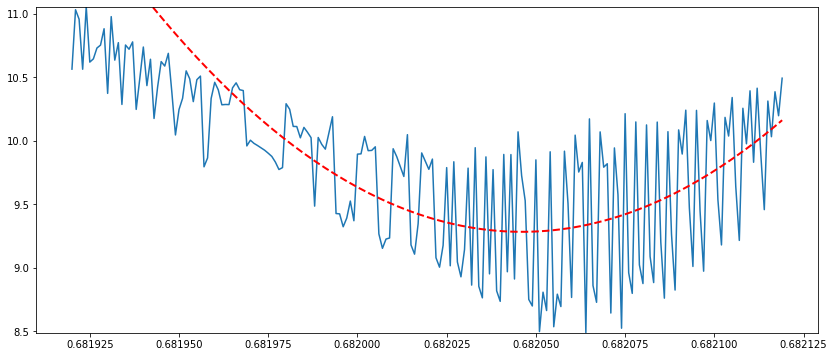

period: 0.6820152375132805
variance: 2.7131827576408303e-09


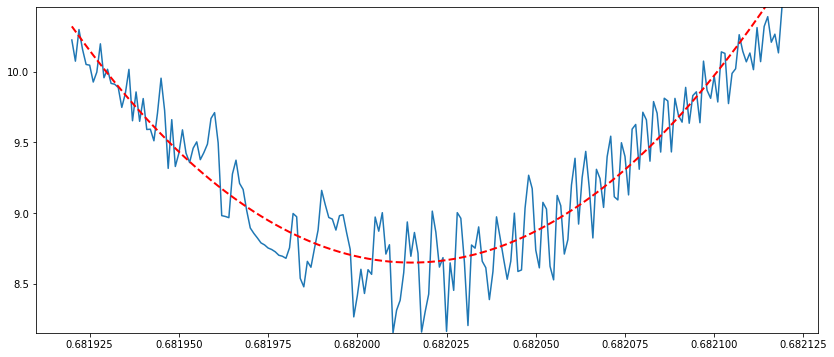

period: 0.681993159907098
variance: 6.601785634133541e-09


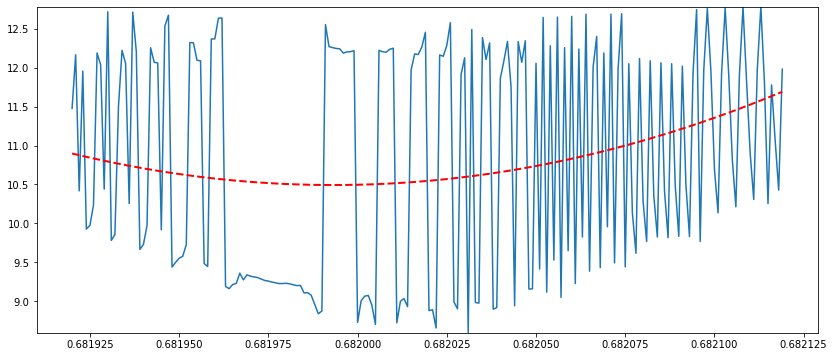

period: 0.6820271646238992
variance: 1.7376639092313387e-09


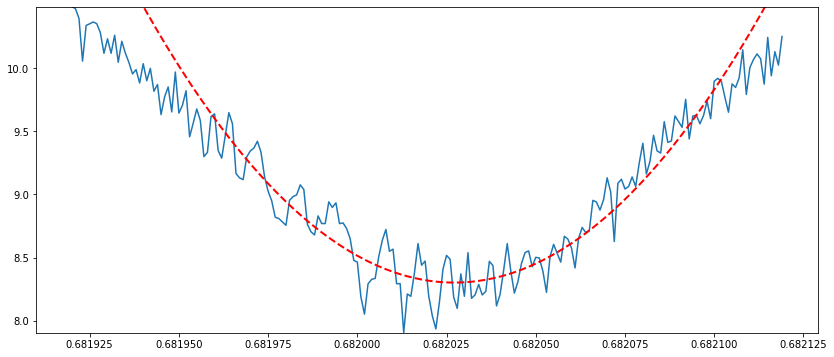

period: 0.6820269875224954
variance: 4.498494517077386e-09


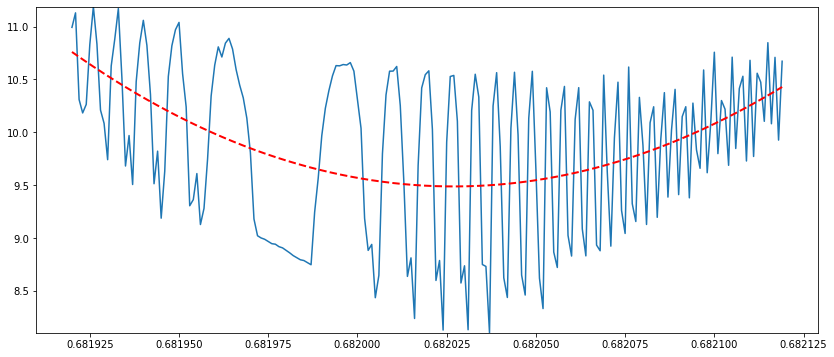

period: 0.6820236822970275
variance: 3.975448424487056e-09


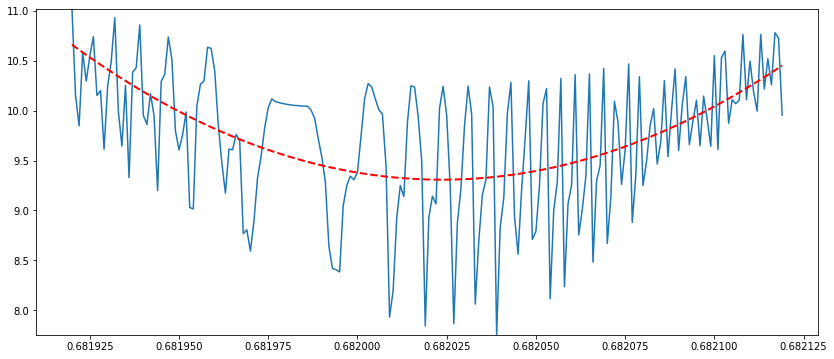

period: 0.6820221140118491
variance: 2.412436344598223e-09


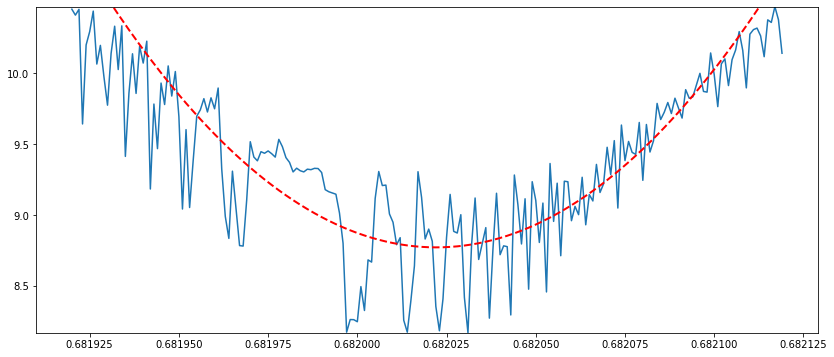

period: 0.6820174545294769
variance: 3.1954182537050172e-09


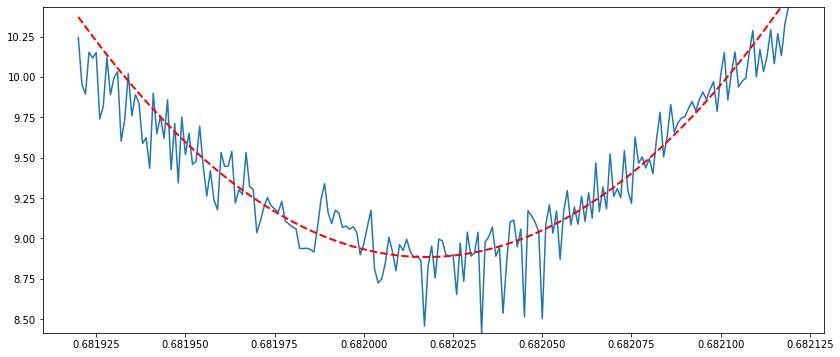

period: 0.6820146714502278
variance: 3.093265179760235e-09


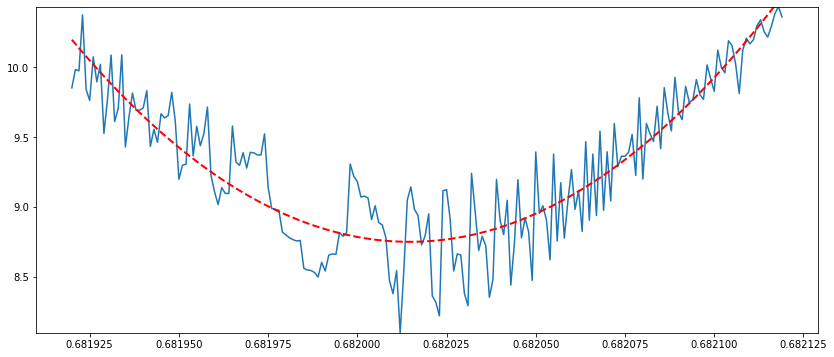

period: 0.6820349679708178
variance: 6.528151473319935e-09


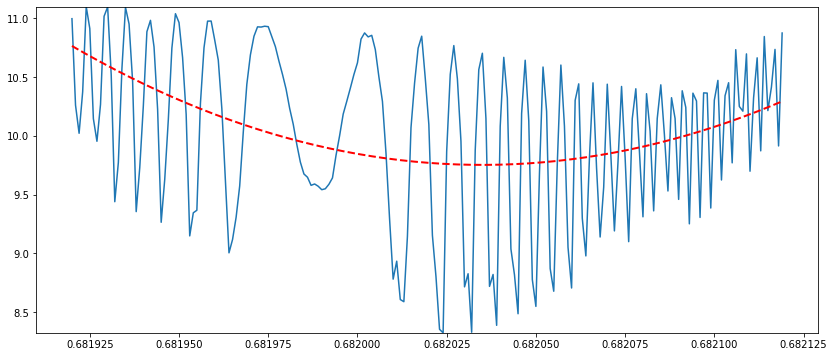

period: 0.682009959256907
variance: 4.138584574702198e-09


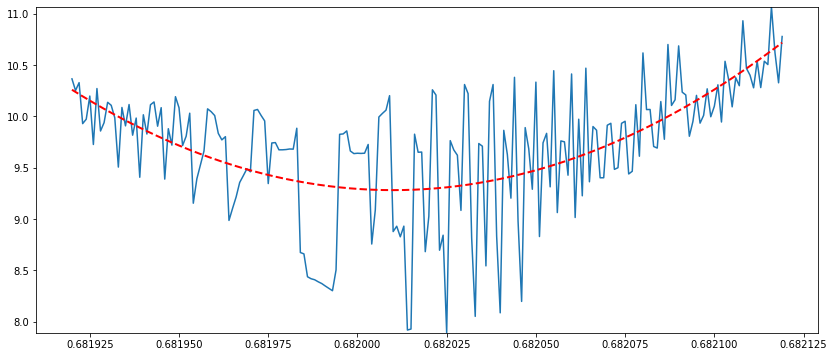

period: 0.6820308117826284
variance: 1.6300716998672705e-09


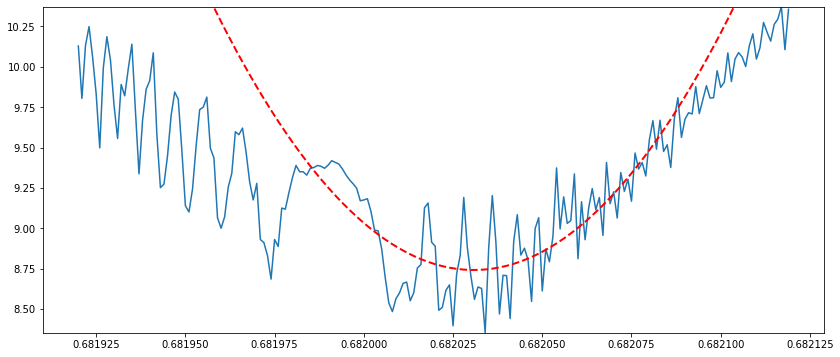

period: 0.6820298538432604
variance: 4.1369087798274694e-09


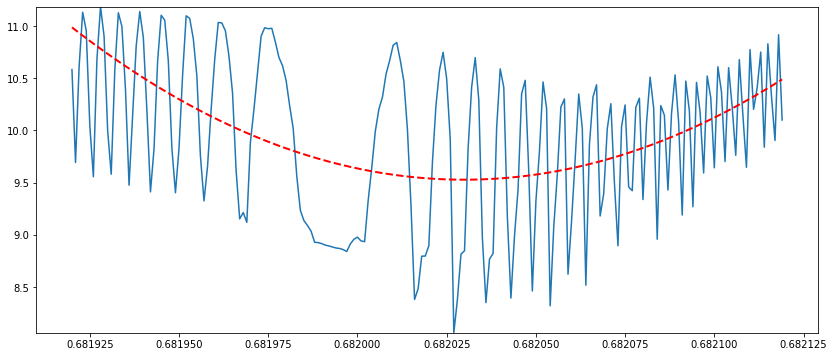

period: 0.6820071223873613
variance: 3.851994343362042e-11


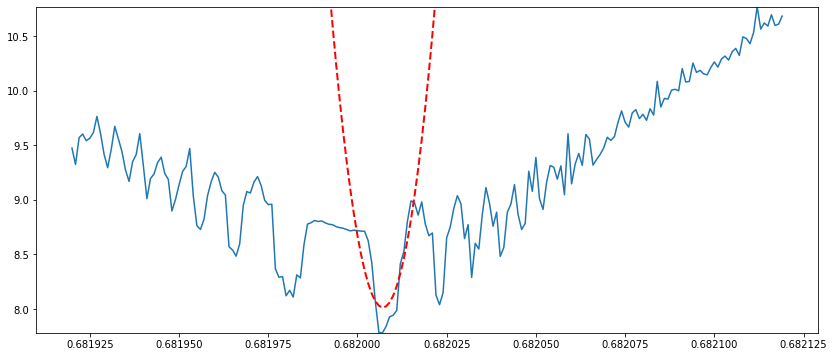

period: 0.6820110045927528
variance: 2.5051815497544427e-09


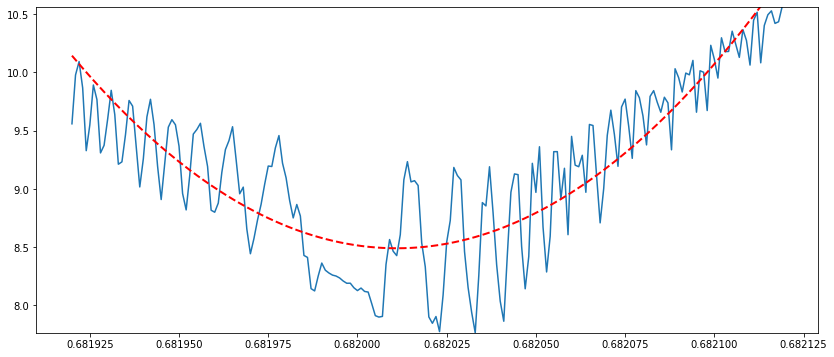

period: 0.6820054799686035
variance: 3.7363500868858565e-09


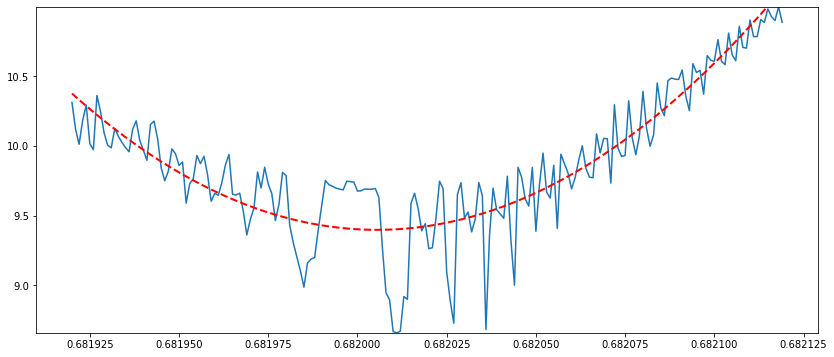

period: 0.6820209360761982
variance: 3.05006315252828e-09


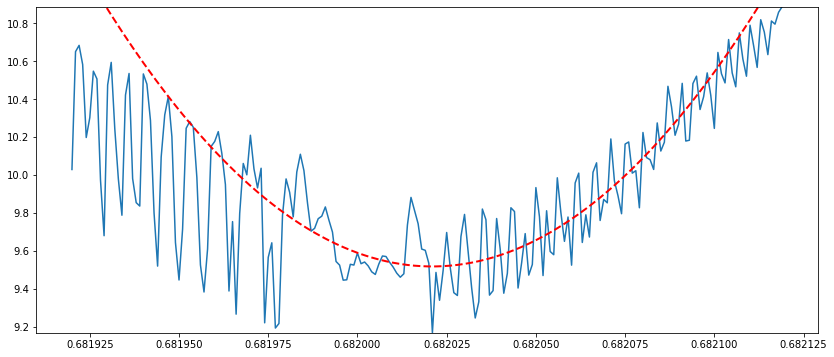

period: 0.6820413037853508
variance: 2.0865392046935604e-10


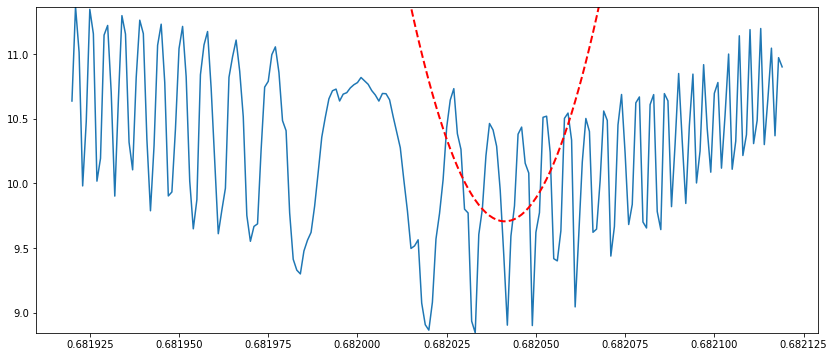

period: 0.6820413199076708
variance: 2.722556757121333e-09


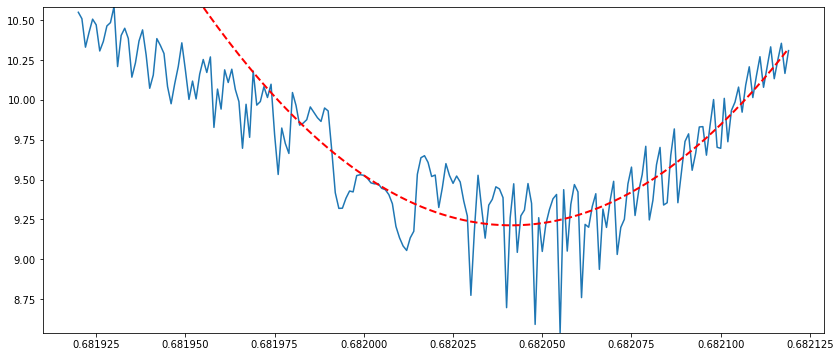

period: 0.6820212259455167
variance: 5.096681305408737e-10


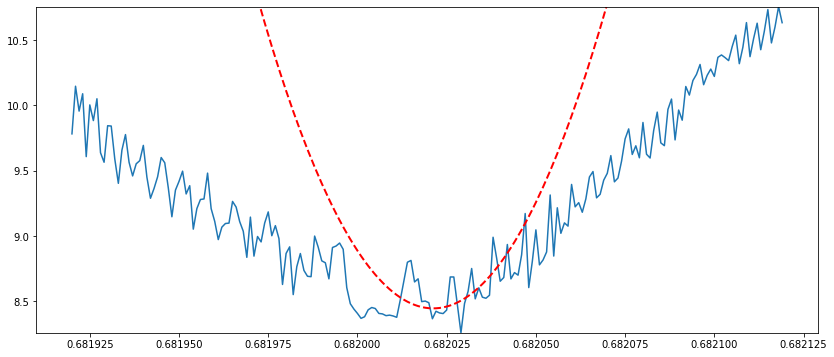

period: 0.6821015242111755
variance: 7.931015024101987e-09


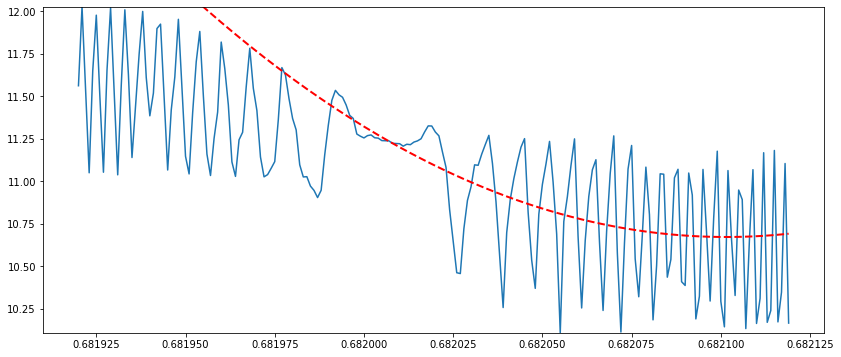

period: 0.6820657139922084
variance: 7.810221136207465e-09


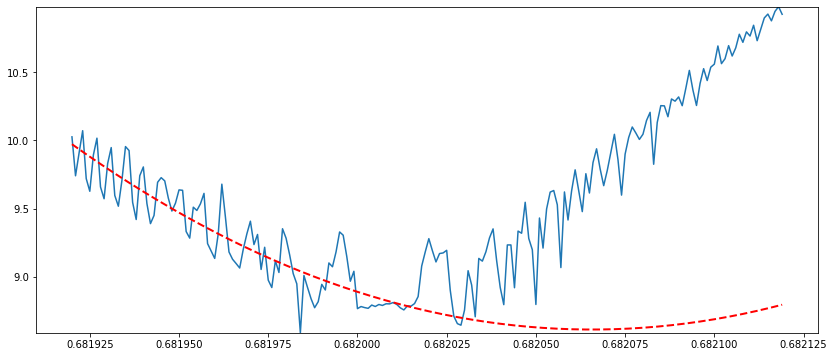

period: 0.6819927745892037
variance: 4.886650410012833e-11


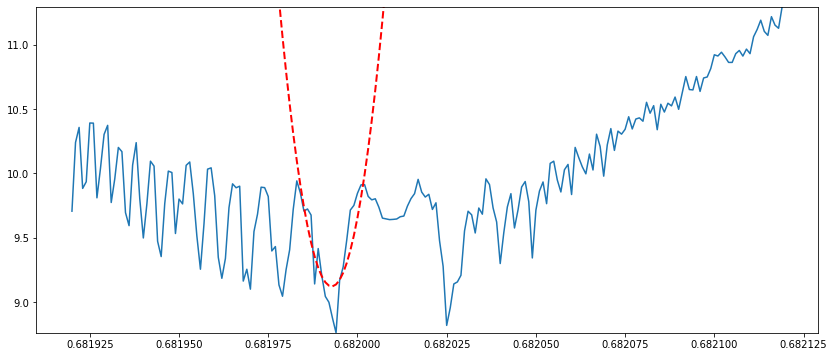

period: 0.6820401802356911
variance: 7.298562715920382e-09


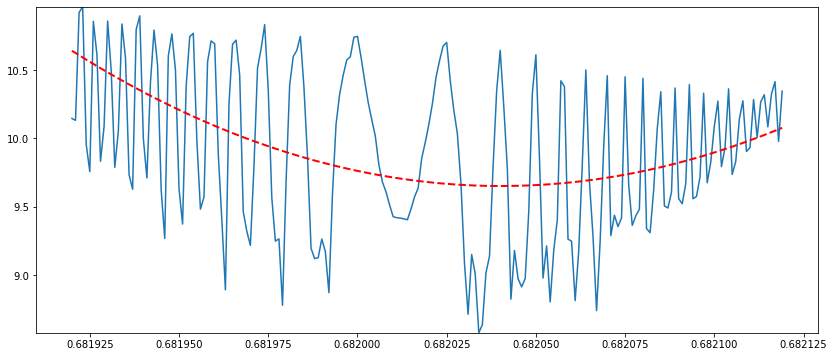

period: 0.6820653647045712
variance: 5.469937581244638e-09


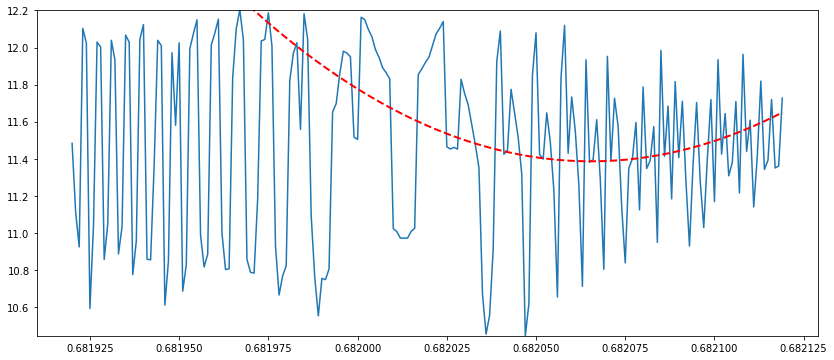

period: 0.6820572885736805
variance: 4.003440852655831e-09


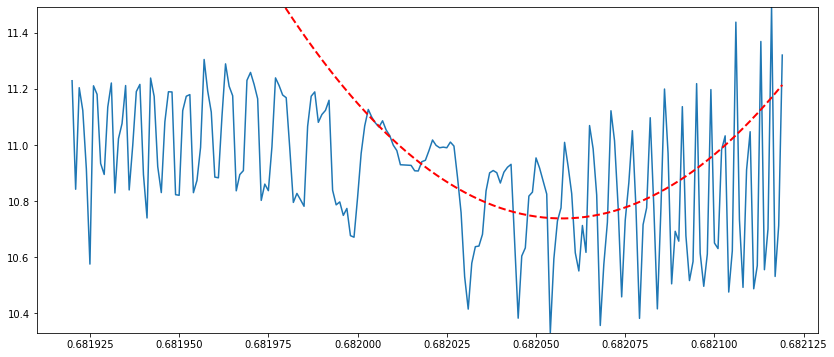

period: 0.6820725096553706
variance: 6.784534800872779e-09


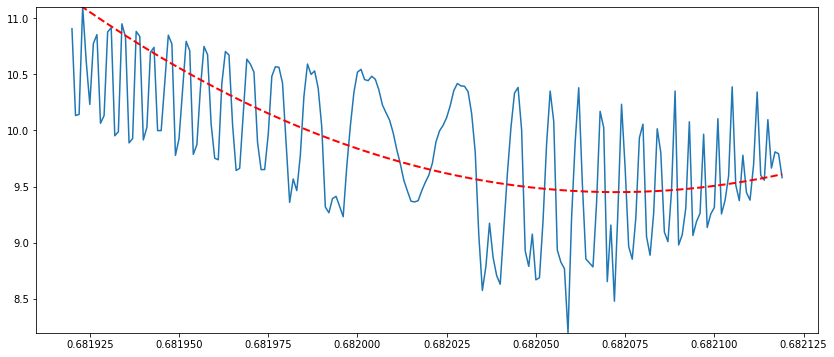

period: 0.6820403382381518
variance: 2.476442868966147e-11


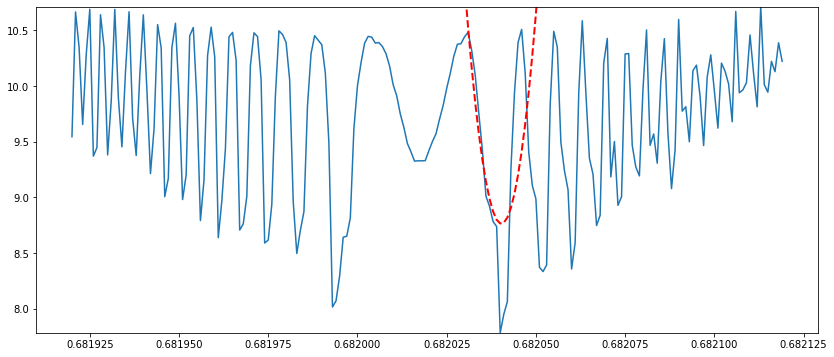

period: 0.6820893012318626
variance: 5.307625473906452e-09


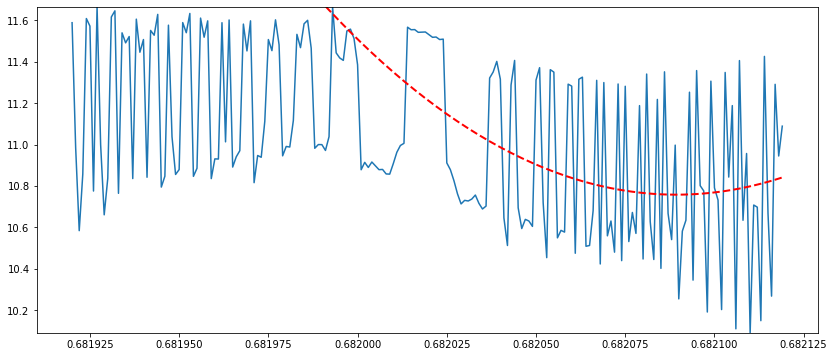

period: 0.681933908244712
variance: 1.4835512534636233e-09


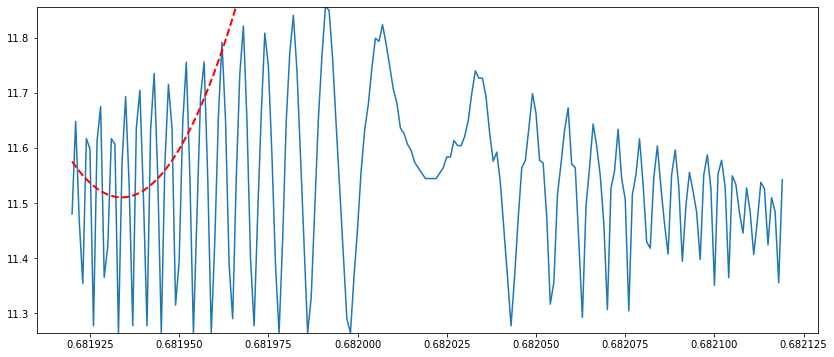

period: 0.6820393838775949
variance: 2.2836979325667443e-11


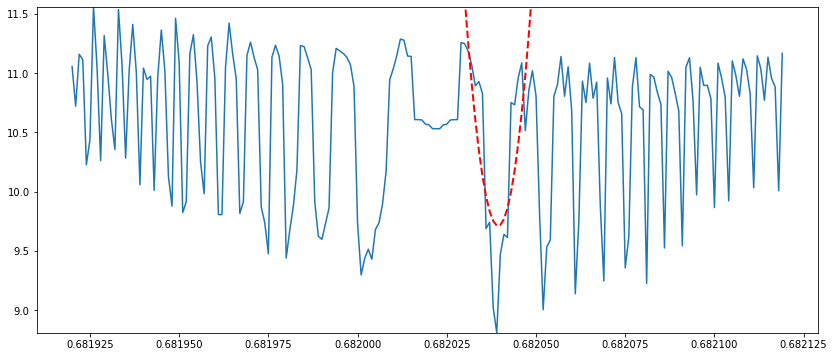

period: 0.6820031860645632
variance: 4.354461344503423e-11


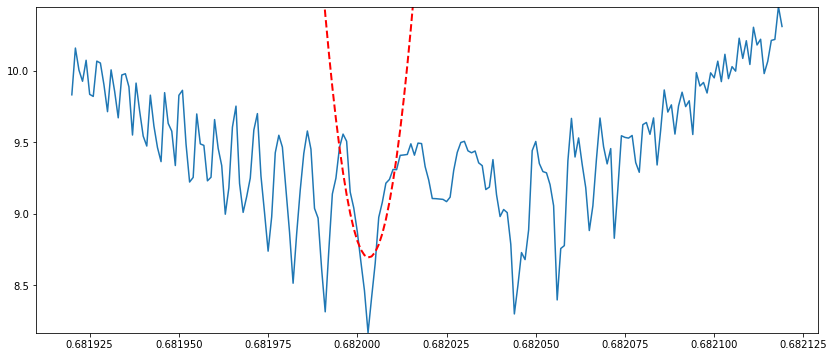

period: 0.6820378777997299
variance: 4.84074398206392e-11


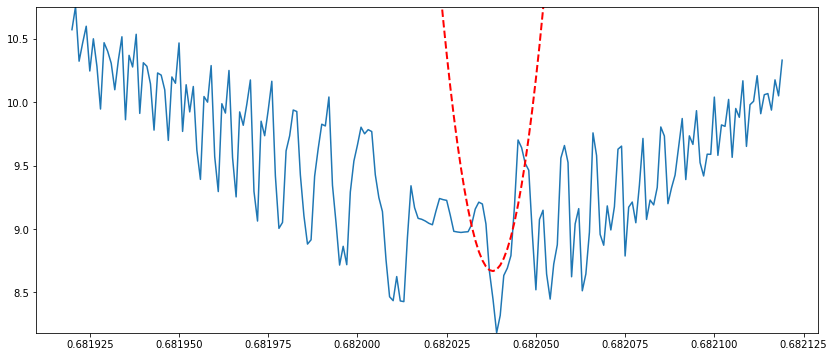

period: 0.6820706369035834
variance: 5.653424692940295e-09


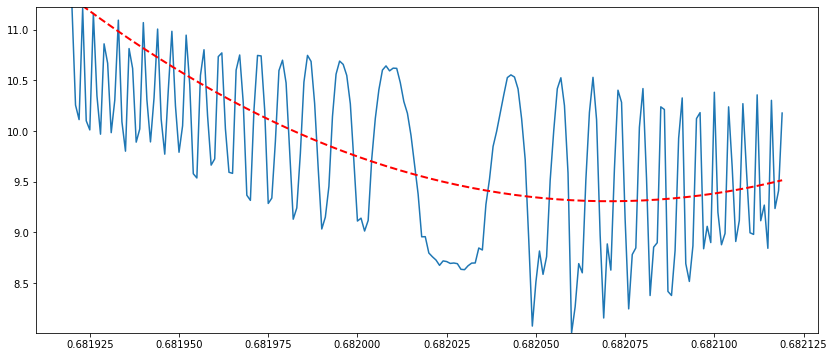

period: 0.6820270609151576
variance: 9.955096542548987e-11


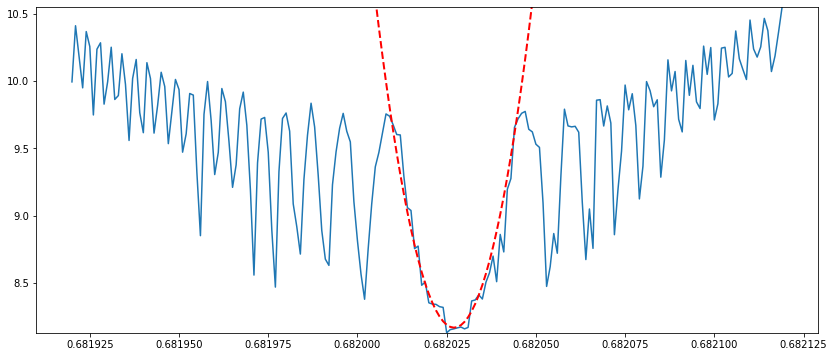

period: 0.6819923323405889
variance: 4.358900241464075e-09


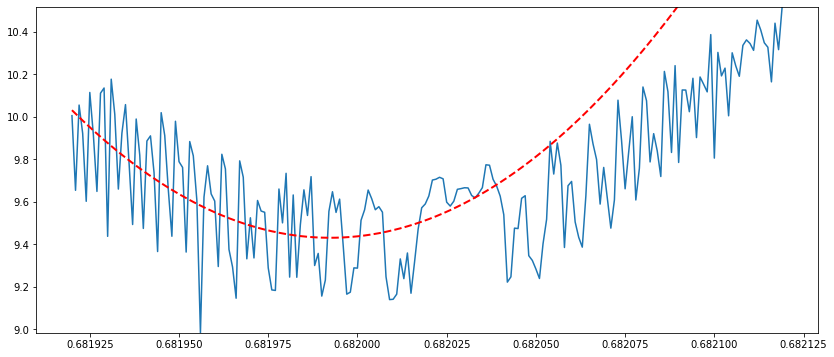

period: 0.682044959872207
variance: 2.803638174678037e-11


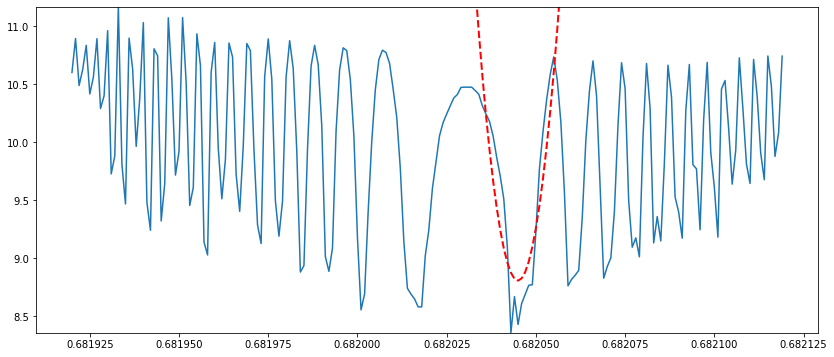

period: 0.6820500260697637
variance: 6.8319373102142e-11


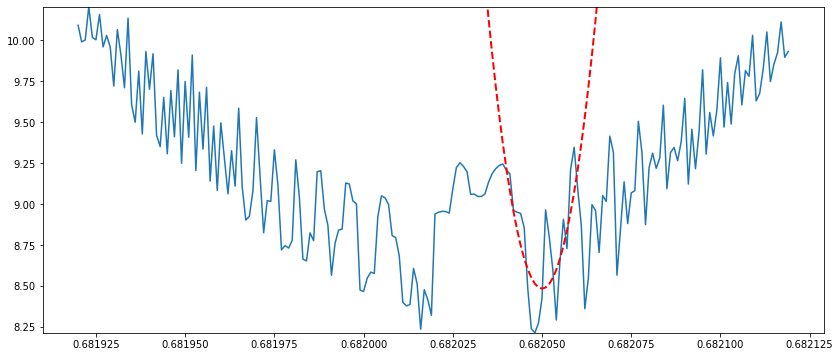

period: 0.6820219683921664
variance: 2.981751550878959e-11


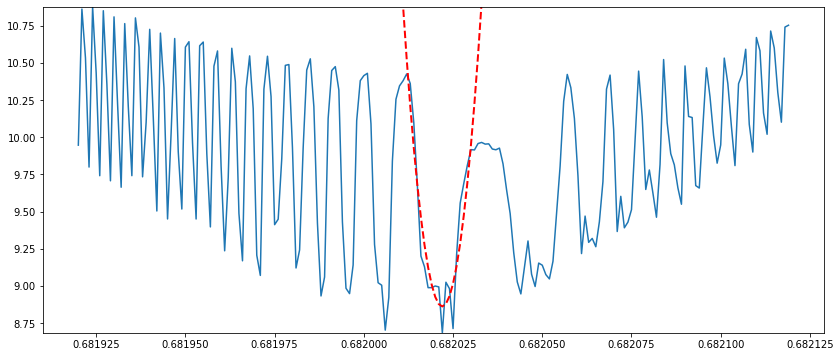

period: 0.6820156457317148
variance: 5.351435576845647e-09


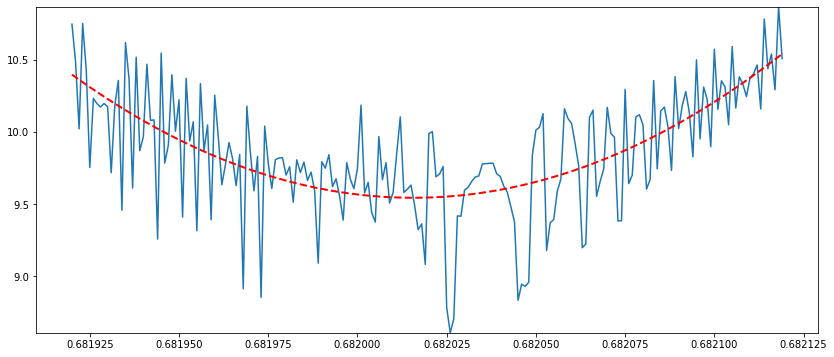

period: 0.6819461176397442
variance: 4.4528222635742093e-10


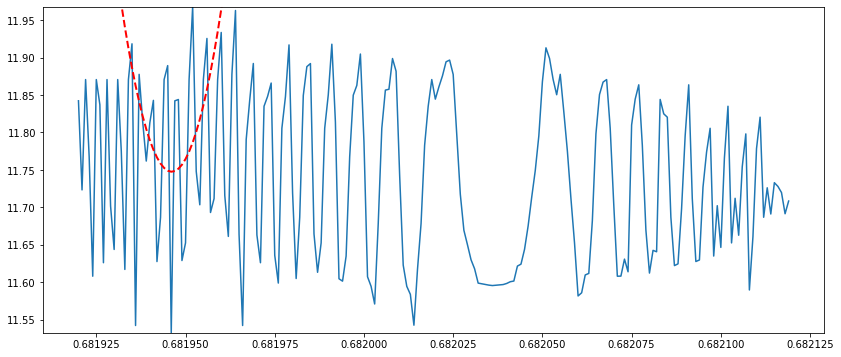

period: 0.6820042770632823
variance: 1.4339123507638326e-08


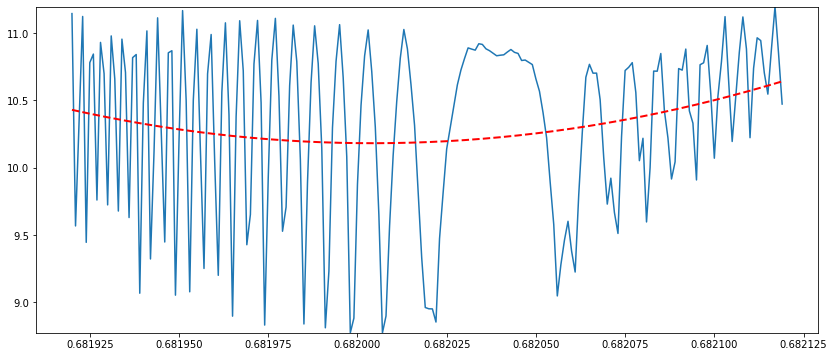

period: 0.6820445300860712
variance: 2.373418698751753e-10


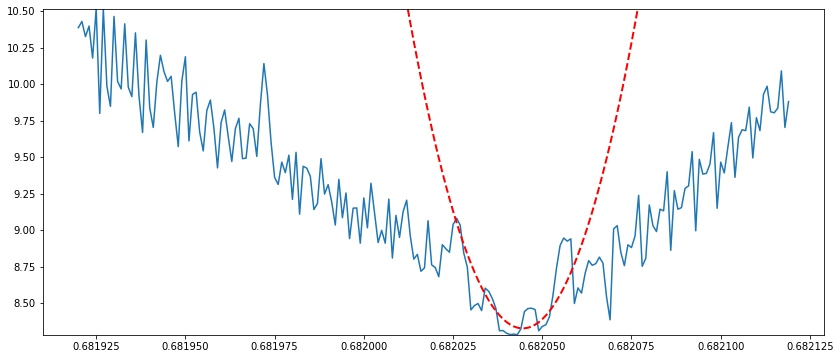

period: 0.6820047963569591
variance: 2.3891110515355357e-09


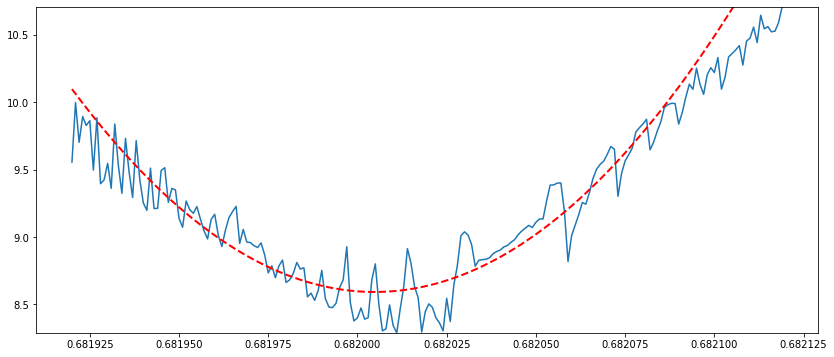

period: 0.6820537948631364
variance: 2.375865677666444e-10


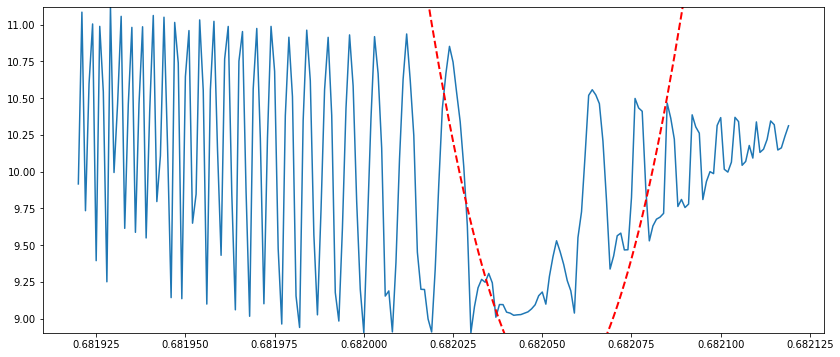

period: 0.6820374856779129
variance: 2.453983017670936e-09


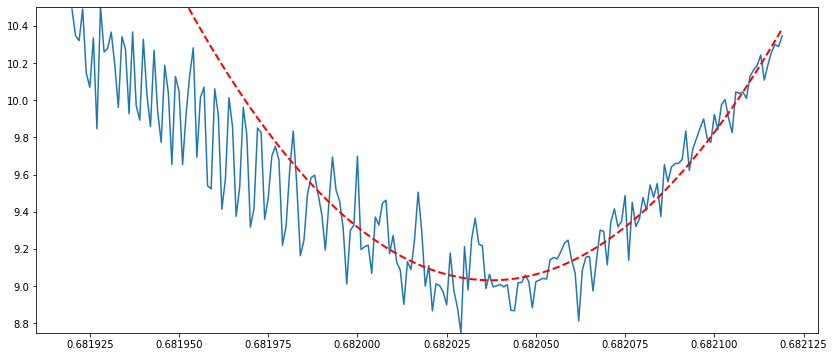

period: 0.6820229247926926
variance: 5.785612709227961e-11


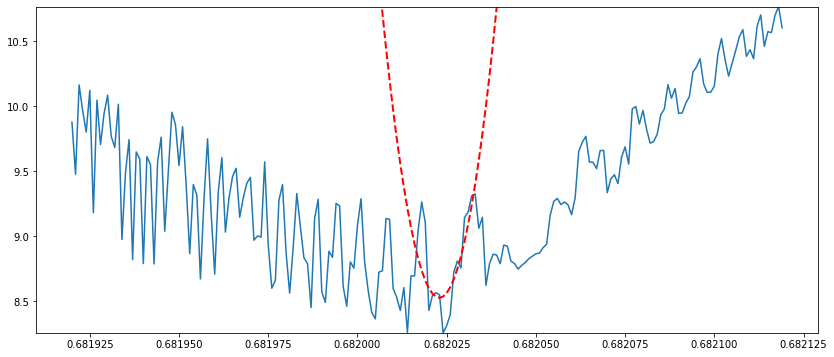

period: 0.682016700685894
variance: 3.2194104588038167e-09


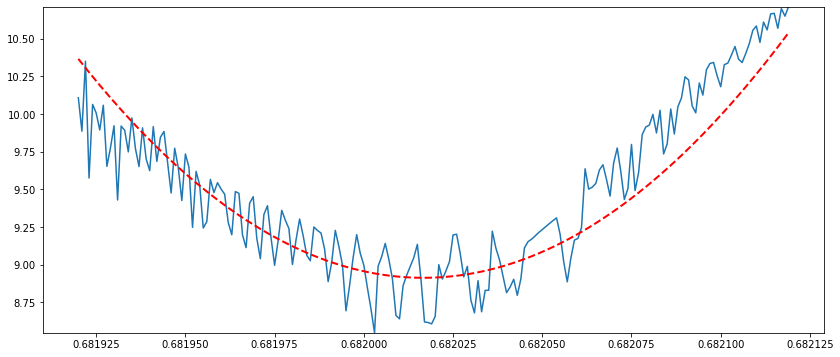

period: 0.6820119478538816
variance: 3.267756619678193e-09


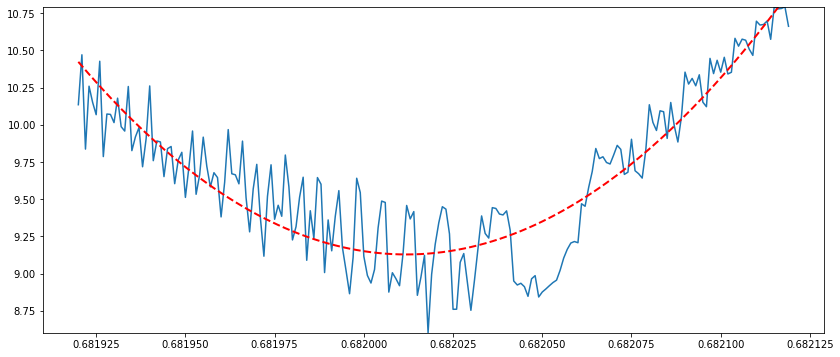

period: 0.6820279183210419
variance: 4.4240894988329826e-11


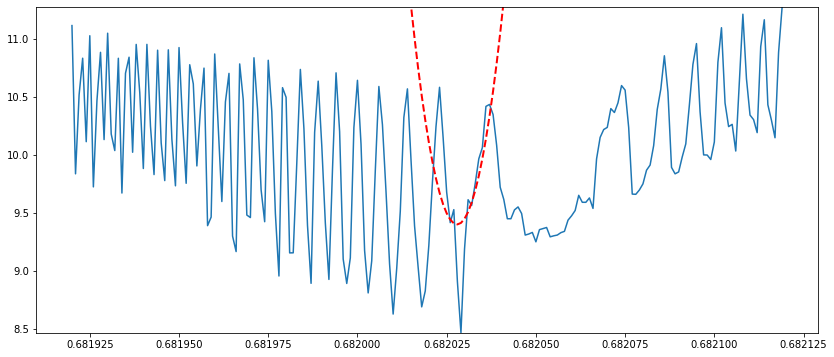

period: 0.6821056212676311
variance: -1.11332162215926e-09


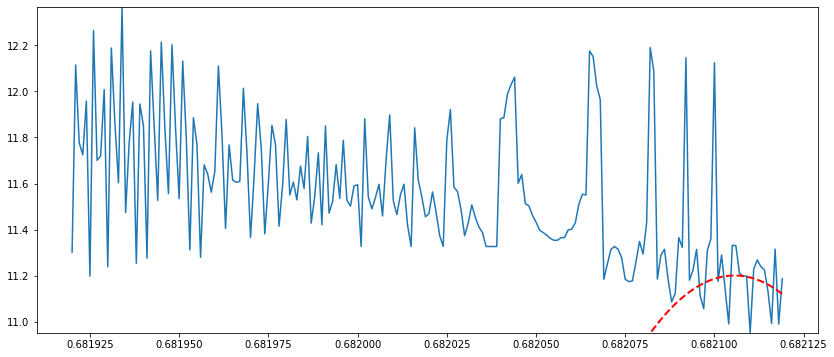

period: 0.6820275070812287
variance: 1.299878037453061e-09


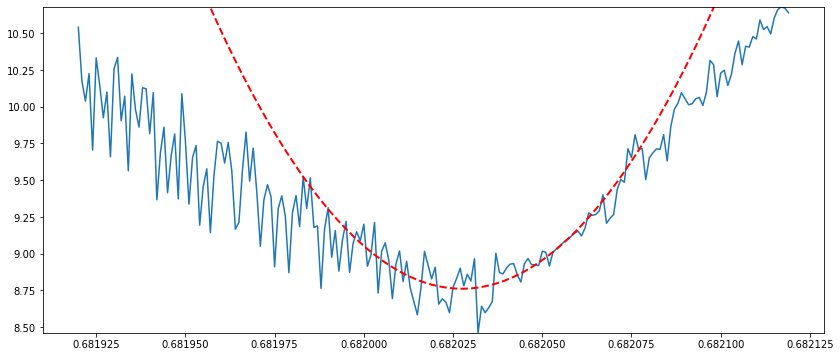

period: 0.6820061307900429
variance: 3.6111306718953272e-09


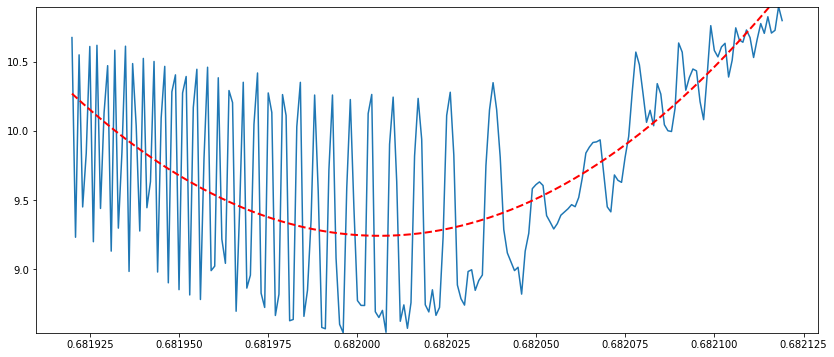

period: 0.682037329663096
variance: 6.191744410637155e-11


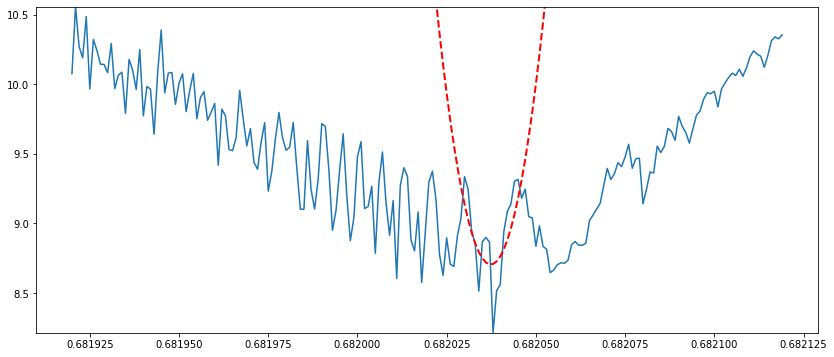

period: 0.6820157713329409
variance: 4.417783065002284e-09


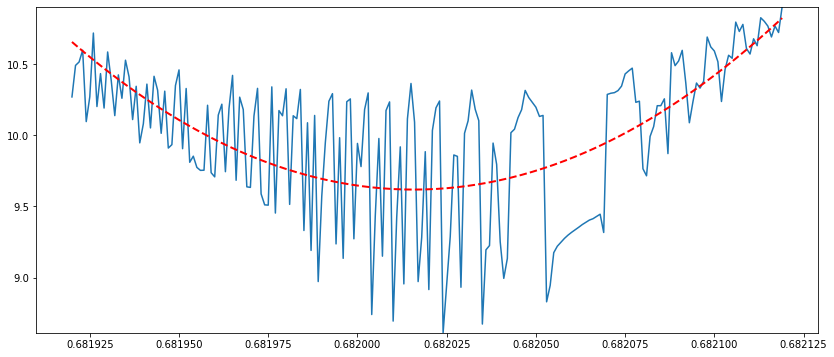

period: 0.68193776160707
variance: 4.886523237930043e-07


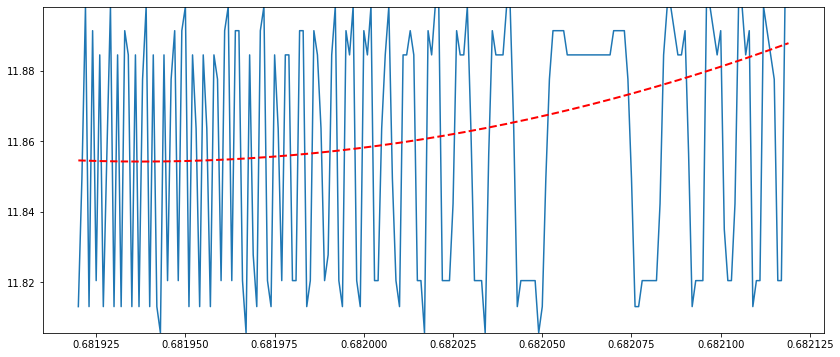

period: 0.6819327353627164
variance: 1.2702473952158432e-09


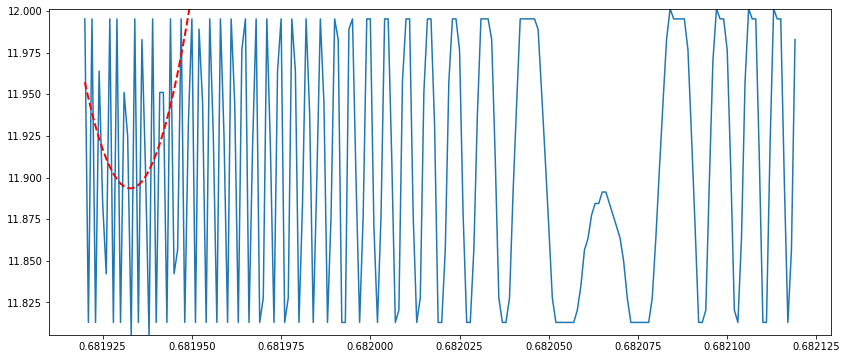

period: 0.6820262564695417
variance: 3.6518188696868977e-09


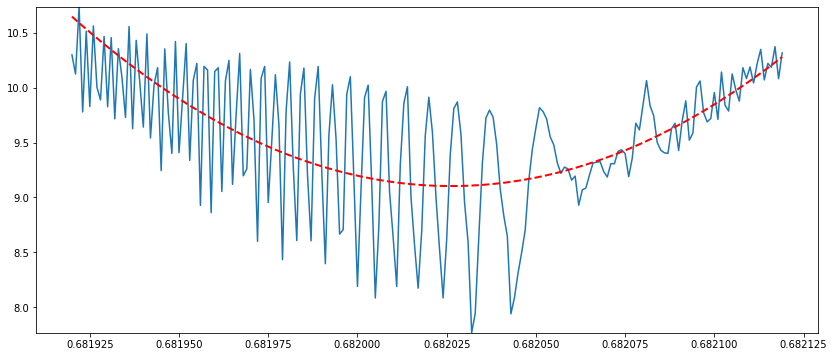

period: 0.682043839423418
variance: 4.32772978932873e-09


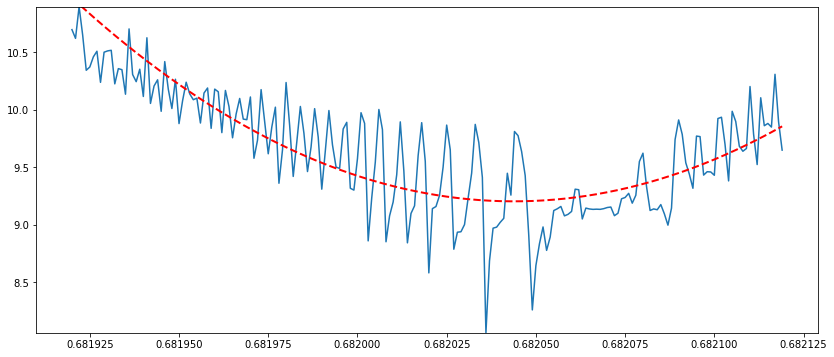

period: 0.6820191588389187
variance: 1.0000910746424803e-08


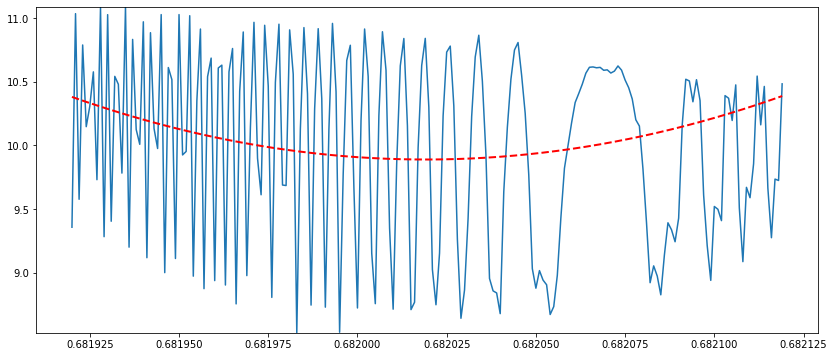

period: 0.6820207368063396
variance: 6.6230852718443145e-09


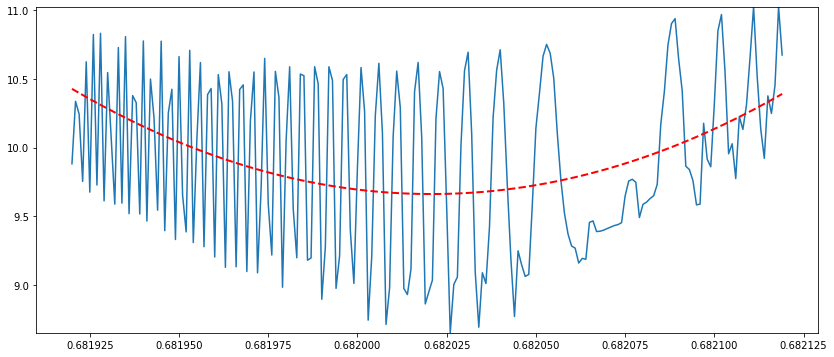

period: 0.6820290782283555
variance: 3.7057657521544866e-09


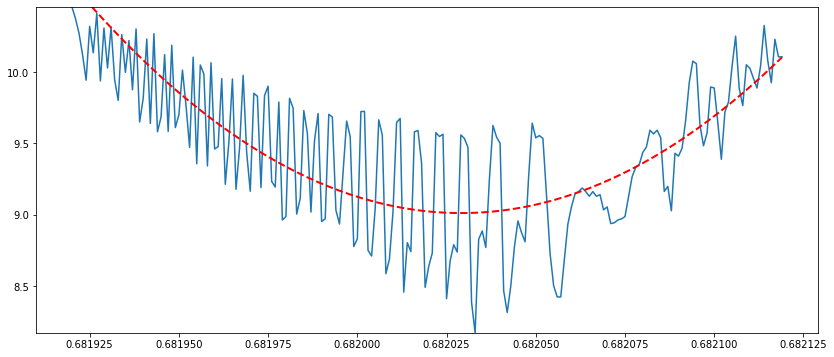

period: 0.682018989043534
variance: 4.040885763142552e-09


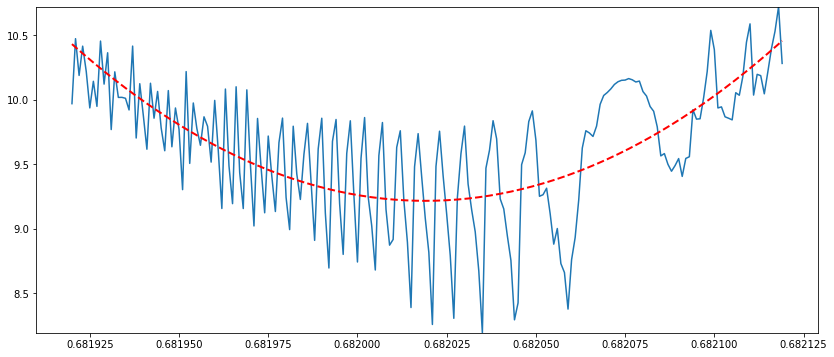

period: 0.6820316879149783
variance: 8.364079124339455e-10


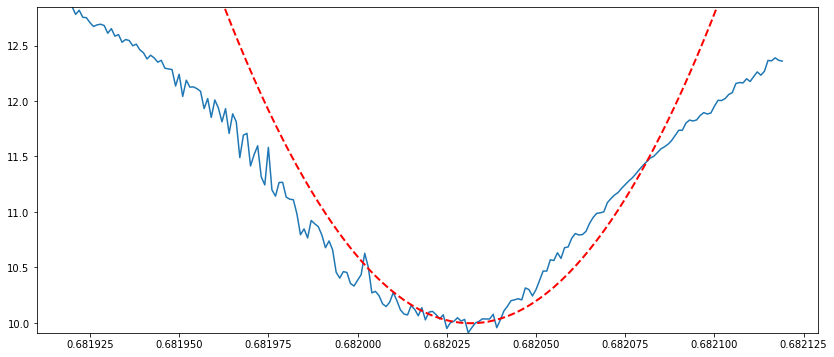

In [196]:
#plot likelihood surfaces
fit_periods = []
variances = []

for key in data.keys():
    fig = plt.figure(figsize=(14, 6))
    plt.plot(times, np.log(all_like_list[key]))

    min_indx = np.argmin(all_like_list[key])
    #indx = (np.abs(times - times[min_indx]) < 0.00001)
    pf = 0
    best_resid = np.nan
    
    #try fitting to a variety of scales
    #in order to try to find the actual best fitting parabola to the LS
    for indx in [np.abs(times - times[min_indx]) < tol for tol in np.linspace(10*scan_width, scan_width*scan_n, 5)]:
        polyf = polyfit(np.array(times)[indx], np.log(np.array(all_like_list)[key][indx]), 2, full=True)
        resid = polyf[1][0]/len(indx[indx]) #residual per datapoint
        if polyf[0][0] < 0:
            resid = 1e10
        if resid < best_resid or np.isnan(best_resid):
            best_resid = resid
            pf = polyf[0]
    plt.plot(times, pf[0]*times**2 + pf[1]*times + pf[2], c='r', lw=2, ls='--')
    
    fit_period = -pf[1]/(2*pf[0])
    variance = 1/(2*pf[0])
    
    fit_periods.append(fit_period)
    variances.append(variance)
    
    print('period:', fit_period)
    print('variance:', variance)
    
    plt.ylim(np.min(np.log(np.array(all_like_list)[key])),
             np.max(np.log(np.array(all_like_list)[key])))
    
    plt.show()
    
fit_periods = np.array(fit_periods)
variances = np.array(variances)

[ 3625.24676503   107.40462299 -1747.77690687]
[ 2457.63842453 -1223.46693537  -296.91941971]
[ 1.44910810e+08 -1.97663409e+08  6.74049616e+07]
[ 1.85084812e+08 -2.52463914e+08  8.60930136e+07]
[ 1.48953553e+08 -2.03179718e+08  6.92867068e+07]
period: 0.682023734921313
variance: 0.009255465525712091


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


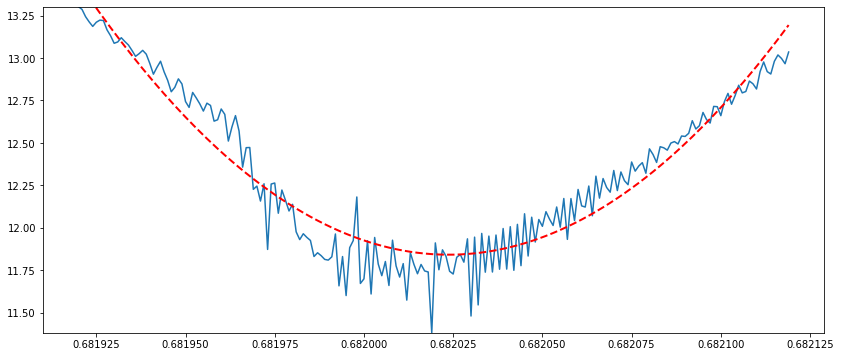

[ -1966.04910615 -14014.65400413  10483.28557198]
[ 49323.30849347 -41903.00180614   5646.82662213]
[  272.25386352 12923.21505658 -8929.6578345 ]
[ 2645.1481225   4435.71889541 -4244.65375232]
[ 45164575.3485176  -61599968.84222525  21004061.63784306]
period: -0.8384632334327217
variance: nan


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


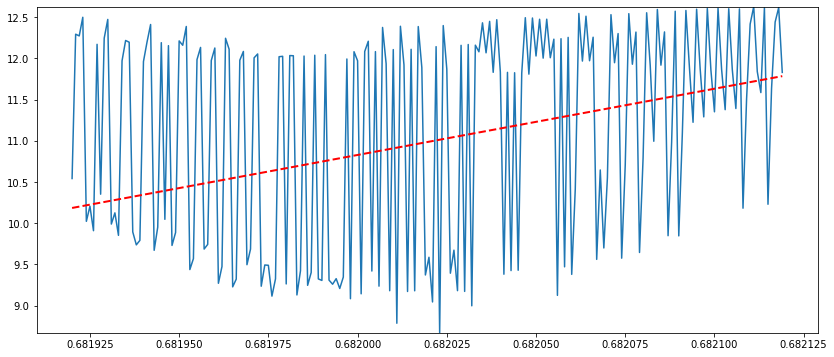

[ 720.36650869  356.24871583 -567.46181575]
[-333.72003666 -616.06451074  586.14350289]
[  -10.06861421 -1329.1799919    922.00073953]
[   71.83390216 -2665.87385222  1795.63280923]
[  372.71870442 -3549.65160629  2258.45594019]
period: 4.761837230368347
variance: 15800.691186244017


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


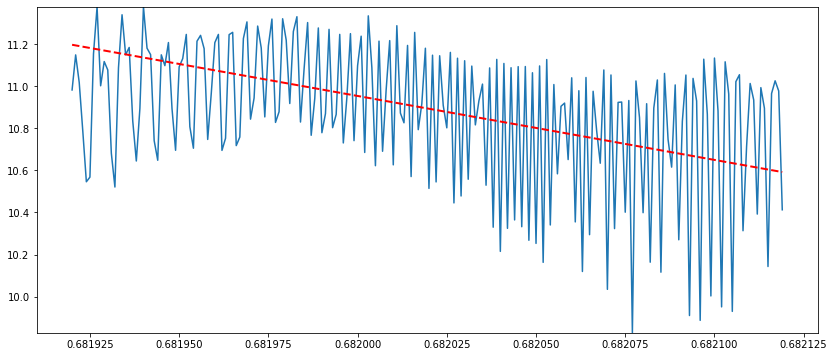

[-6050.2939196   -382.53543976  3084.13048875]
[-1824.76389886  1179.6197639     53.30711597]
[  8140.880098   -12800.94623573   4952.86371358]
[ 1.13631122e+08 -1.54998140e+08  5.28561790e+07]
[ -25.61857188 -765.45028485  543.34244055]
period: -0.03161296334089929
variance: 14142135623.730951


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


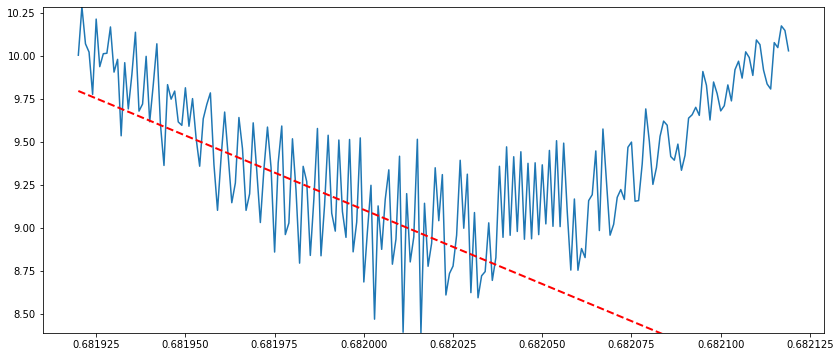

[11941.55437688 -4329.62918145 -2593.2338931 ]
[ 4281.68339478 -2721.68540343  -126.62796226]
[ 11377.46294583 -12385.19582045   3163.58824761]
[ 1.51084033e+08 -2.06085497e+08  7.02775079e+07]
[ 1.46649815e+08 -2.00036787e+08  6.82147491e+07]
period: 0.6820219558498475
variance: 0.019772941857680408


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


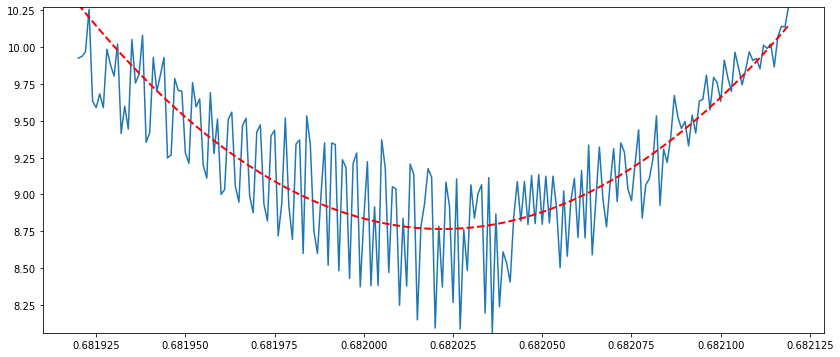

[-40355.62209455  18583.33241216   6106.9304512 ]
[-2624.1960485   1274.78454476   360.71916377]
[-2375.55851021  1232.45503505   273.96361882]
[ 1252.09430713 -3034.70280182  1496.91711849]
[ 56948162.84309055 -77681555.12476936  26490872.8517151 ]
period: 1.2118507306300426
variance: inf


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


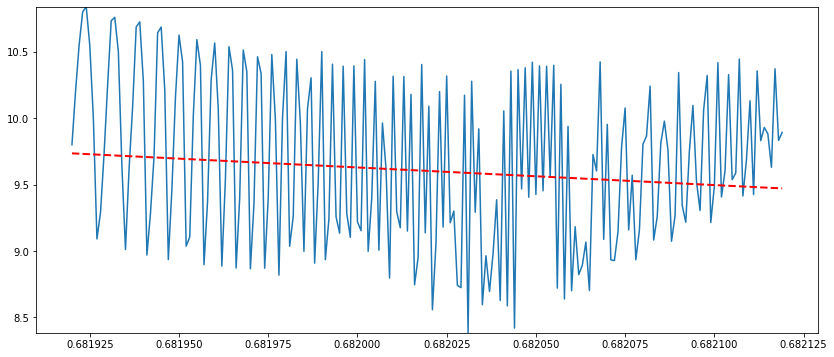

/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


[-2784.21342262   827.10902324   741.74857688]
[ 376.39904161  704.59372217 -644.6756734 ]
[ 3032.45729854 -6129.51351855  2780.74743771]
[-389.97516344 -729.00813669  689.49441141]
[ 5313.41606699 -8266.58664919  3177.34606526]
period: -0.9359664136709887
variance: inf


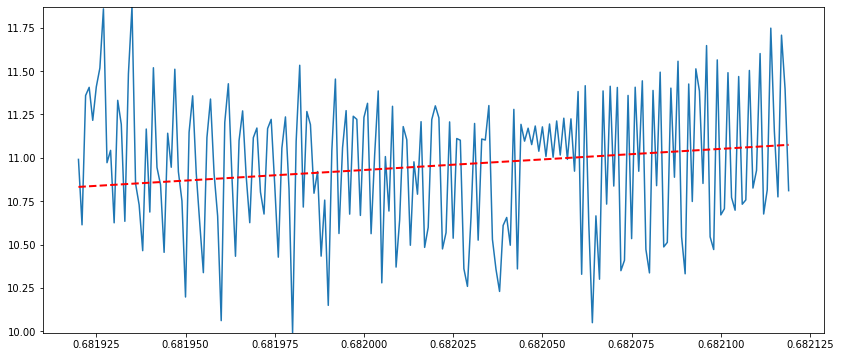

[ 8168.88185325 -2007.46920178 -2421.7521333 ]
[ 16650.35452    -15943.73367906   3137.97977545]
[ 9012.66208025 -7499.00399285   931.3155382 ]
[ 8.59385241e+07 -1.17219702e+08  3.99717754e+07]
[ 1.22302575e+08 -1.66822261e+08  5.68869280e+07]
period: 0.12287294869972461
variance: nan


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


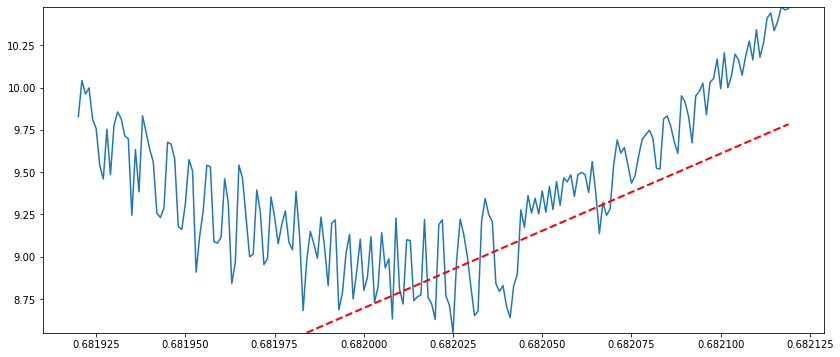

[  5118.19853729 -54969.96166192  35118.46961458]
[ -781.62974773 -1306.05646377  1264.10838154]
[-222.40894681   25.8137836    95.77852723]
[ 4465.84683239 -4365.40126936   910.04175896]
[ 488629.6512069  -663073.68117823  224952.9259704 ]
period: 0.6785033199893385
variance: 17.598727537645974


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


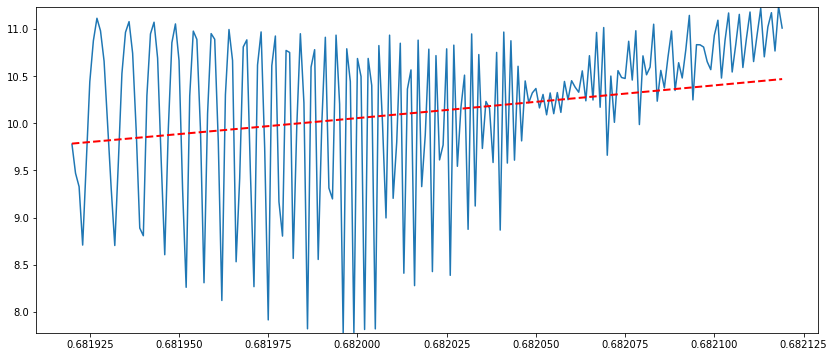

[ 19286.15290679 -12953.87947463   -127.55407236]
[ 349.14310219  634.92260197 -586.48418736]
[ 3615.07118895 -3355.58080141   616.08652961]
[ 1.51627099e+08 -2.06828832e+08  7.05318699e+07]
[ 1.43491034e+08 -1.95730037e+08  6.67467708e+07]
period: 0.33583368174130285
variance: nan


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


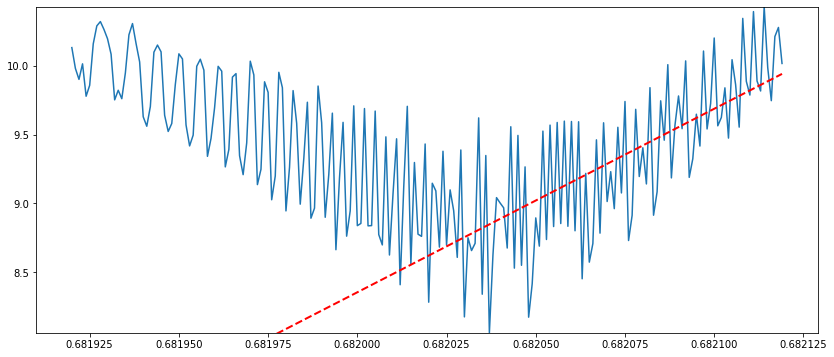

[ 61881.96293758 -49957.39909233   5295.73326473]
[-2856.7155346   -106.16606131  1410.63325901]
[  614.86216878 -4022.41754654  2466.86966359]
[ 2986.69959835 -6897.71492081  3324.71509718]
[ 562983.74893487 -772821.08360542  265216.52106762]
period: 0.4036507305264189
variance: nan


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


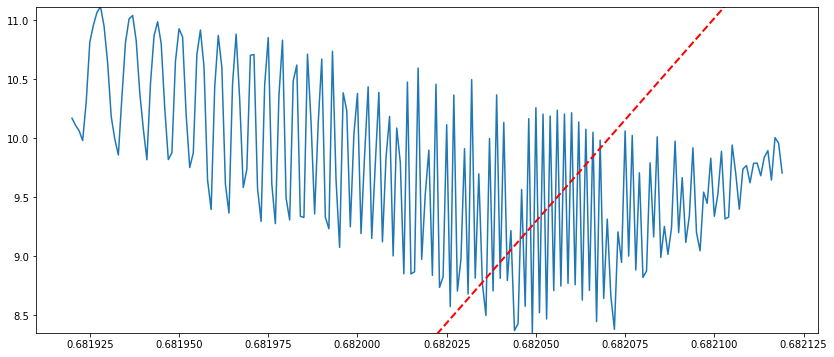

[  7312.37441333   9694.41689078 -10003.27760233]
[ 2825.51389072 -2611.18248714   476.49851025]
[ 235.86547045 -107.00178723  -26.75497352]
[  98561.70956666 -132502.42717284   44533.28389321]
[ 1.00427714e+08 -1.36984461e+08  4.67120719e+07]
period: -0.6628774966107146
variance: nan


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


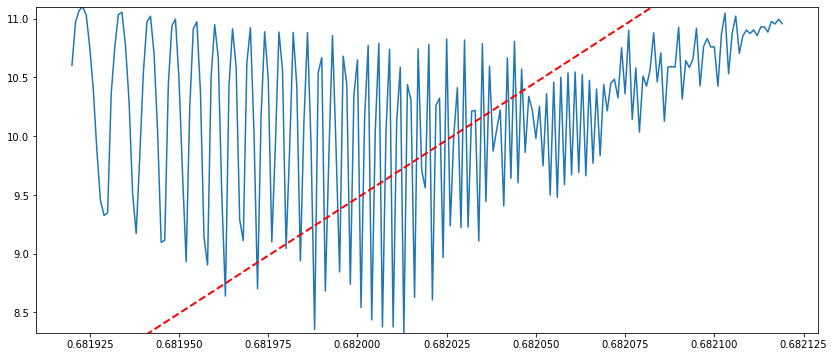

[-2731.6010144  -1212.74474176  2106.8604789 ]
[  620.66798727 -3260.59051032  1944.24849073]
[ 2008.521752   -4294.59797324  2003.98863137]
[ 187392.13091136 -255706.90407007   87240.91764597]
[ 1.23832440e+08 -1.68914878e+08  5.76025157e+07]
period: 0.6822775930517444
variance: nan


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


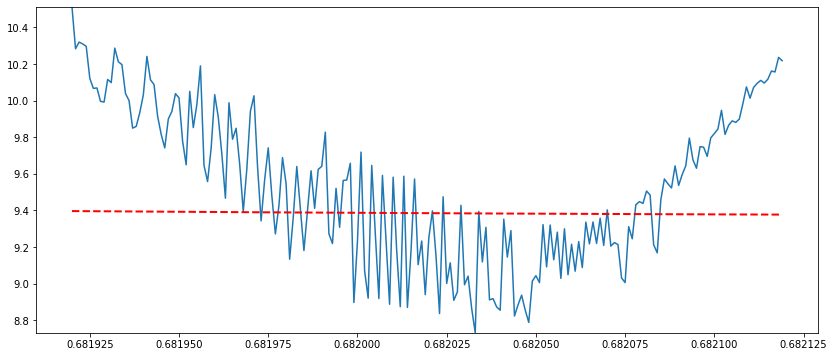

[-1763.41849125 -2693.12452882  2666.66827718]
[ 1971.00203915 -7259.83585502  4044.2367193 ]
[ 2287.28423528 -7199.62890582  3856.25738012]
[  531.67409481 -1954.17294124  1095.36228571]
[  761679.77252541 -1041938.22084119   356336.35102341]
period: 1.5738378280143694
variance: nan


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


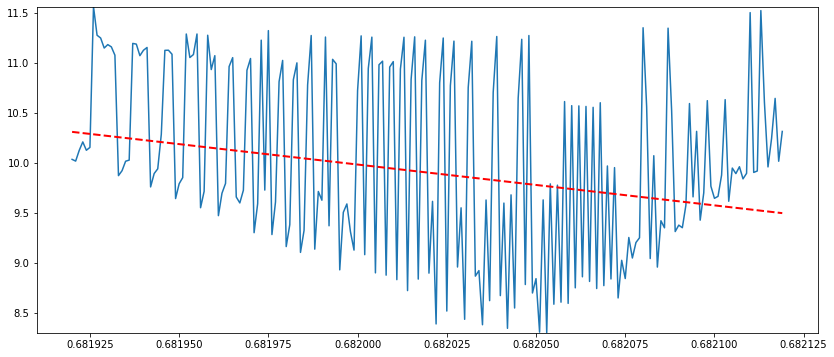

[-5411.3193333    639.7629258   2091.21595534]
[-4926.27149443  3532.71015405  -107.38210581]
[  437.64541983 -3567.07991211  2239.8439725 ]
[  896.29103992 -3738.5630023   2143.52634604]
[ 46250261.06082824 -63088969.37265692  21514581.3113983 ]
period: 2.085574236368043
variance: nan


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


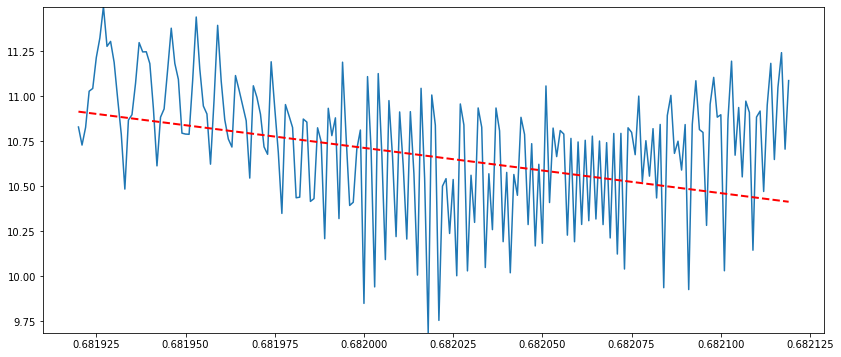

[-4807.41169216  2193.43213181   749.07043034]
[  648.26364792 -3563.25833351  2137.54081107]
[ 390.97247307 -956.59867181  479.54915064]
[ 1.56201424e+08 -2.13068560e+08  7.26597360e+07]
[ 1.48993159e+08 -2.03235027e+08  6.93060030e+07]
period: 2.7483095380496922
variance: nan


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


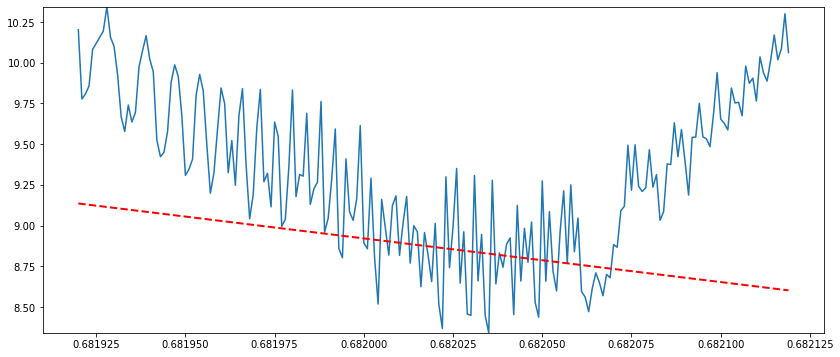

[-1042.20969186 -1458.16113551  1487.95548609]
[-528.00998862  314.10872399   40.16737029]
[ 863.25510453  251.95705253 -564.40748463]
[ 2.00841293e+08 -2.73950993e+08  9.34184805e+07]
[ 1.74878065e+08 -2.38535978e+08  8.13415608e+07]
period: 0.6820086374901163
variance: inf


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


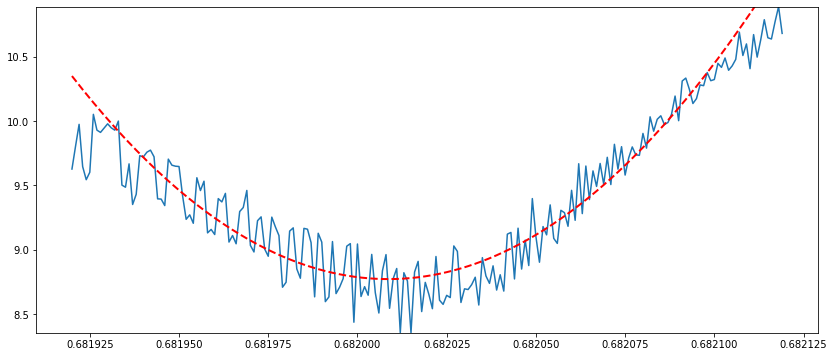

[  -5.93196354  890.22319101 -594.17664416]
[ 2472.26584077 -1732.00180534    41.57030989]
[ 43309996.57734737 -59073276.913992    20143466.2772667 ]
[ 73005636.89990774 -99577887.83361776  33955455.89566711]
[ 7.87290674e+07 -1.07384701e+08  3.66175978e+07]
period: 0.681987666035577
variance: inf


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


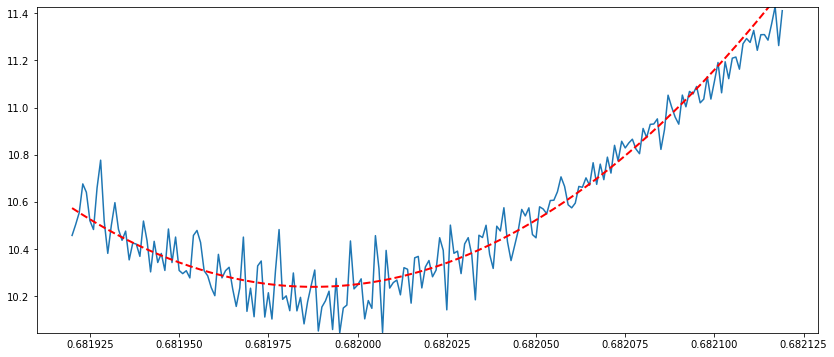

[-15419.9131396    4964.93369063   3795.56871634]
[-1540.72650658 -2596.33562188  2497.46814922]
[-1273.31202762 -1572.85446824  1675.15229144]
[-1283.48714063   627.86659395   179.10068775]
[ 27580450.41364622 -37618203.9702585   12827296.05711045]
period: 0.6819722558201192
variance: 0.09274649230516419


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


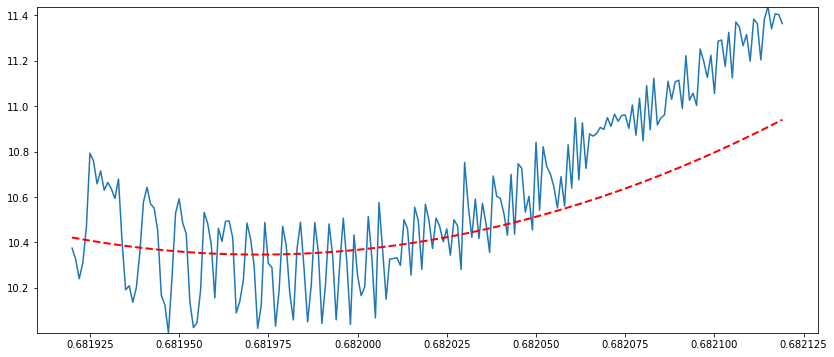

/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


[ 394.55551041  755.8209058  -688.41399768]
[-1117.33225868   101.3639149    461.2389888 ]
[ 15960.57323754 -21255.20979394   7083.08909066]
[ 185.23852255 -150.0356033    26.90732011]
[ 40967360.4750744  -55881157.50855333  19056057.52969943]
period: 0.6658661151326475
variance: nan


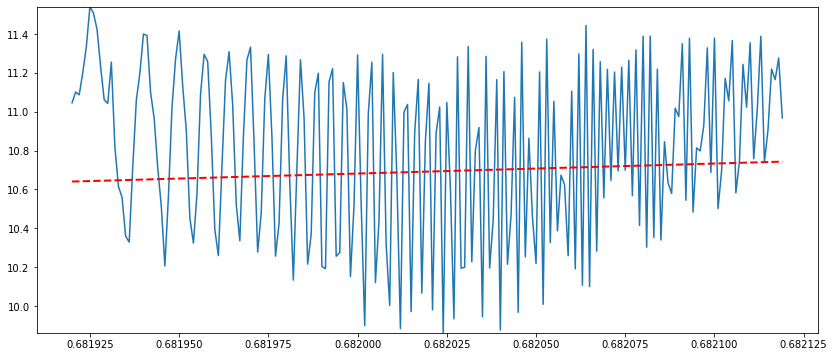

/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


[ -654.36506067 -3269.19648148  2543.64555593]
[-2636.67188996  1287.11927269   358.3088819 ]
[ 162658.33099896 -223743.8873203    76946.84071248]
[ 7.66646718e+07 -1.04572539e+08  3.56599023e+07]
[ 8.77280445e+07 -1.19663003e+08  4.08057585e+07]
period: -2.4979913185758083
variance: nan


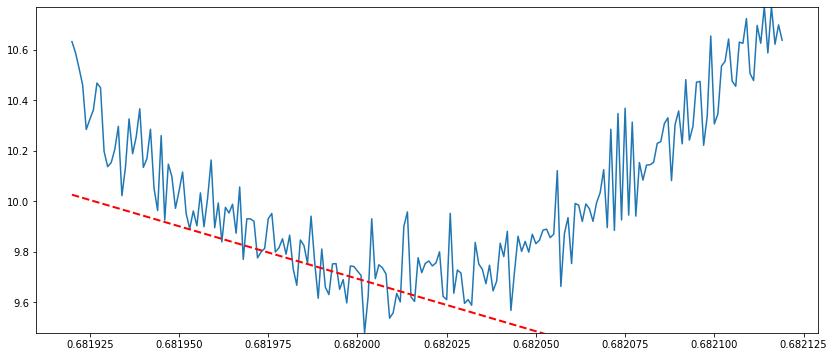

[  675.72985816  1063.4683636  -1028.68276006]
[-1804.37378984  1243.74650059     2.28096097]
[  -14.58611957 -1728.09022188  1196.65231621]
[ 2049.80559117 -5072.83227551  2517.61848796]
[ 2843.71674502 -6465.54555482  3098.20842468]
period: 1.1368125123839894
variance: 492.51399162843614


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


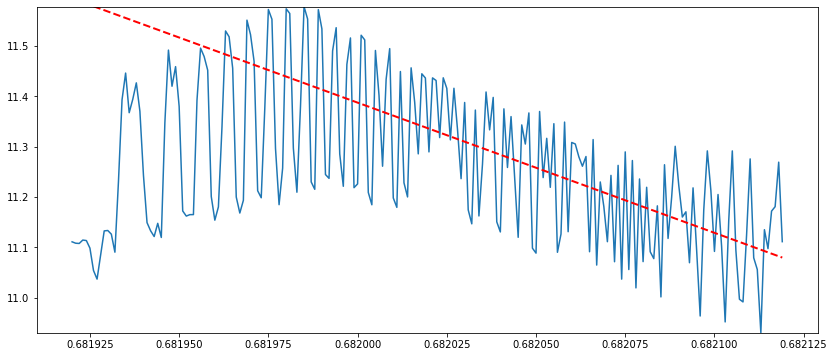

[-3037.51999716 -5417.07111634  5117.13924308]
[ 1451.95774364  2225.11699653 -2183.43572845]
[ 2680.74293629   216.80139588 -1385.19629422]
[ 1.27170922e+08 -1.73465858e+08  5.91534769e+07]
[ 1.22215167e+08 -1.66705758e+08  5.68481290e+07]
period: 0.6820174677445398
variance: 0.018344707539713057


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


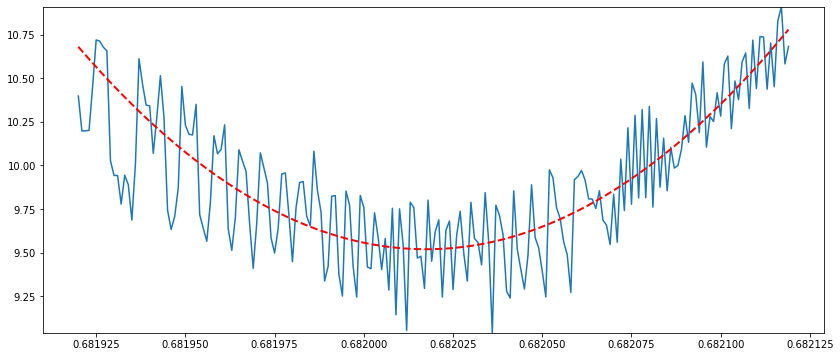

[-3194.84910075 -1750.14929206  2688.69588682]
[  522.58762499 -1960.78733747  1103.32178257]
[  911.26976198 -3899.45621652  2244.83059878]
[ 8.18869377e+07 -1.11697294e+08  3.80899836e+07]
[ 1.40682737e+08 -1.91895207e+08  6.54376233e+07]
period: 0.6820214369244907
variance: nan


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


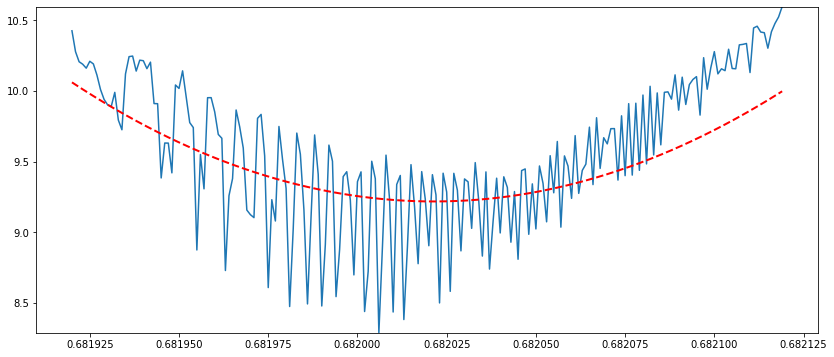

[-7246.08676698 -1552.75095268  4438.3049257 ]
[-226.45545007 -636.60591298  548.39764326]
[ 7272.85384951 -9832.38190499  3331.93111608]
[ 1.67744547e+08 -2.28809880e+08  7.80263329e+07]
[ 1.75957445e+08 -2.40012487e+08  8.18464945e+07]
period: 0.6820185623067122
variance: 0.015941567047927867


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


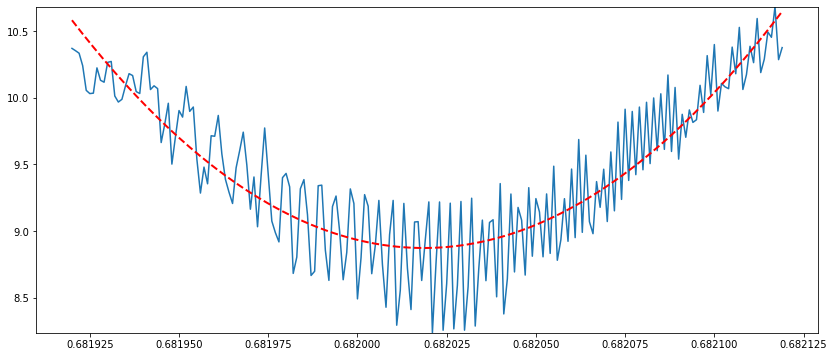

[10358.20270142 -4942.21032753 -1439.02182125]
[ 9034.40457998 -7546.52809289   953.14517008]
[ 9058.3273018  -6490.91947832   222.23634897]
[ 1.61250687e+08 -2.19953609e+08  7.50068055e+07]
[ 1.79659475e+08 -2.45064644e+08  8.35701621e+07]
period: 0.4176549780387554
variance: nan


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


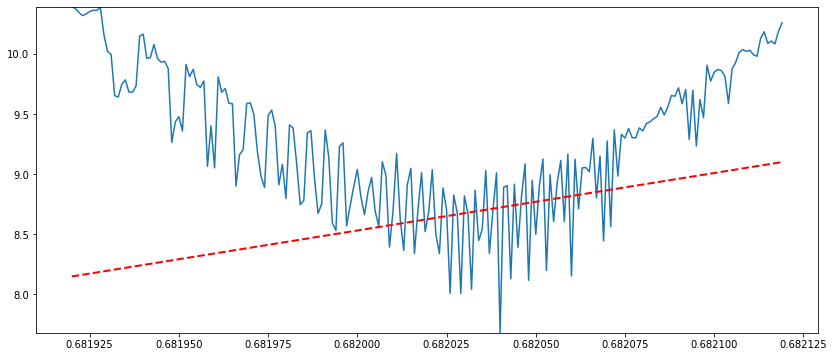

[-9578.92279703  5017.37992694  1042.24808668]
[  410.93115592 -5729.42288778  3725.07599798]
[  522.88815458 -4320.56346225  2712.2519137 ]
[ 1.63957329e+08 -2.23648267e+08  7.62676378e+07]
[ 1.64215797e+08 -2.24000055e+08  7.63873375e+07]
period: 4.131441326793085
variance: inf


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


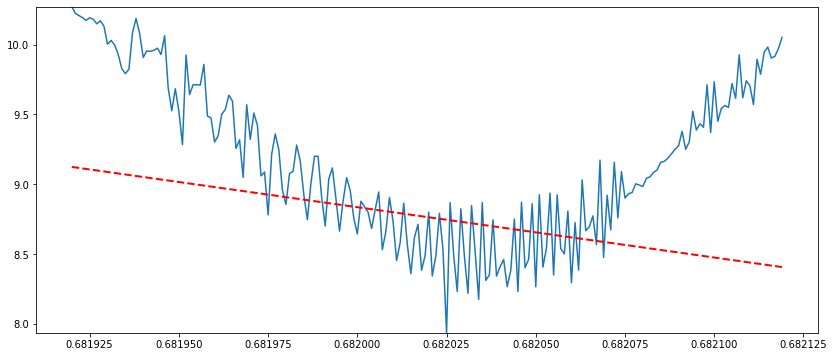

[ 1593.43083313  1640.75937875 -1850.14011849]
[-2559.53424581 -2046.85012768  2596.98428999]
[-1374.79482113 -2373.40948995  2268.64054548]
[  8719.13055724 -13347.03349277   5057.67370831]
[-417.09631411 -191.75627     335.25803141]
period: 0.7653878678129193
variance: 10000000000.000021


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


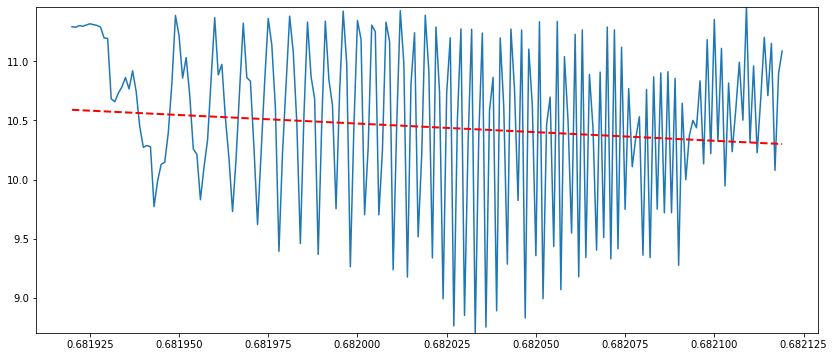

[ 3667.09299956    21.98615712 -1711.68282963]
[-4441.69273374   282.82933594  1882.08962905]
[-2157.32328115  -780.87083941  1545.10768279]
[ 8.92108783e+07 -1.21687242e+08  4.14965879e+07]
[ 1.33302830e+08 -1.81828712e+08  6.20048447e+07]
period: 0.6820202015029707
variance: 0.030937262873658417


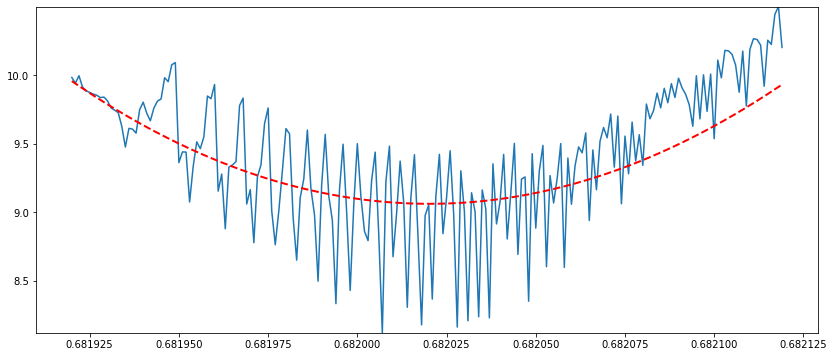

[-2095.15649156 -5123.67301627  4477.60870315]
[ 486.68316968 -304.1650757   -10.27155841]
[1975.07365604 -936.25089732 -271.34855821]
[ 1.85558745e+08 -2.53108707e+08  8.63123213e+07]
[ 1.55713956e+08 -2.12398516e+08  7.24294989e+07]
period: 0.6820150295516922
variance: 0.019915500982111502


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


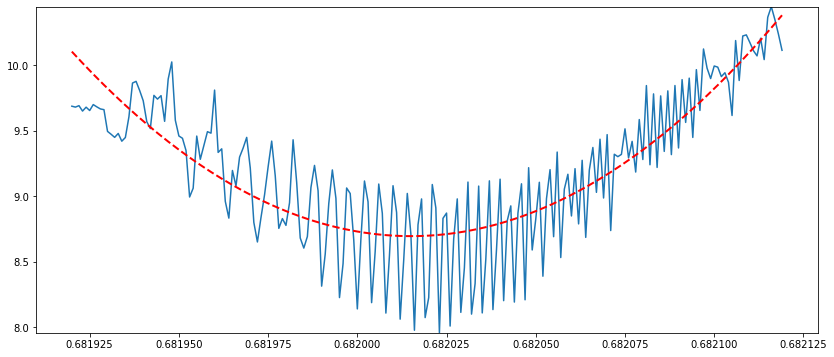

[-19111.71065385  16233.24775727  -2171.91054134]
[ -106.34268766 -2488.40908601  1756.16828283]
[ -791.62192069 -1202.10332721  1197.76885742]
[-371.78014306 -202.20005174  320.60966888]
[ 1.07256131e+08 -1.46305797e+08  4.98931624e+07]
period: 0.6820393178114416
variance: 0.07340692860665093


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


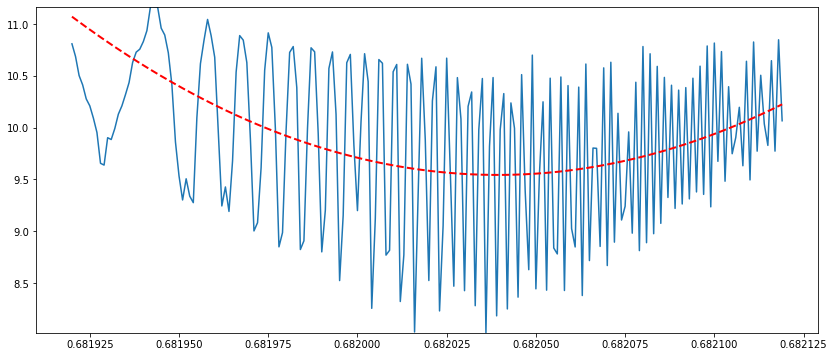

/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


[ 5949.78529874 -1955.34816247 -1425.22759868]
[ 6514.92254923 -1605.79741632 -1926.44116353]
[ 1381863.38396499 -1878625.61443084   638493.65310968]
[ 1.57032268e+08 -2.14200300e+08  7.30451366e+07]
[ 1.50602970e+08 -2.05430097e+08  7.00542796e+07]
period: 0.6820253858596448
variance: 0.010559226197522444


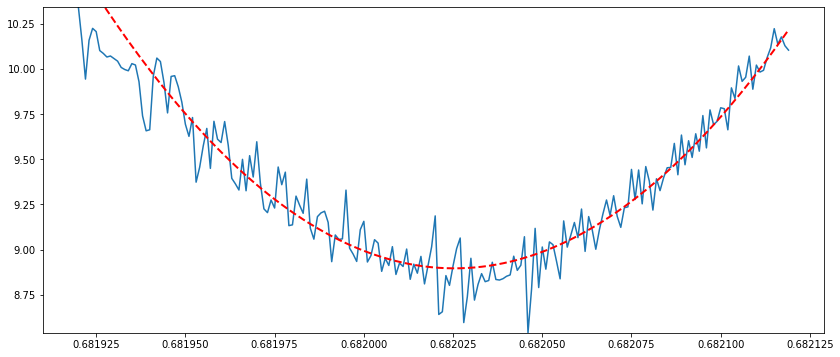

[-1794.37096866    94.73755084   778.79650379]
[ -643.43214806 -1013.23323193   999.14989221]
[-368.94539727 -707.93292195  663.39684091]
[ -64.15545477 -307.10286991  248.45589067]
[ 1.49278511e+08 -2.03621033e+08  6.94365352e+07]
period: 0.026398540906528805
variance: nan


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


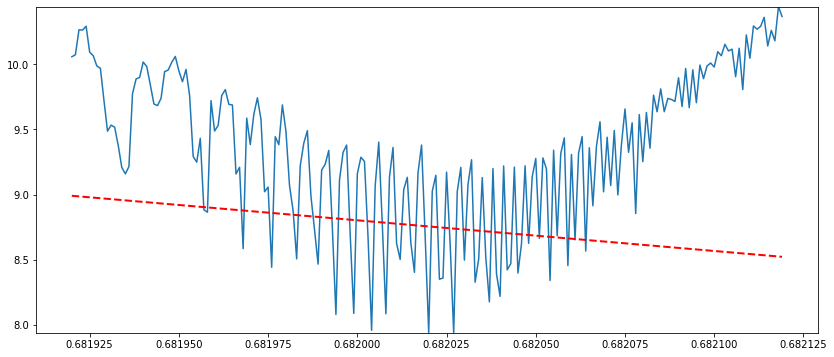

[-1692.65157808 -6722.55881756  5381.03229209]
[  234.78379078 -1757.94104627  1098.68039985]
[ 1359.04689523 -2233.13241638   899.94693278]
[ 1.57984522e+08 -2.15492920e+08  7.34837874e+07]
[ 1.48331290e+08 -2.02326019e+08  6.89939107e+07]
period: 0.6820072104507766
variance: 0.014858047260219259


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


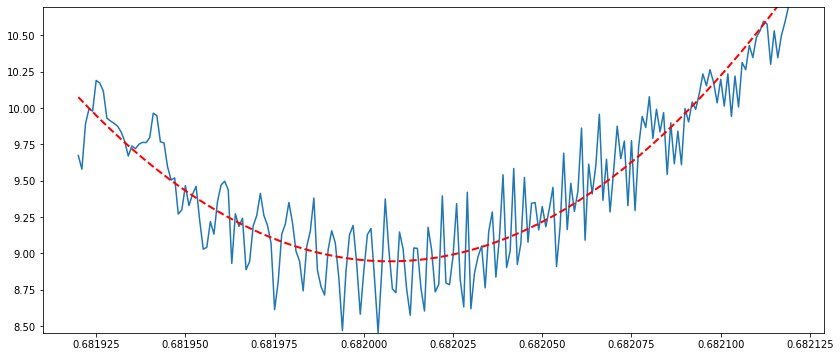

[-16335.15337103   6050.41826655   3480.65974112]
[-2969.95404675  1394.32321036   439.25592559]
[ 3508.98465332 -6068.03901899  2515.1506285 ]
[-663.72491046    1.39317039  316.73558193]


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


[ 1.32358859e+08 -1.80546732e+08  6.15695985e+07]
period: 0.1851962491298716
variance: nan


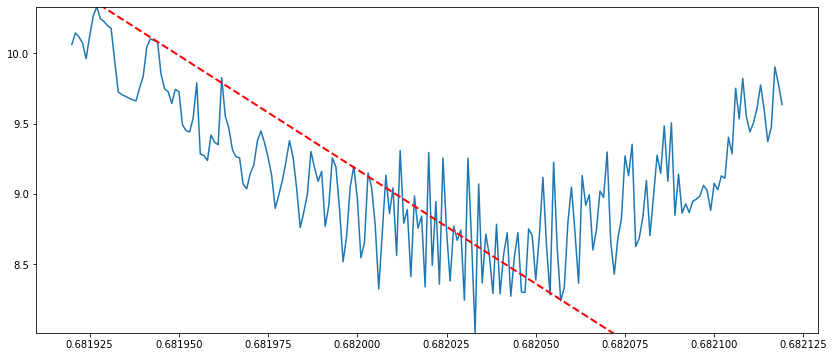

/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


[ -980.61453367 -3090.88112517  2573.65292192]
[ -377.5684413  -3080.66357459  2286.24133276]
[-1104.92602523 -1374.43849446  1461.0030531 ]
[ 264.21585379 -888.878833    493.06598124]
[ 1.32732658e+08 -1.81055768e+08  6.17428984e+07]
period: -1.5759919005172671
variance: nan


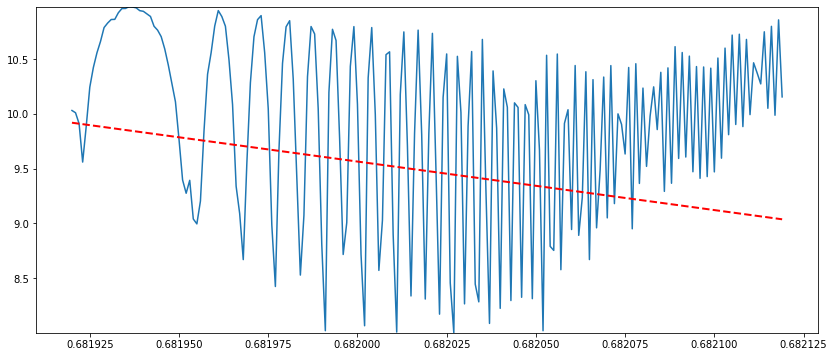

[  241.61940294  1563.66866771 -1170.33390257]
[1279.50684385 -611.25492103 -169.70555048]
[ 3782.68928064 -3046.10658936   326.6839222 ]
[ 1.46275338e+08 -1.99522244e+08  6.80380088e+07]
[ 1.48408500e+08 -2.02432119e+08  6.90303582e+07]
period: 0.6820091717517084
variance: nan


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


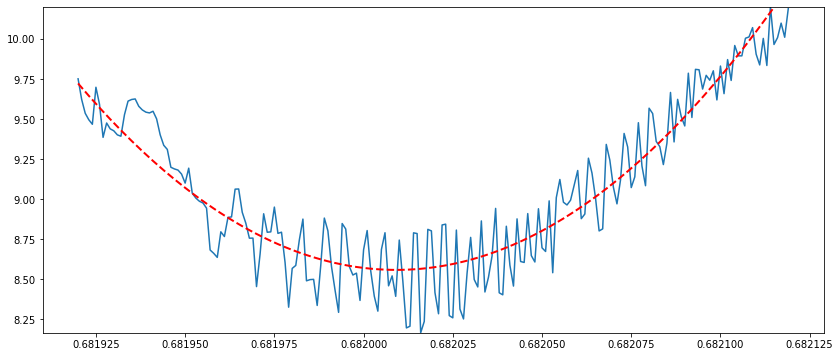

[ -3050.9988081  -11169.53863083   9045.73710641]
[-2205.76276995 -2190.55150674  2528.97478821]
[ 2277.19513011 -8779.74986271  4937.77340735]
[ 1.05748169e+08 -1.44245188e+08  4.91892163e+07]
[ 1.35678520e+08 -1.85070253e+08  6.31105861e+07]
period: 1.9277552781105172
variance: inf


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


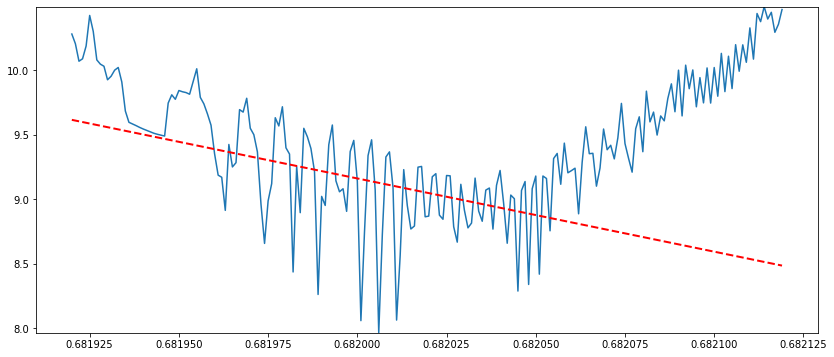

[  4250.26033828 -27004.43172056  16450.24403822]
[-3351.84326043   653.28590686  1123.44680259]
[ 3432.40036648 -6163.54969762  2617.10154396]
[ 10869.06312581 -17596.06621386   6955.28190667]
[ 9.27502200e+07 -1.26513478e+08  4.31418489e+07]
period: 3.1767973690133218
variance: nan


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


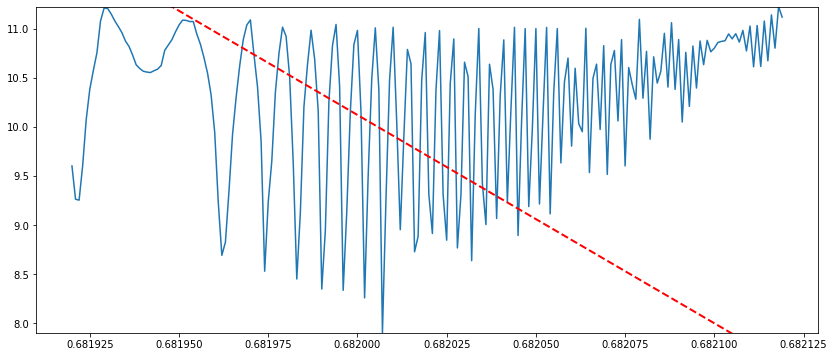

[-3933.20885702 -3281.92510072  4076.44356462]
[ 19841.73399122 -22488.14077433   6116.35552925]
[ 3255195.51378432 -4435863.7340998   1511198.02474858]
[ 1.92627322e+08 -2.62754912e+08  8.96032678e+07]
[ 1.67083749e+08 -2.27910815e+08  7.77205228e+07]
period: 0.6820256801988694
variance: 0.014945766056762493


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


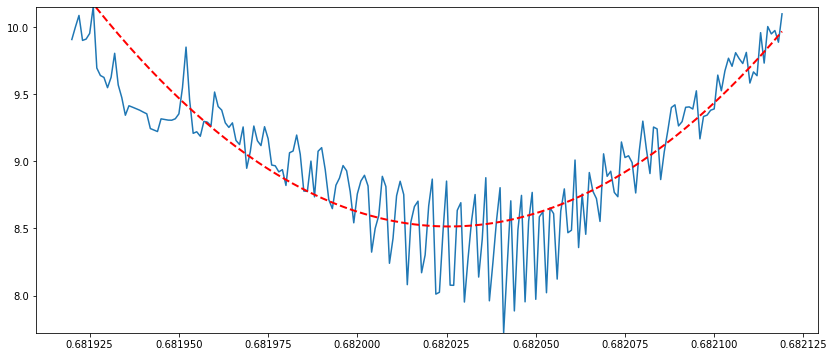

[-11639.94567113   4110.1023524    2619.35802971]
[1077.01130514  323.42989089 -713.03025408]
[ 4794.3456115  -2403.47883332  -582.16388869]
[ 1.47484114e+08 -2.01164897e+08  6.85960675e+07]
[ 1.66325814e+08 -2.26865872e+08  7.73604054e+07]
period: 0.6819923707627193
variance: 0.014476016273501483


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


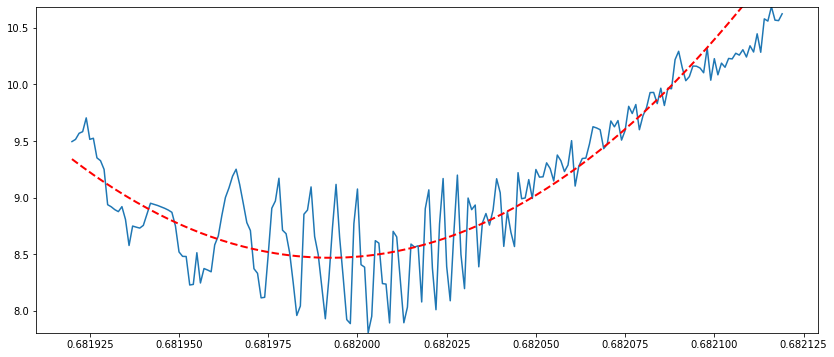

[-3772.74412139 -2997.70871731  3807.95881176]
[-215.31229545 -603.5184444   520.50320419]
[ 11731069.02919594 -15999774.53271943   5455453.35638003]
[ 1.82861637e+08 -2.49423679e+08  8.50536223e+07]
[ 1.82285971e+08 -2.48638495e+08  8.47858823e+07]
period: 0.6819401749703995
variance: nan


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


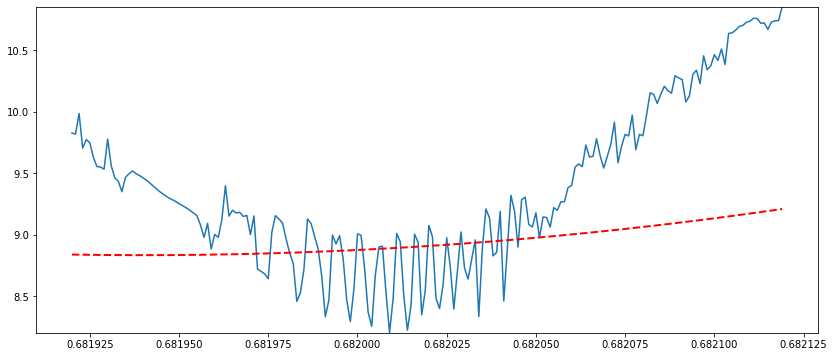

/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


[ 2712.44911851  2866.94645691 -3208.15181827]
[ 3733.28765876 -1617.35060292  -624.47407847]
[2490.9598091  -543.03806756 -779.15733203]
[ 1.56353786e+08 -2.13277053e+08  7.27310611e+07]
[ 1.13036132e+08 -1.54187486e+08  5.25800564e+07]
period: 0.6820335418934519
variance: nan


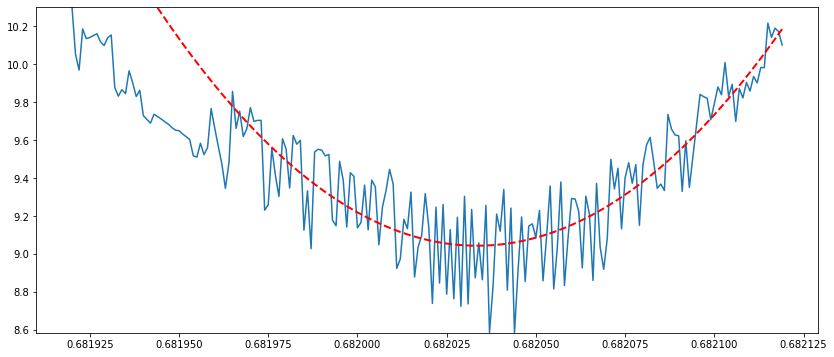

[-37957.98887184  23868.01382163   1387.62194963]
[ 1100.57715681  1290.54976682 -1382.1392635 ]
[ 810.14985244 -417.11526247  -82.30241237]
[ 1583.48618884 -3193.66200896  1451.79214447]
[ 8.94679813e+07 -1.22037515e+08  4.16158896e+07]
period: 1.0084274910220161
variance: inf


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


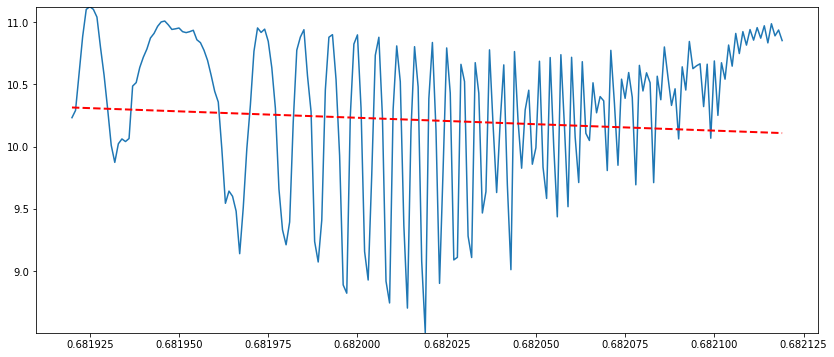

[ 33028.22113313 -30944.27481913   5750.128224  ]
[11062.63192661 -4886.73642622 -1804.1482264 ]
[ 8.62924294e+07 -1.17698476e+08  4.01336891e+07]
[ 1.78092110e+08 -2.42920646e+08  8.28369748e+07]
[ 1.67188477e+08 -2.28047759e+08  7.77652070e+07]
period: 0.6819745154376317
variance: nan


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


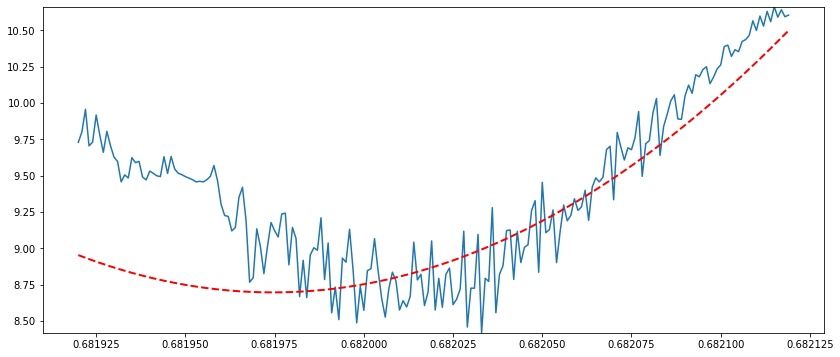

[ 22048.66093133 -20363.06910881   3640.73874016]
[ 7613.74422935 -3369.51784216 -1234.60947902]
[ 156489.66454722 -206606.6955619    68127.53482111]
[ 1.62453680e+08 -2.21594545e+08  7.55663833e+07]
[ 1.52250077e+08 -2.07675198e+08  7.08193292e+07]
period: 0.6820237766946877
variance: nan


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


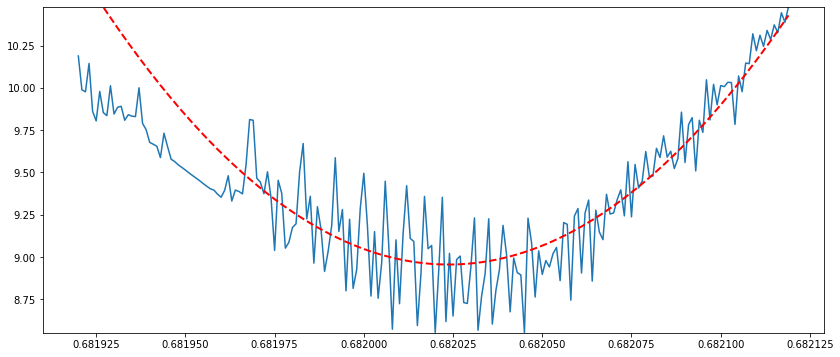

[-9410.1897066   4025.72256145  1641.06901297]
[  35.24226694 -930.05087526  627.67786068]
[  3706.95446726 -14080.67047636   7888.87023785]
[-3746.51928319    -7.68864512  1757.95446475]
[ 7.33788658e+07 -1.00092177e+08  3.41326031e+07]
period: 0.68202319467874
variance: 0.08655666167149283


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


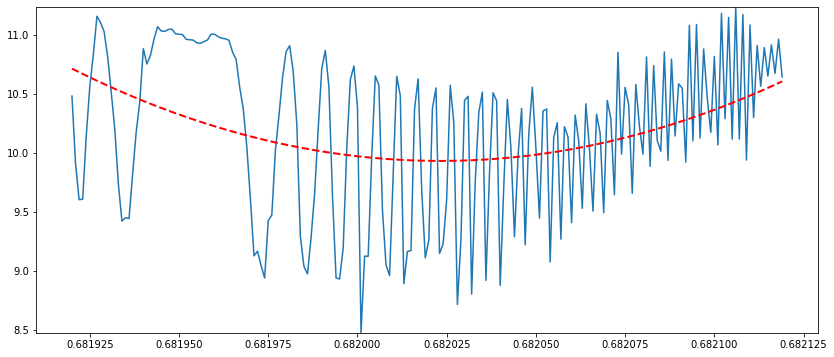

/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


[   30.29010488 -8985.7083663   6122.98307574]
[ 1466.94079881 -2964.4734546   1348.21146402]
[ 644.21614801 -799.53231796  254.5444333 ]
[ 1.74538586e+08 -2.38075001e+08  8.11850738e+07]
[ 1.55052502e+08 -2.11494991e+08  7.21209530e+07]
period: 148.32745546194408
variance: inf


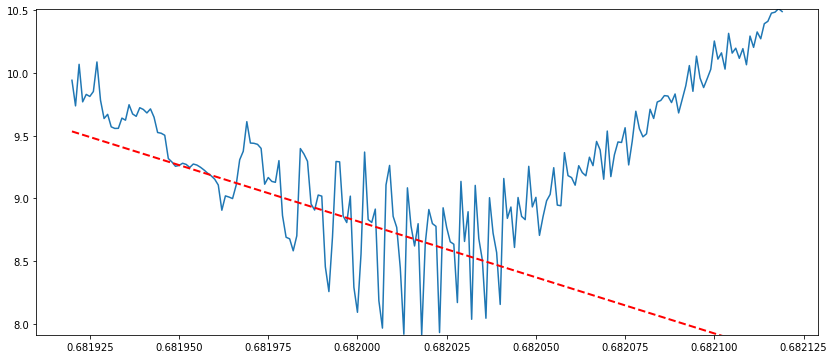

[ 4505.37853956 -1771.13453592  -878.31869323]
[ 5329.38287452 -3321.96456185  -203.7718154 ]
[ 5275.80468425 -3450.71586261   -90.93049394]
[ 6603.79768202 -3150.56119326  -913.30944418]
[ 8.98677751e+07 -1.22579702e+08  4.17997074e+07]
period: 0.32703218457911376
variance: nan


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


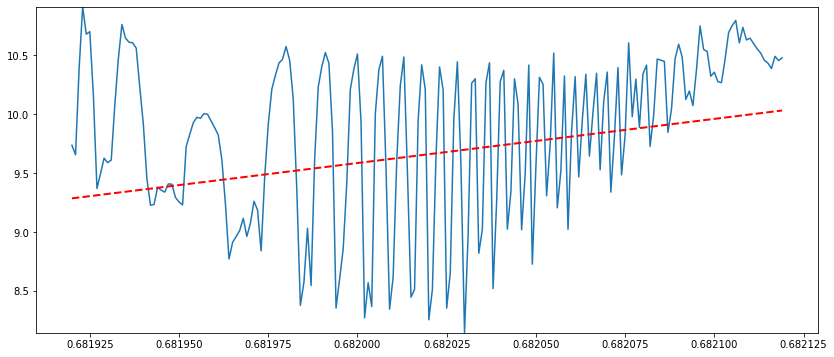

[-60686.42748331  10818.15978379  20867.35244379]
[-7879.18671     2789.77232823  1773.44319405]
[-3553.47143905  -572.71882318  2054.40299865]
[  580.27939233 -6481.72660469  4161.66565469]
[-2368.55402679 -2663.838318    2929.45803207]
period: 5.585004991033411
variance: 10000000000.000698


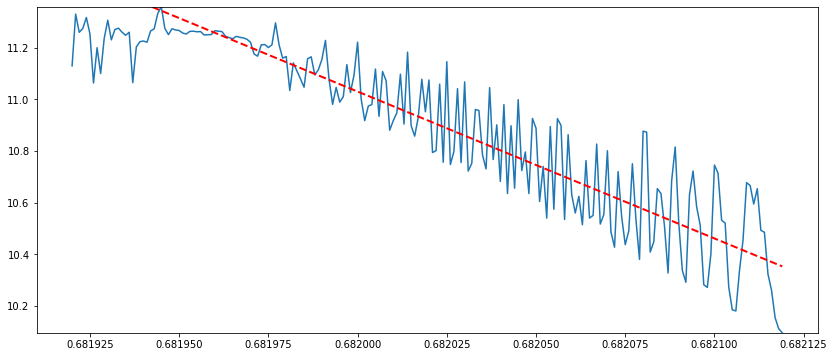

[-50937.62162778   9974.65740799  16906.56309879]
[-25182.70906841  20445.4713255   -2218.93186867]
[-5568.91756021 -3588.99226715  5049.43943671]
[-8514.59614353  3785.80050366  1389.61115188]
[-5849.25702245   964.47866822  2073.96680182]
period: 0.09791051377384108
variance: 14142135623.730951


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


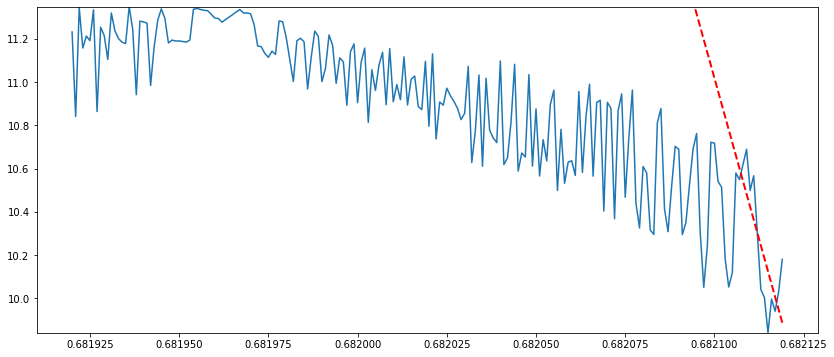

[  963.20003858  3042.89799591 -2513.25307384]
[-6668.67858252  2825.8560134   1185.74491166]
[-5643.39223155  1887.08057838  1349.05892544]
[-23737.96293222  26844.97272985  -7256.03053476]
[-8679.3344326   6575.88501272  -436.66538837]
period: -1.5795773847683097
variance: 10000000000.002338


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


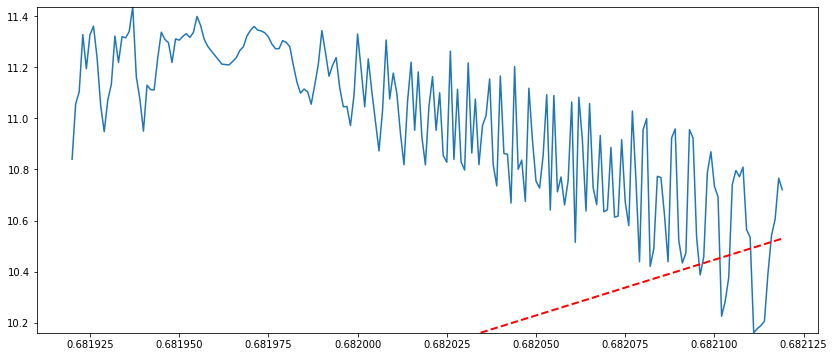

[-591.25832742 -805.64687796  836.32582959]
[-153.36343878 -378.11419863  340.97066321]
[-158.50773004  167.75483653  -28.97306415]
[  798.64523642 -1397.89834862   593.63093983]
[-489.95871183  325.14745325   17.87712777]
period: 0.8751685259428778
variance: 10000000000.00009


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


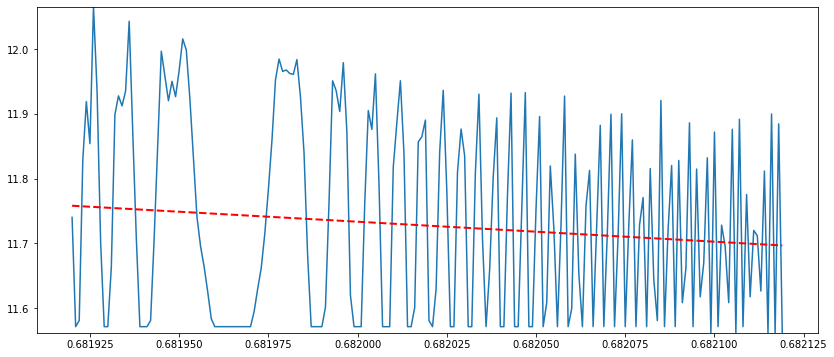

[  105.34863192 -5294.87216629  3573.19224366]
[-1823.01944659 -2350.46889247  2462.02710526]
[-1761.38279912 -2520.68410209  2549.45253623]
[ 1871.26648304 -7568.63350778  4302.52980611]
[-1779.98258819 -2584.45377952  2601.60251422]
period: 2.0223291488354262
variance: 10000000000.000093


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


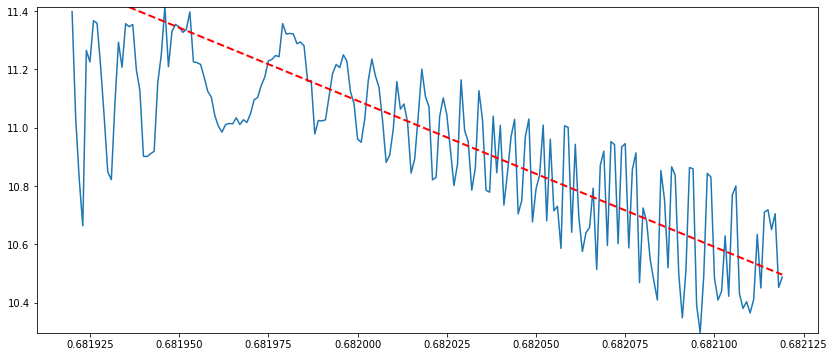

[2385.23712546 -963.21702577 -442.15789632]
[  4803.18813437 -11532.71250507   5642.37806994]
[-9259.934219    7906.06866319 -1073.79402696]
[-4196.91278583  1931.3991063    645.909361  ]
[-4417.99209471  2084.19335285   644.54577908]
period: 0.2019122156628271
variance: 10000000000.000092


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


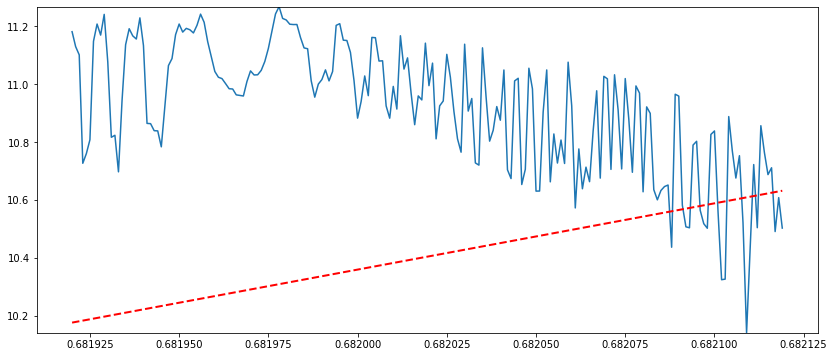

[-1523.46074268  1224.69316484  -115.875417  ]
[-5109.04416558  2640.46575823   586.67445452]
[-7775.65712798  6812.56315969 -1018.44176691]
[-2447.76027686  -336.09618678  1378.80058845]
[-7980.58711559  7363.92225803 -1299.17444089]
period: 0.4019444448185254
variance: 14142135623.730951


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


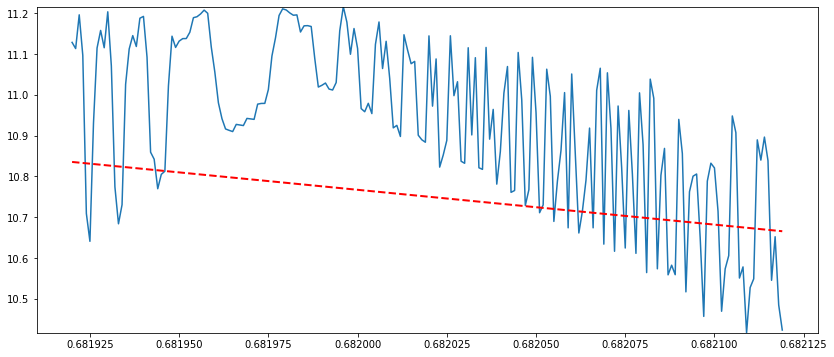

[-11386.96409819   3929.55273688   2628.25031085]
[-4272.64381135  -568.72782959  2386.4649254 ]
[  -38.26467413 -4958.41678232  3410.57482136]
[-5245.0419128   2500.48063756   745.36963432]
[-17008.86935407  18750.21926981  -4865.3309916 ]
period: 0.17254611075404688
variance: 14142135623.730951


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


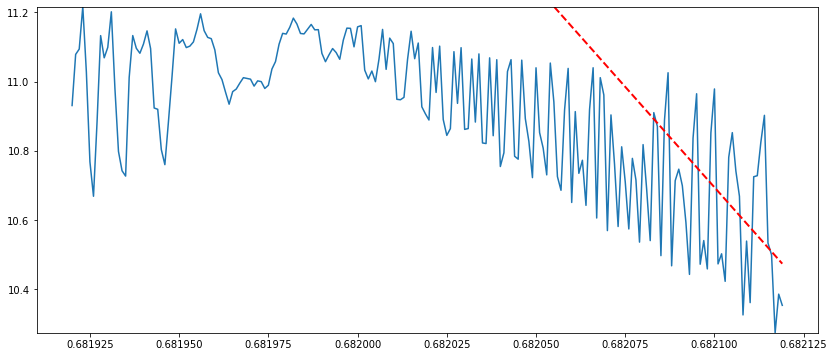

[-5301.66310131   467.78943287  2156.30689544]
[  4628.16643209 -14001.39441288   7405.67110328]
[  6676.96887982 -16257.68754586   7991.5867238 ]
[ 1.07430319e+08 -1.46541046e+08  4.99725828e+07]
[ 1.21662667e+08 -1.65953599e+08  5.65921374e+07]
period: 0.6820235121658017
variance: 0.013900811249444658


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


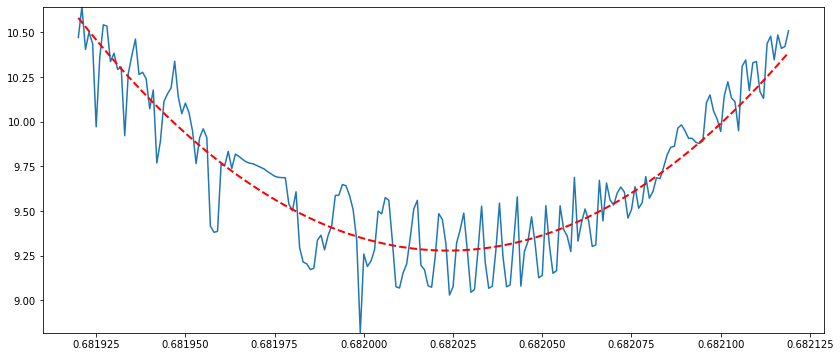

[ 12723.99376523  15727.82864737 -16637.36765067]
[ 12296.97335052 -10896.0056841    1720.43475448]
[ 73088.18914654 -94645.55439623  30562.37640626]
[  85671.25548381 -115003.58455744   38594.12971159]
[ 8.52139849e+07 -1.16240388e+08  3.96408850e+07]
period: 0.682049950561878
variance: 0.07974038437113312


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


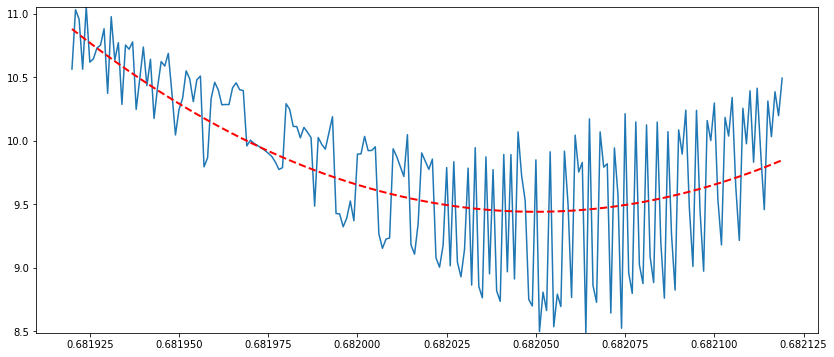

[-14402.47486832   9443.79482022    266.98293836]
[-1100.04350289 -1132.04226606  1292.42853328]
[  81255.20655138 -113058.50223048   39321.00304606]
[  938363.58318101 -1281764.11249317   437716.75384344]
[ 1.73308260e+08 -2.36397764e+08  8.06134528e+07]
period: 0.6820152841932636
variance: 0.012487738778105927


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


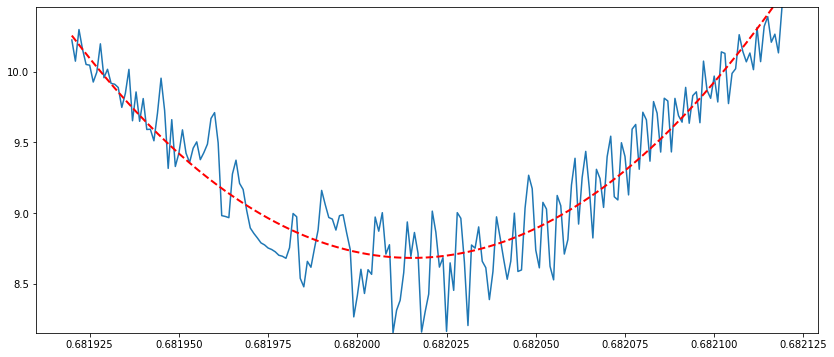

[  5421.00791478 -31462.22908857  18947.35031409]
[-2840.69228443 14155.09670736 -8322.06033272]
[11162.08462847 -4976.83750204 -1787.15300631]
[ 18159.18989238 -16369.64226511   2728.28555417]
[ 5491.44359312 -2592.09652144  -775.72311193]
period: 0.45072611614634767
variance: inf


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


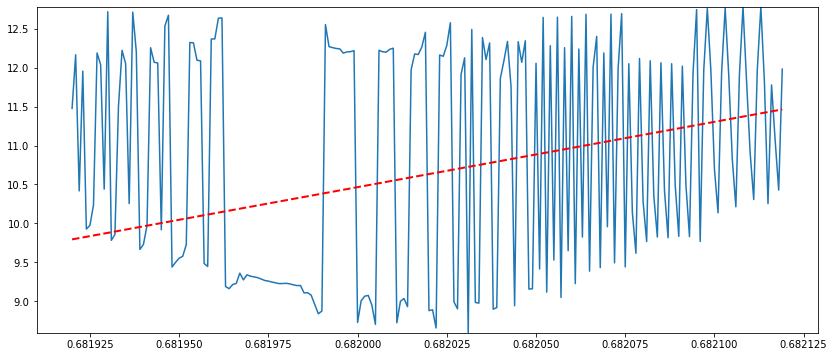

[-33582.71018814  26417.63660796  -2388.10282404]
[-10894.38052089   4299.06507352   2143.88351467]
[-2649.58996057 -4537.22262319  4335.52492779]
[ 2.37229146e+08 -3.23592197e+08  1.10348917e+08]
[ 2.16165194e+08 -2.94859472e+08  1.00550548e+08]
period: 0.682024535993193
variance: 0.007874089904881438


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


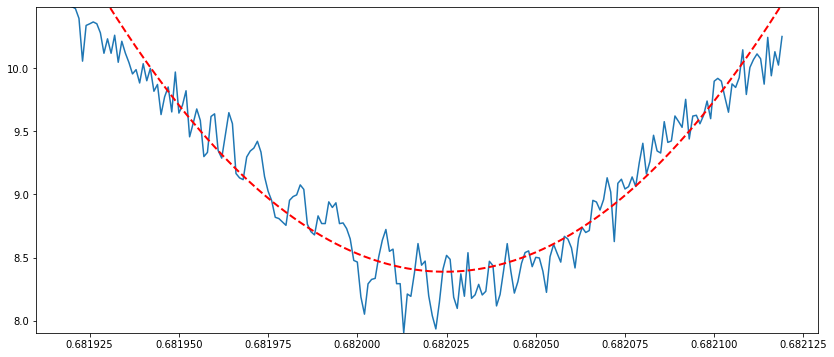

/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


[ 8982.724504    4558.68601249 -7278.29518676]
[  380.02074116 -1545.2763358    886.71691361]
[ 435.204099   -292.3854405     6.61517849]
[ 43414114.04956899 -59218186.0458628   20193866.13110222]
[ 8.25491937e+07 -1.12601469e+08  3.83986005e+07]
period: -0.25374740205289165
variance: inf


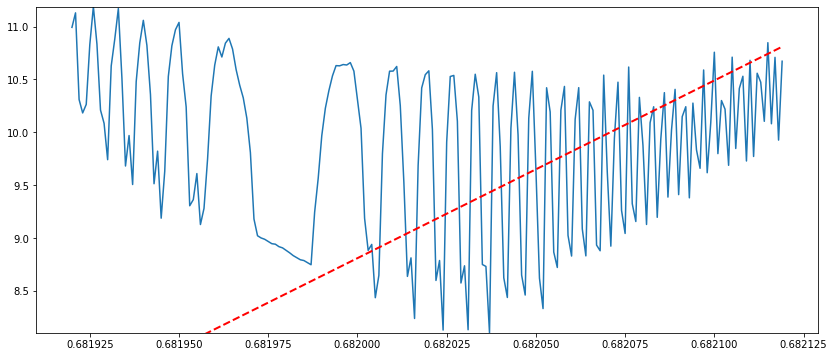

/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


[ 1896.07460576   840.58342746 -1445.93906547]
[ 400.13880973  496.83637929 -515.69057887]
[ 1433.56684178  1089.221859   -1400.30735782]
[ 8.79632545e+07 -1.19984830e+08  4.09158430e+07]
[ 1.09365067e+08 -1.49178940e+08  5.08717293e+07]
period: -0.22166412252756604
variance: inf


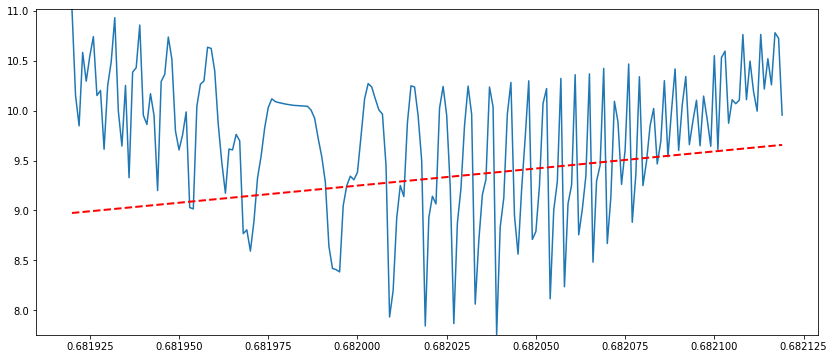

[ 4588.8402963   8865.02553528 -8172.08658967]
[ 12526.25154141 -11024.25261443   1700.9124761 ]
[ 1.51508544e+08 -2.06664007e+08  7.04746014e+07]
[ 1.94470426e+08 -2.65266034e+08  9.04585820e+07]
[ 1.69858015e+08 -2.31693126e+08  7.90096816e+07]
period: -0.9659331075912918
variance: inf


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


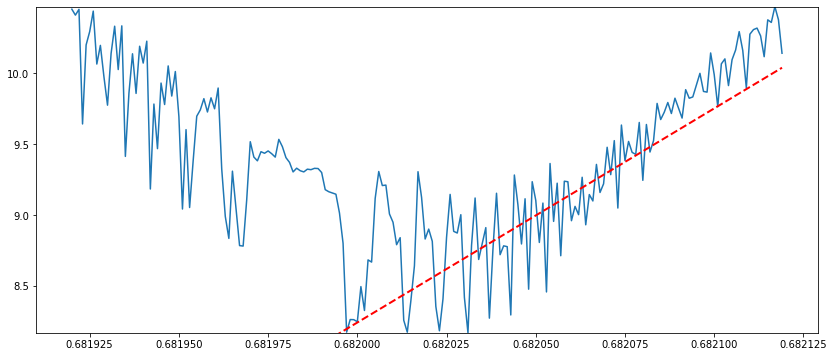

[ 2599.34132978  2659.93512504 -3014.40526797]
[10515.64966812 -9463.19165759  1571.6126581 ]
[ 76324.54102079 -99369.06556407  32278.24906188]
[ 1.44729947e+08 -1.97416335e+08  6.73205775e+07]
[ 1.45381890e+08 -1.98305777e+08  6.76239431e+07]
period: 0.6820167835723938
variance: 0.008352340571903372


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


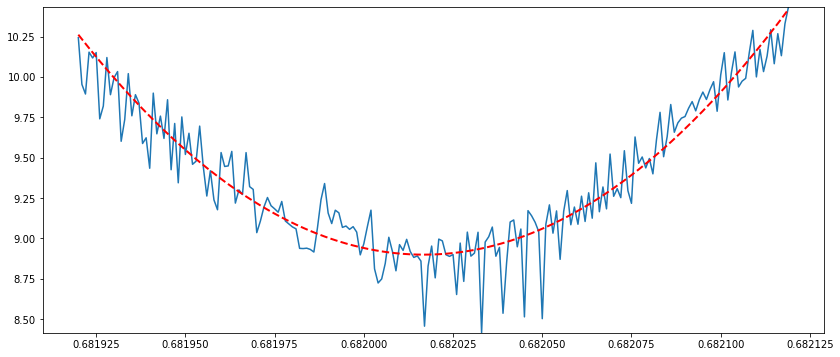

[ -360.87007176 -6460.43698773  4582.71218994]
[-441.25061922  443.54510793  -88.50671106]
[ -610.36212314 -1235.39591531  1135.36022168]
[ 1.58827920e+08 -2.16646347e+08  7.38781402e+07]
[ 1.50494583e+08 -2.05279009e+08  7.00016503e+07]
period: 0.6820159439041981
variance: nan


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


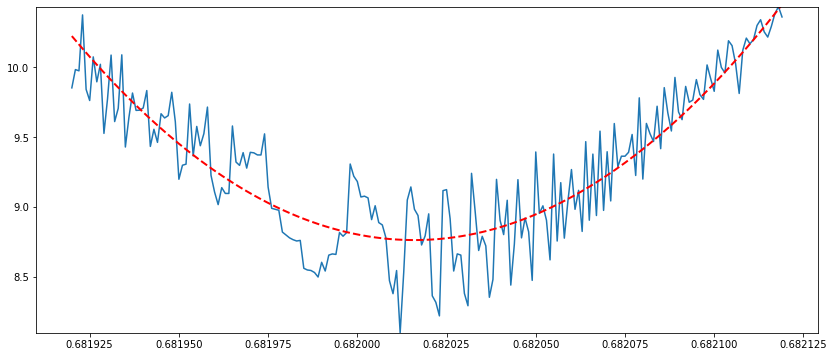

[  3546.15291589 -68424.54569842  45027.38568085]


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


[-2606.87393333 -8996.29154931  7358.05714272]
[ 1845.15255378 -9954.8790414   5941.04965432]
[ 2195.32080043 -6430.14052985  3374.26934238]
[ 66504627.50794683 -90717224.51389417  30936258.62737036]
period: 2.697576149186201
variance: nan


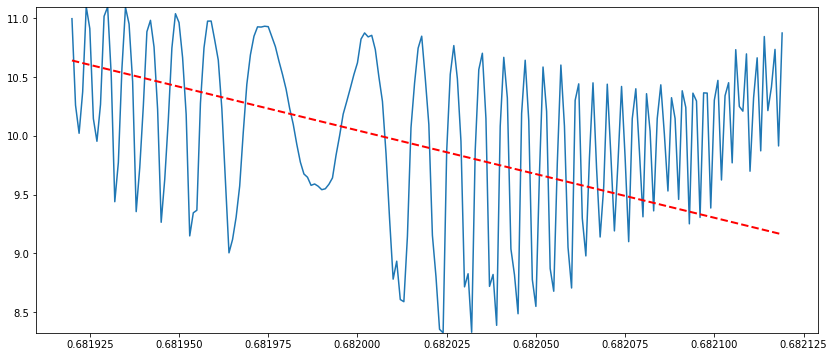

[-6916.78258141 -3512.44010756  5622.33972461]
[ 5017.37564308 -3982.20178596   391.47237867]
[ 6104.88901272 -4345.83554686   133.65004908]
[ 8.60775139e+07 -1.17410436e+08  4.00372090e+07]
[ 1.07463212e+08 -1.46581626e+08  4.99849596e+07]
period: 0.6820084010045386
variance: 0.048132515349504815


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


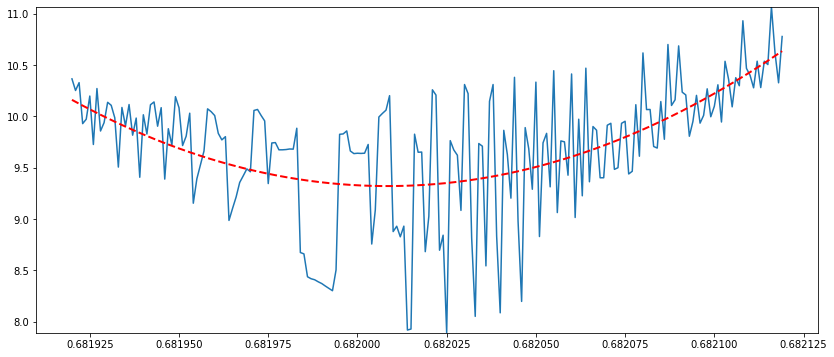

[ 3544.47555056   111.74331845 -1716.2492383 ]
[ 9097.33304574 -6485.09570746   200.08145751]
[ 1.49421954e+08 -2.03819751e+08  6.95053418e+07]
[ 1.56191753e+08 -2.13051930e+08  7.26528923e+07]
[ 1.45789054e+08 -1.98861650e+08  6.78136662e+07]
period: 0.6820274547806293
variance: 0.02320796257348366


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


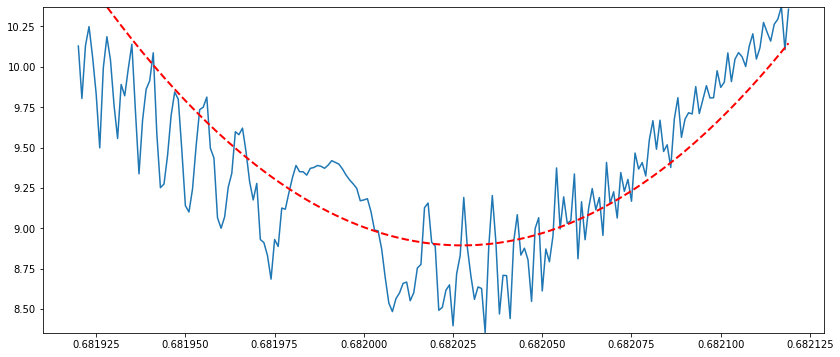

[ -17.28785925  855.62142476 -565.99857498]
[ 269.36913574  542.95145723 -486.05045471]
[  676.18045129 -1862.55507449   965.42299651]
[  603.88082101 -2068.11714069  1139.40253922]
[ 1.02803453e+08 -1.40230277e+08  4.78207056e+07]
period: 1.7123553760342753
variance: inf


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


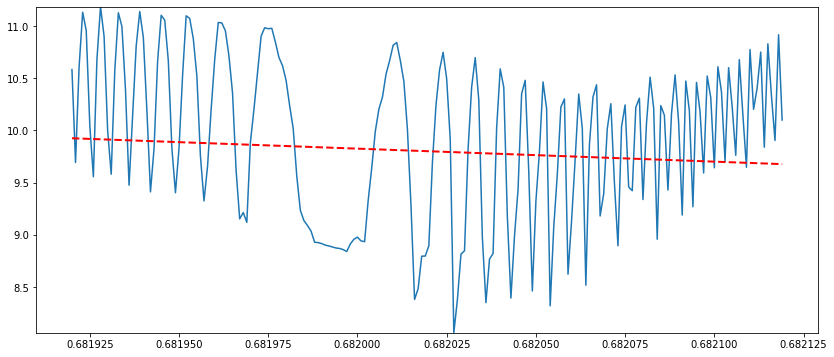

[-3589.46147529  1723.00044974   502.88446525]
[ -131.81115777  3506.26381183 -2321.40963401]
[ 8.90957050e+07 -1.21526004e+08  4.14401930e+07]
[ 1.91235367e+08 -2.60845393e+08  8.89484075e+07]
[ 1.72487732e+08 -2.35273393e+08  8.02282788e+07]
period: 0.6819969854308484
variance: nan


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


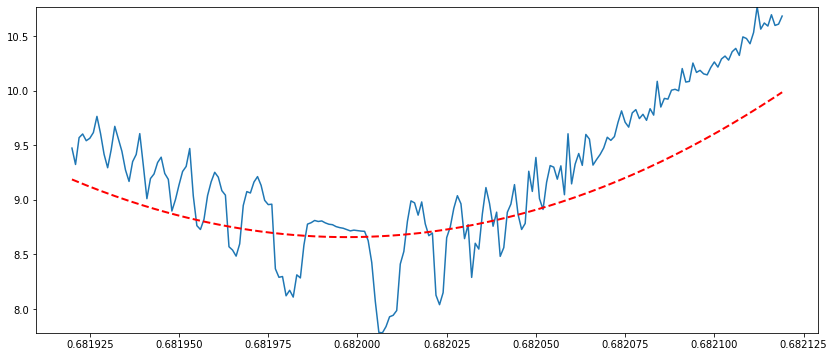

[-41784.50144501  38829.94664547  -7037.93740348]
[ 9237.18708578  1341.25740677 -5203.01277967]
[ 601729.47100114 -808235.62192536  271346.22833441]
[ 1.91169819e+08 -2.60759110e+08  8.89200502e+07]
[ 1.79544689e+08 -2.44902286e+08  8.35128239e+07]
period: 0.6715938481296514
variance: nan


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


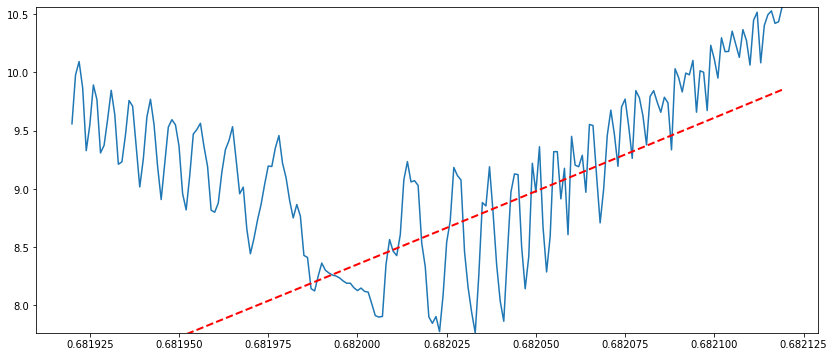

/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


[-11972.39781654   3299.52352785   3327.79194855]
[-1245.94456133   630.58484171   158.8887069 ]
[ 115.47679141  104.98444191 -115.7828926 ]
[ 1.41903313e+08 -1.93558247e+08  6.60040972e+07]
[ 1.33979055e+08 -1.82748903e+08  6.23178870e+07]
period: 0.6820074978797757
variance: inf


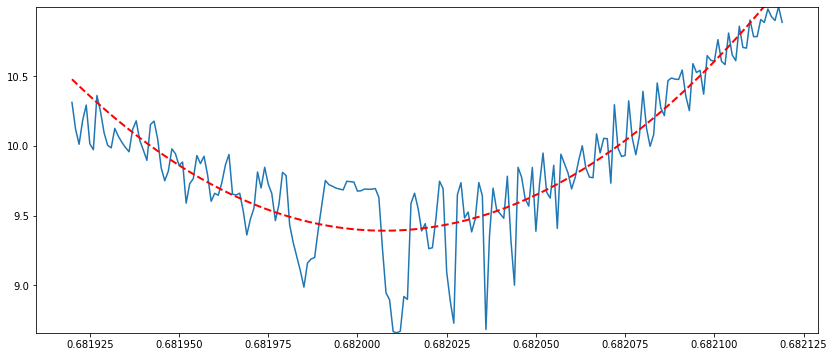

/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


[-2743.22158159 -2705.4490431   3130.75579856]
[-101.85926375  159.87241022  -52.08162527]
[  75526.28965963 -102605.11217455   34857.26354648]
[ 9.94048544e+07 -1.35590566e+08  4.62371924e+07]
[ 1.09055040e+08 -1.48753558e+08  5.07258197e+07]
period: 0.6820113860141449
variance: 0.020752250910839806


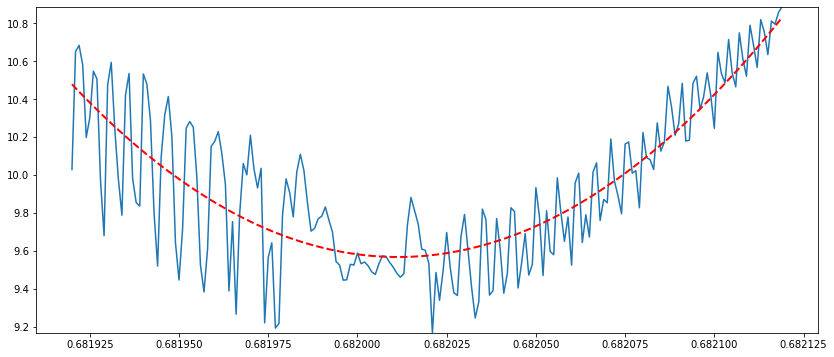

[-66641.91657691  51106.05704101  -3846.31935705]
[-3400.44726554 -1539.15514854  2641.53453431]
[-1793.84033253  1182.70079972    37.86619372]
[ 152382.91599006 -208330.5975675    71214.71922212]
[ 8.32749844e+07 -1.13592343e+08  3.87367939e+07]
period: 0.38343777959952013
variance: nan


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


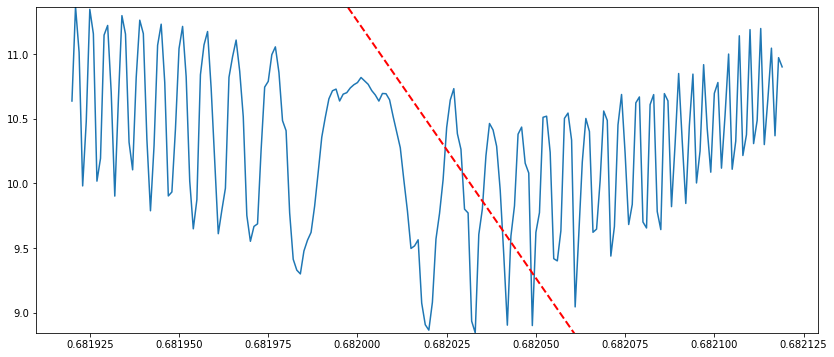

[  899.86151161   916.8654941  -1034.76606225]
[ 3453.33776443 -2473.30441977    89.75343538]
[ 1553.29025183  2453.6056086  -2386.65029857]
[ 1.46406691e+08 -1.99710290e+08  6.81051619e+07]
[ 1.43410209e+08 -1.95622541e+08  6.67110527e+07]
period: 0.6820384085571488
variance: 0.011699553804947166


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


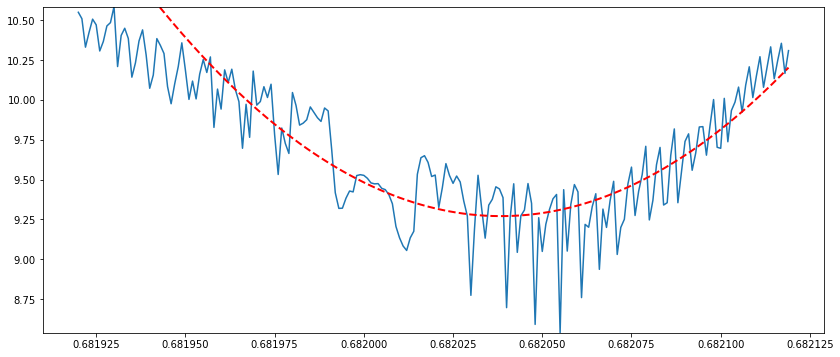

[14490.08262514 -4510.49919994 -3655.4330744 ]
[ 23380.41358147 -20969.74952304   3434.92164902]
[ 72924457.51142561 -99464747.80490929  33916051.24675007]
[ 5887.65364168  -107.28641228 -2656.44803725]
[ 1.90102961e+08 -2.59303919e+08  8.84238315e+07]
period: 0.009111134826250764
variance: inf


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


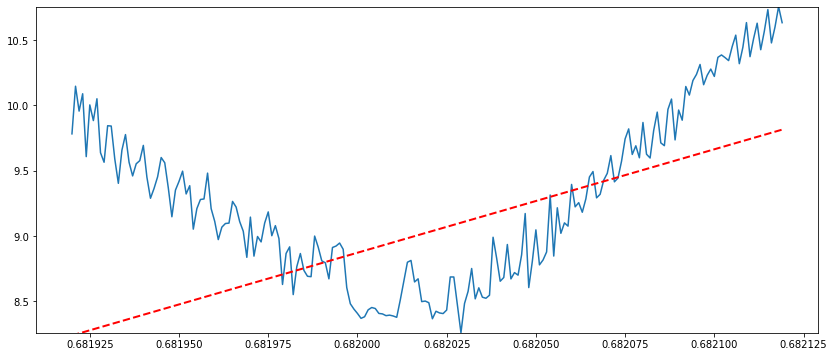

[   82.47643055  4144.27804101 -2854.19244169]
[-3421.25141148  1505.84982613   575.30511591]
[-5711.43230102  1924.8310544   1354.98350373]
[  391.18065464 -6463.58810551  4237.41721515]
[-5102.71080575  1333.4166706   1475.18009732]
period: 8.261640790408023
variance: 10000000000.003567


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


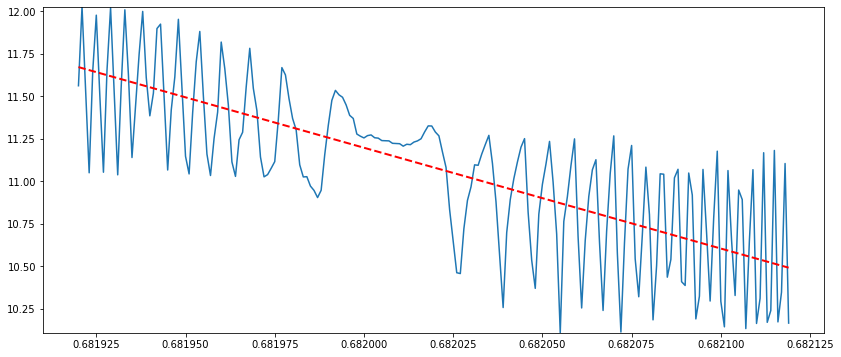

[ -227.40864341 -9376.88962149  6509.64562864]
[-4025.81149018 -4971.49698072  5271.95811432]
[ 61134.55861455 -91205.28426615  33775.90373778]
[ 1.45344693e+08 -1.98251847e+08  6.76044634e+07]
[   6.37527304 -162.06017179  116.88753605]
period: 0.6820057973864413
variance: 1091017.141892513


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


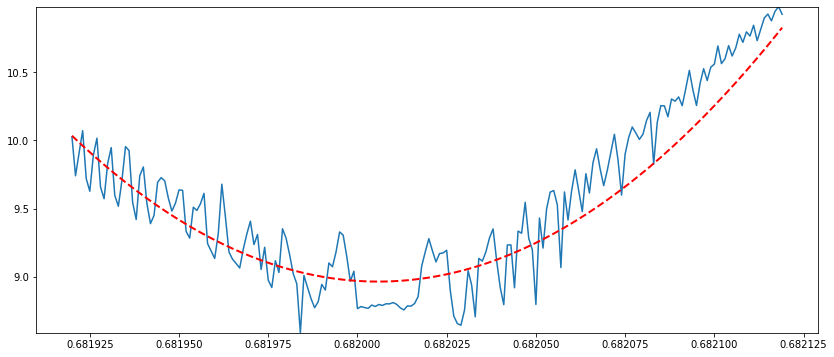

[ 10115.77763729  11275.78052907 -12385.57899899]
[ 2360.33467579 -1319.20696227  -188.58840333]
[-226.90957633 -253.58053172  288.08892311]
[ 8.43191461e+07 -1.15010663e+08  3.92184231e+07]
[ 1.20099978e+08 -1.63815142e+08  5.58605541e+07]
period: -0.5587700083579538
variance: nan


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


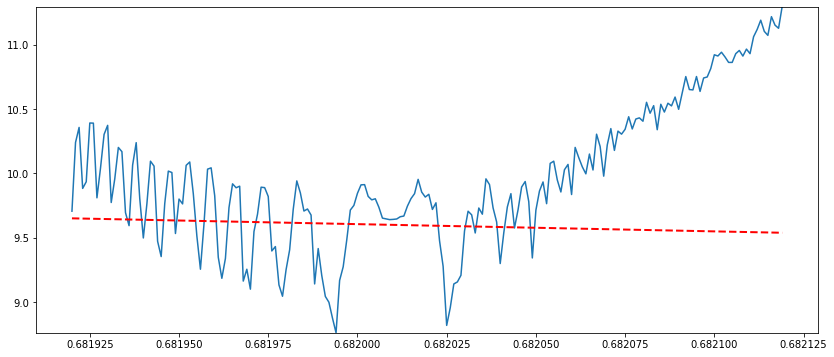

[-27853.46487069  18057.67104824    650.23856435]
[-4749.65332741  -511.23247734  2567.73014248]
[-1670.47651693 -2456.21992171  2462.00922103]
[-969.94919159 -393.31568711  729.23918574]
[ 11516026.69424018 -15710288.20838747   5358046.04092474]
period: 0.6821054095092137
variance: 0.7113614805650463


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


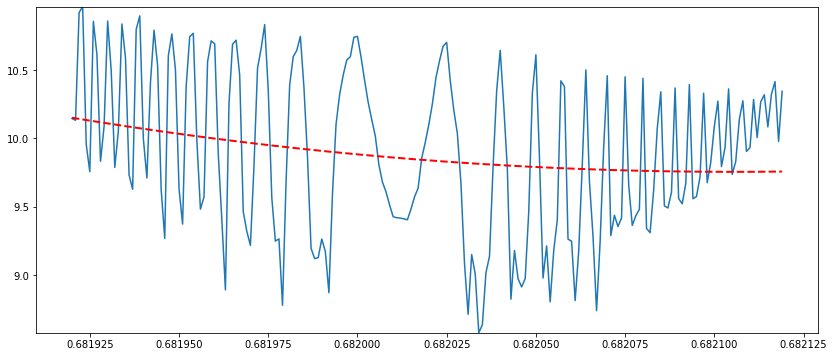

[-41325.02769273  36878.94296925  -5917.84572514]
[-5331.15287623  2569.64275499   738.83638688]
[   93.14620128 -3484.52347182  2344.78581584]
[-570.02081723  315.94568461   61.1546685 ]
[-597.04792957  268.56964585  106.04174219]
period: 18.70459247807869
variance: 10000000000.167719


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


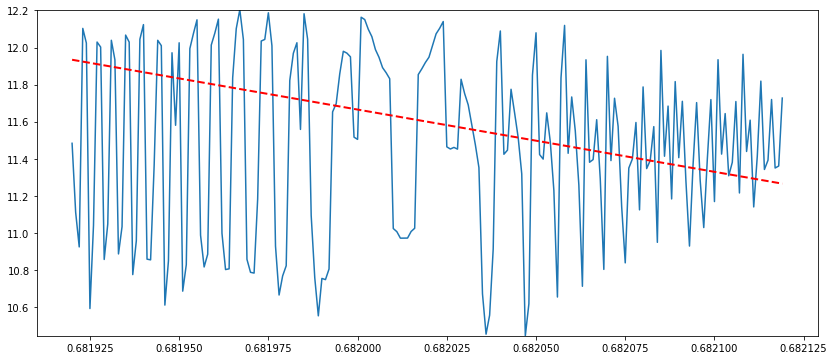

[ 2608.08653298   321.98443242 -1422.1544188 ]
[-705.45196633  140.85896275  242.88488577]
[ 20298.41166775 -29828.76784364  10912.87942504]
[ 1498.45404176 -3683.87209075  1826.36258085]
[  388.41603829 -2435.08261248  1491.01147264]
period: -0.061728096125185886
variance: 13579.03819105223


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


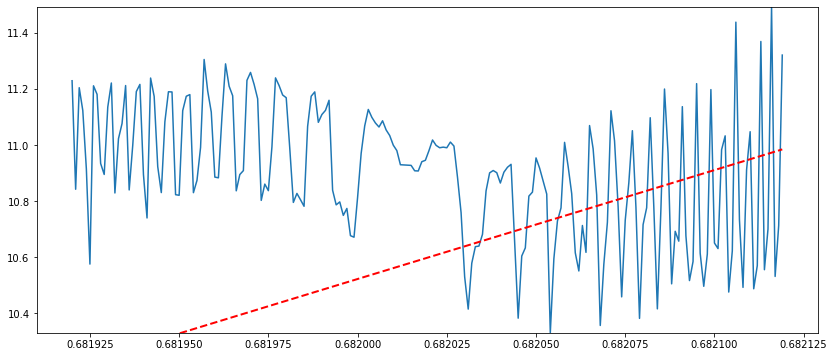

[ 21670.60940006 -17487.60360802   1855.60849433]
[-2263.99382689 -2150.26063507  2529.24178102]
[  6241.00742977 -12039.48763689   5317.82900633]
[ 1218.98951206 -5636.43198943  3286.88308858]
[ 1921.56166713 -7486.31728244  4221.78448722]
period: 0.40348665986237925
variance: 3582.3761733849824


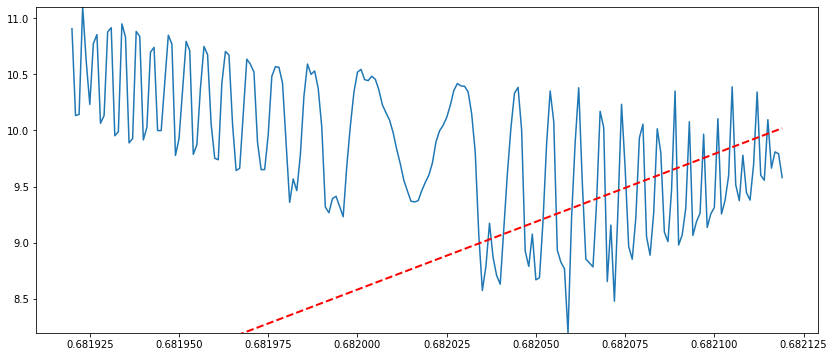

[-7443.9651499  -3496.31399435  5856.77063303]
[-6623.02869949  1534.17634488  2044.04523908]
[ 4465.55545264 -7333.24614875  2933.88614799]
[ 4600.95065607 -4464.06188568   914.07380695]
[ 357.214082    626.00033846 -583.42946562]
period: 0.821090033091161
variance: 10165.069077490209


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


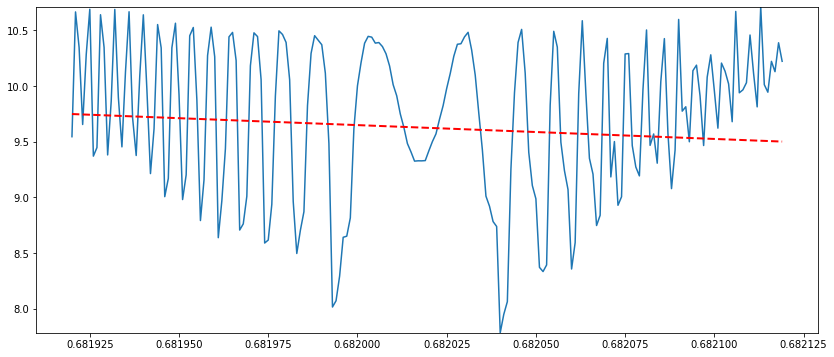

[11133.46127931 -8039.70209895   314.62680422]
[ 632.31191208 -568.51500984  104.37650477]
[-122.13348188 -683.03926823  533.50883723]
[-2726.28939533  1378.19771644   339.14506347]
[ -145.81843126 -4379.5426587   3065.87590837]
period: 0.3610603161612852
variance: 10000000000.000048


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


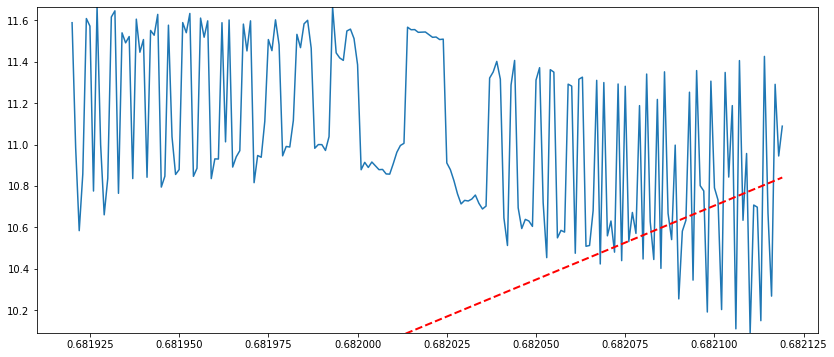

[  58.92953399 -692.27638072  456.20257083]
[ 391.11295723  -39.02395297 -143.74739835]
[ 292.4277989   265.28072253 -305.36766544]
[ 2897.35226704 -2378.41961781   286.07173927]
[ 347.36099276  625.10241002 -576.29050845]
period: 0.04988834075399817
variance: nan


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


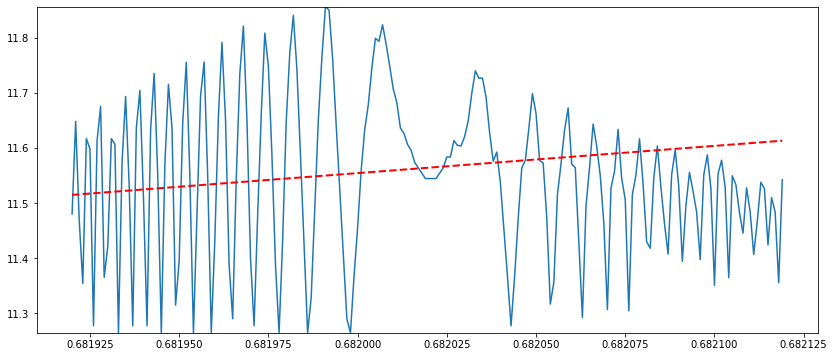

[  7154.32027804 -26573.79640727  14806.70886222]
[-7372.21529747  3218.71409118  1244.60844145]
[1067.95861841 -884.95155052  117.26037536]
[ 6421.49767159 -7445.63989691  2101.61624487]
[ 23195796.53907228 -31640153.40311303  10789673.45830205]
period: 0.6820234293273053
variance: 0.279344446188786


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


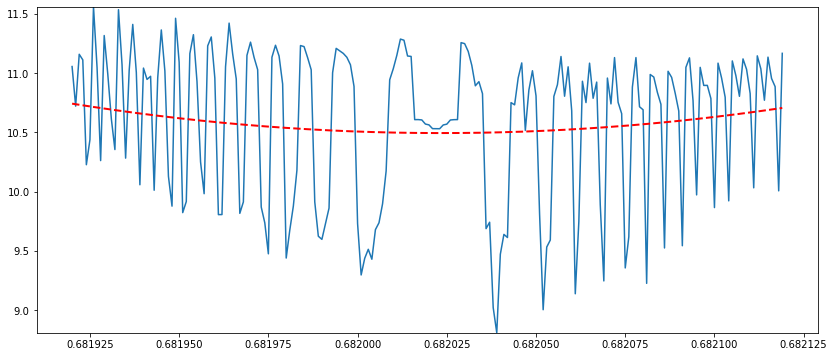

[ -734.10651308 -3280.24747084  2587.62935226]
[   52.24336414  3421.16448977 -2348.37777398]
[  482.72415248 -3582.2761076   2227.77373801]
[ 7.56886298e+07 -1.03242813e+08  3.52070092e+07]
[ 1.12465466e+08 -1.53406242e+08  5.23126789e+07]
period: 0.6820148784017033
variance: 0.03629291715461787


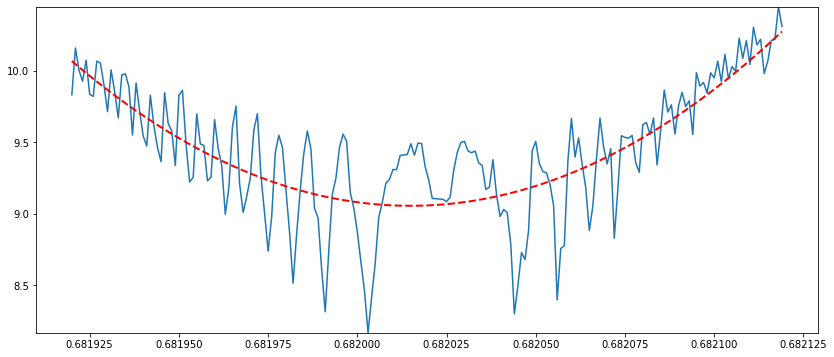

[  9753.98711983   9873.37746311 -11262.37053782]
[  130.30643241  3421.09232568 -2384.94692742]
[ 3719.02083432 -3980.7776435    994.19281361]
[ 1.45785873e+08 -1.98862190e+08  6.78155143e+07]
[ 1.48101150e+08 -2.02019914e+08  6.88921917e+07]
period: 0.6820335794914864
variance: 0.01654517969901743


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


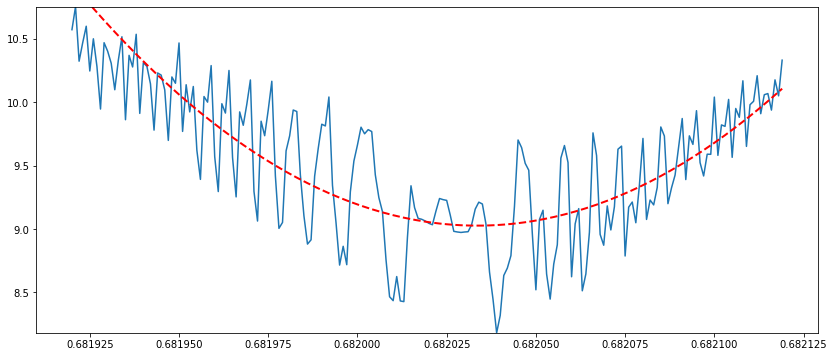

[ 115.81102517 -440.10472794  255.64485478]
[-220.75402442   87.94429284   52.06292585]
[-1004.51674032 -1462.06006896  1473.92674222]
[  9677.17528203 -17342.28119371   7336.0541735 ]
[ 40609.52779852 -60813.78635774  22596.33040233]
period: 0.19919068987733934
variance: nan


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


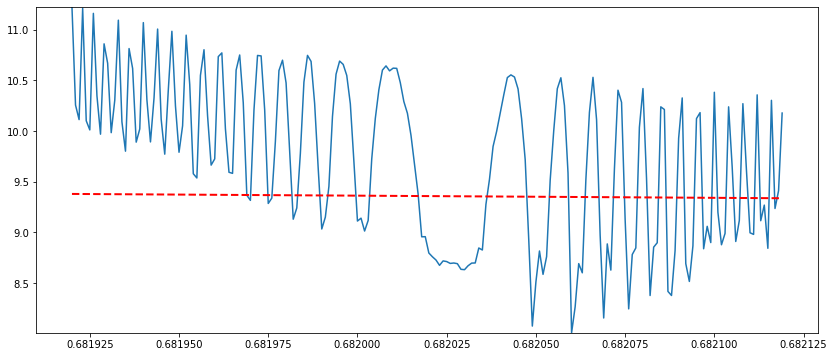

[-22505.56675289   9996.63713648   3659.0295428 ]
[-1307.98012155 -2424.36731919  2270.84471282]
[ 972.04381543   -2.46063864 -441.35947684]
[ 1.73436376e+08 -2.36574145e+08  8.06741545e+07]
[ 1.53670662e+08 -2.09612452e+08  7.14797885e+07]
period: 0.6820199704870958
variance: inf


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


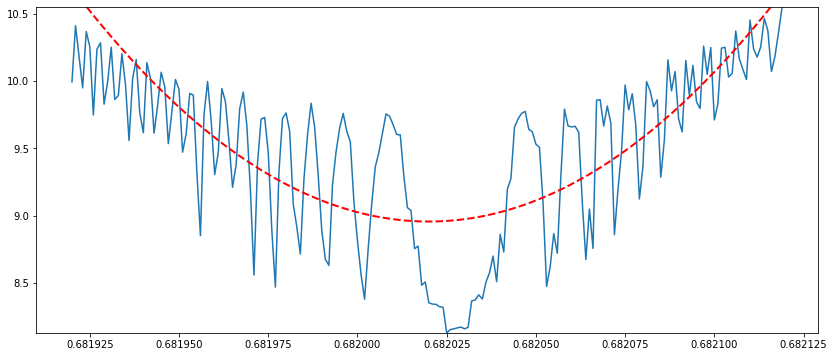

/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


[-5238.6167177  -5686.01915336  6323.50866199]
[-2734.53915855 -4374.03519851  4264.27387309]
[  4169.46738296 -12183.37490473   6379.10958685]
[-2058.4501564   -824.63060121  1529.33012286]
[ 2505501.49970691 -3419902.40314493  1167014.10027752]
period: 1.4610229299949322
variance: inf


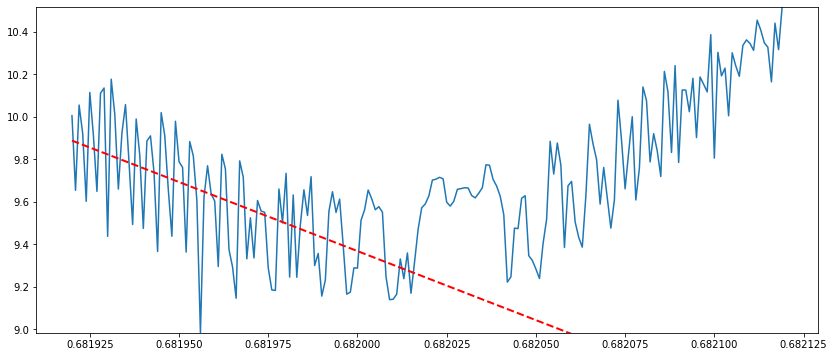

[-27576.36200305 -32289.19948975  34860.07759687]
[-3338.68527798  6997.74348475 -3210.00077398]
[-524.5529886  -761.98932338  773.47349863]
[ 34588298.59668987 -47181307.47717404  16089813.74192155]
[-408.6406046  -595.222659    605.93501947]
period: -0.5854506748601352
variance: 14142135623.730951


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


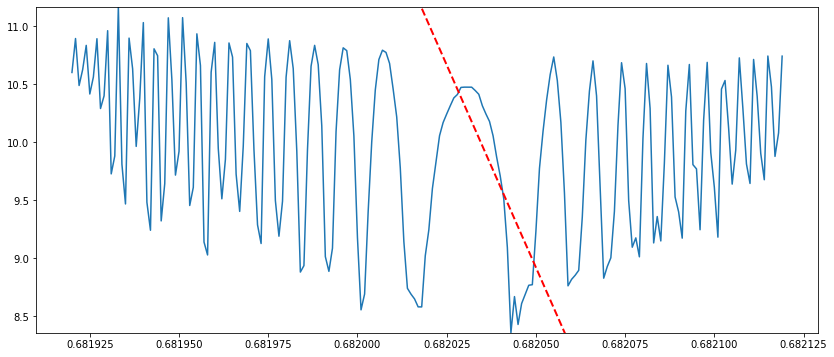

[-19503.31724511  -3050.93881114  11162.35732692]
[2258.06868148 -773.25143571 -514.11941242]
[ 9488.13411117 -6369.84627626   -60.25451615]
[ 8.85773798e+07 -1.20821165e+08  4.12005781e+07]
[ 1.24252512e+08 -1.69485753e+08  5.77964672e+07]
period: 0.6820214357691365
variance: 0.021808013998208062


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


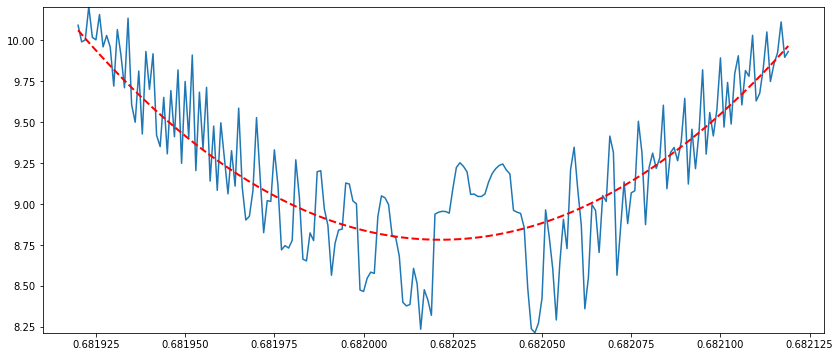

[ 551.53345781  314.0636138  -461.38125618]
[   337.49189145 -10200.34029575   6809.42021361]
[-1269.7728837  -1555.07652871  1660.88589939]
[-691.70868094 -500.25316858  672.68636482]
[ 8.01443548e+07 -1.09320875e+08  3.72797838e+07]
period: 0.6820248019492433
variance: 0.061294877775310036


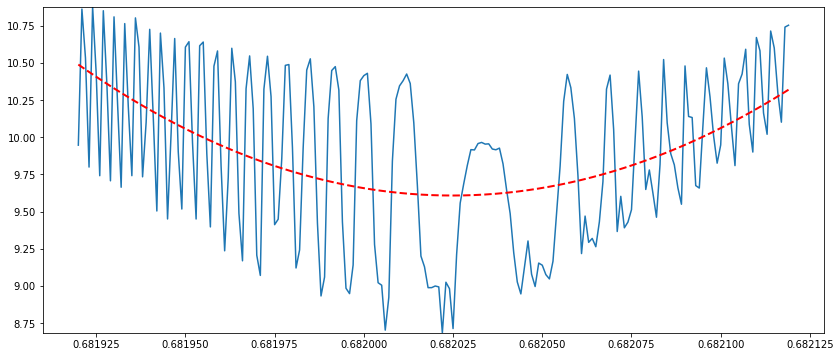

[ 5519.23039299  1362.91441782 -3487.39864279]
[  -70.18260089 -1887.55294839  1329.57762141]
[ 1622.59327298 -1238.9322902     99.8644913 ]
[ 8.00105365e+07 -1.09136858e+08  3.72165257e+07]
[ 9.17349941e+07 -1.25129377e+08  4.26700976e+07]
period: 0.6820155095987349
variance: 0.034667659747732865


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


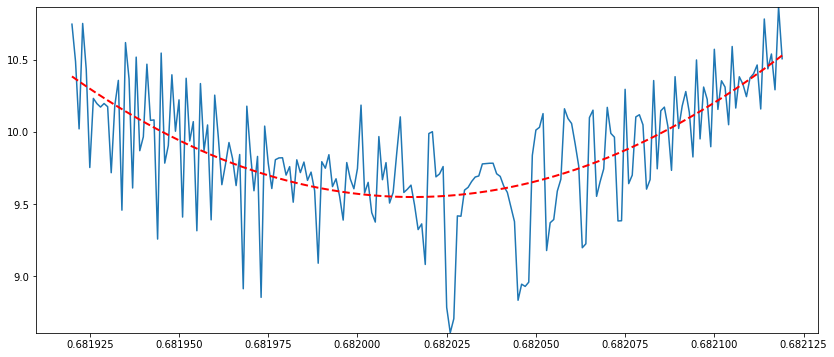

[ 118.79228461 -425.08988755  246.42530319]
[-354.85963647  474.16841941 -146.55649546]
[  78.64128267 -161.03944349   85.02046697]
[  581.60506824 -1016.60308821   434.56388972]
[-3933.06946788  4404.34824666 -1162.67182614]
period: 1.0238861703077058
variance: 10000000000.009296


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


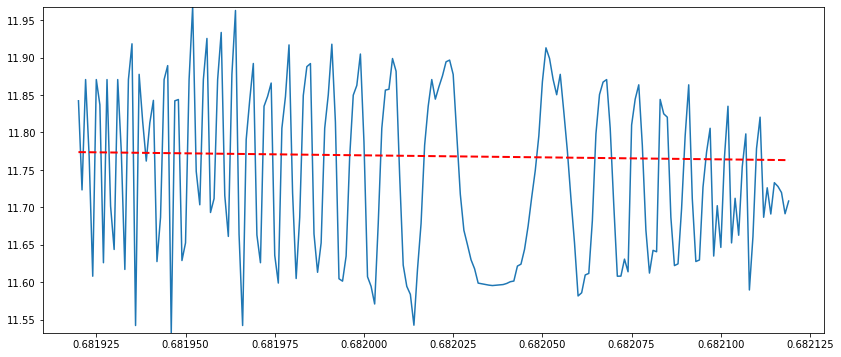

[ 75317.8629085  -46858.37618618  -3065.01949167]
[  494.41777095  3724.53543423 -2759.92158867]
[ 347.19307503  224.23077203 -304.20355662]
[ 159.74078446 -150.28504651   38.43676354]
[ 4536493.38701081 -6187286.55928538  2109707.74903877]
period: -0.32291941884507885
variance: inf


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


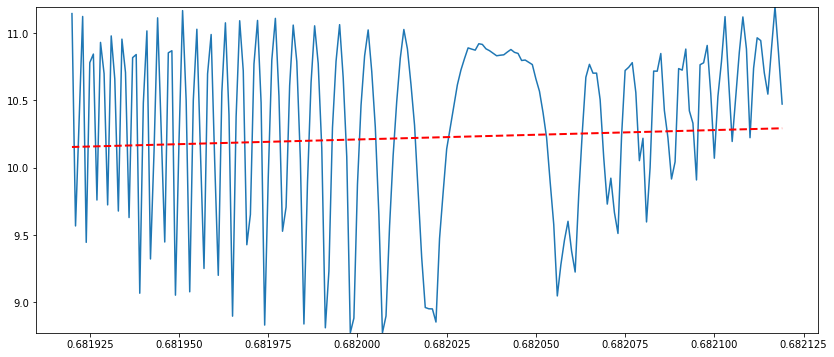

[  929.93769211 -7715.0977728   4837.8332952 ]
[  342.11976596 -2399.71918403  1486.24142174]
[  29.26960104  318.92330607 -222.2712297 ]
[ 2.12198334e+08 -2.89455620e+08  9.87102038e+07]
[ 1.62783100e+08 -2.22048472e+08  7.57227402e+07]
period: 0.6820402735067567
variance: inf


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


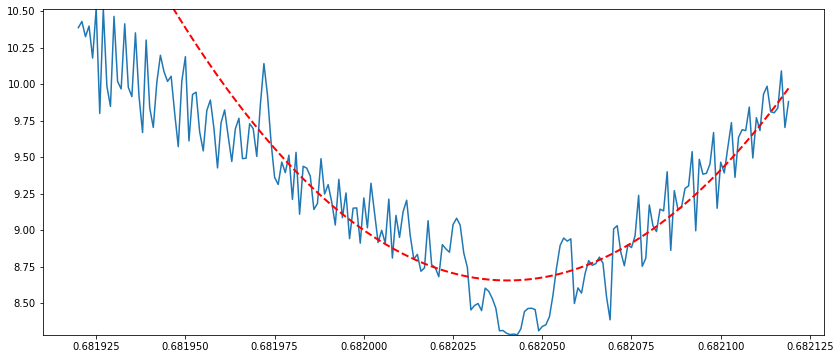

[ 1392.52763925  1705.63179102 -1802.46392427]
[ 4012.33681811 -1805.16638356  -626.51142965]
[ 8.44815467e+07 -1.15232331e+08  3.92940635e+07]
[ 1.94539519e+08 -2.65353588e+08  9.04861560e+07]
[ 1.72404134e+08 -2.35160588e+08  8.01902289e+07]
period: 0.6820043262016291
variance: nan


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


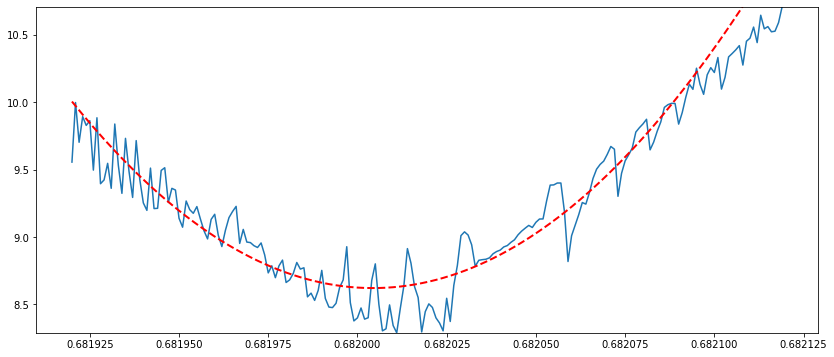

[-94868.12864214  29254.34472039  24186.70108043]
[   480.76819877 -12788.60963672   8508.13652914]
[   43.53477227 -3477.18727211  2361.01652969]
[ 7.66858543e+07 -1.04605980e+08  3.56728571e+07]
[-1153.77931032  -304.50816095   754.30551405]
period: 0.6820422178294757
variance: 10000000000.0


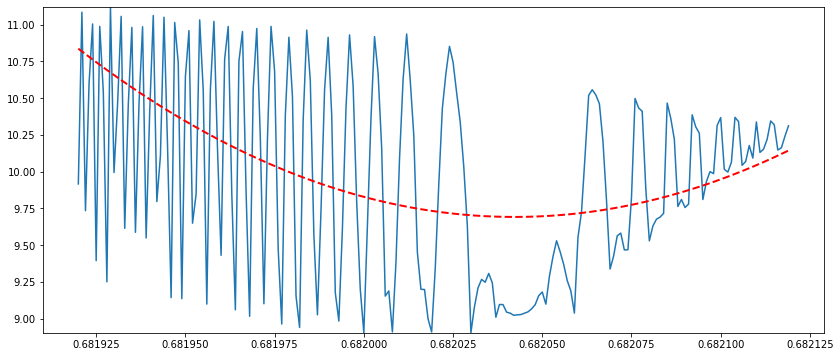

[10294.14831607 -4660.77370243 -1600.62980273]
[ -377.29199804 -2943.78418904  2192.36618969]
[ -827.71329267 -1324.49795455  1297.5927904 ]
[ 1.47980495e+08 -2.01854804e+08  6.88357061e+07]
[ 1.36989936e+08 -1.86862068e+08  6.37226328e+07]
period: -3.901201462416259
variance: inf


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


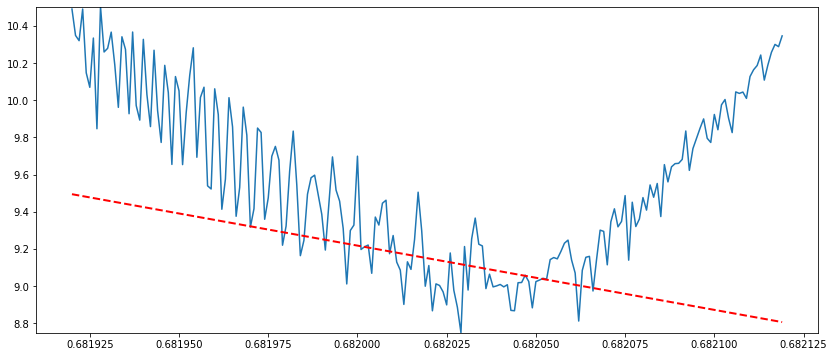

/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


[19313.62954755 -7758.39616485 -3683.65895235]
[ 1297.00894013  1325.52543084 -1498.53112077]
[ 632798.53608596 -857389.60403898  290418.77859382]
[ 1.84838385e+08 -2.52123065e+08  8.59751700e+07]
[ 1.59589141e+08 -2.17681620e+08  7.42301339e+07]
period: 0.6774585868530772
variance: inf


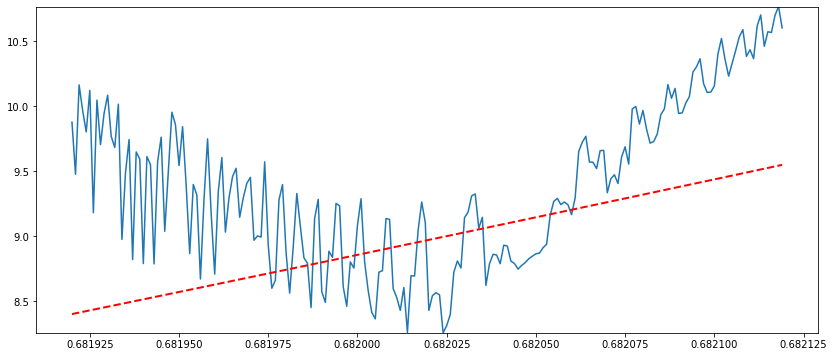

[-8380.21098142  5106.00097576   424.46918082]
[ -832.7365248  -5155.58391962  3912.44588135]
[ 9.29732338e+07 -1.26820304e+08  4.32473742e+07]
[ 1.53424177e+08 -2.09273996e+08  7.13636078e+07]
[ 1.55054009e+08 -2.11496390e+08  7.21212061e+07]
period: 0.6820087774336621
variance: 0.011649234473834934


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


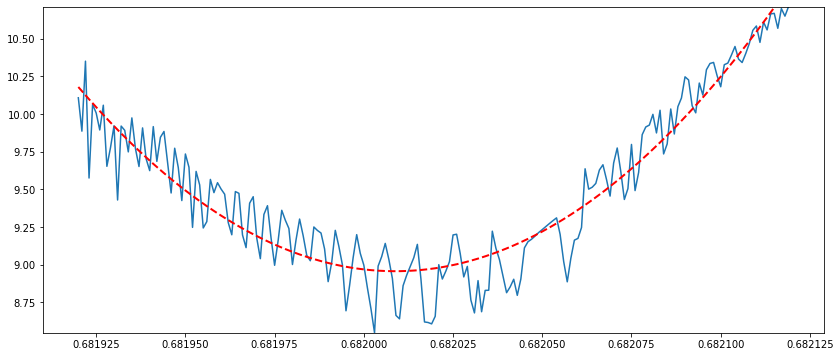

[-6174.43667233  5222.36632232  -680.6068278 ]
[-5402.05695428  3490.01211059   141.66364083]
[ 18064074.52539717 -24641174.99741056   8403256.03325147]
[ 1.52582861e+08 -2.08127470e+08  7.09729935e+07]
[ 1.49358341e+08 -2.03728298e+08  6.94725594e+07]
period: 0.6820491955667678
variance: inf


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


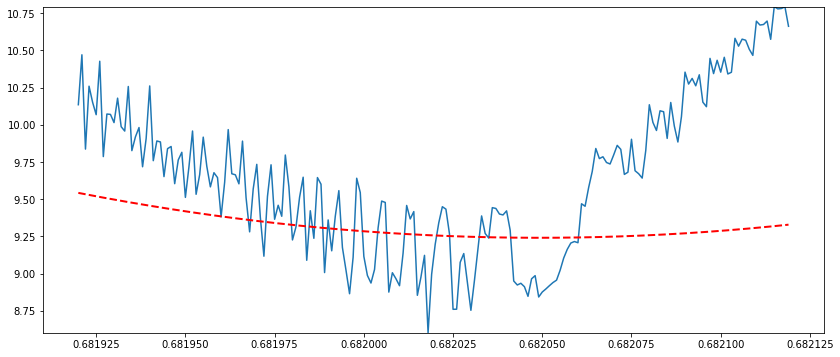

[ 41182.23670042 -31727.58318354   2492.40891395]
[-1145.88805789 -1284.10348363  1418.38989646]
[  9699.46957446 -12866.8813302    4273.46303124]
[ 1.01373225e+08 -1.38277702e+08  4.71542821e+07]
[ 1.16805965e+08 -1.59328495e+08  5.43327861e+07]
period: 0.6820220869536054
variance: 0.04431513336256688


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


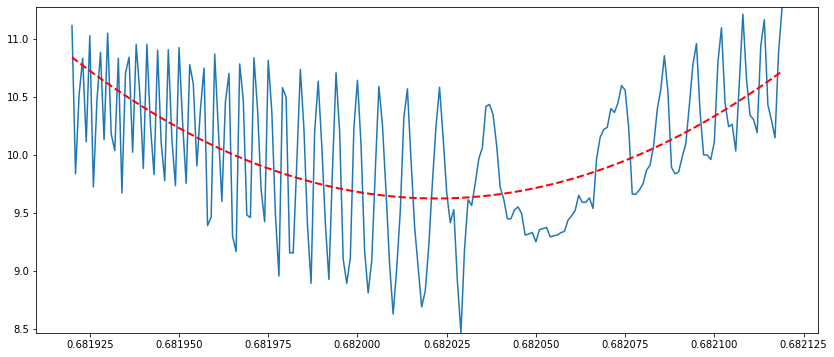

[ -288.75515382 -3538.81541879  2559.39033431]
[-2115.25961104 -5906.852018    5024.49966387]
[-6963.91616327  2890.08622696  1279.98582996]
[-15874.970883    16570.58316157  -3905.51234348]
[-32331.63819141  40436.81264728 -12528.01346133]
period: -6.127709535183302
variance: 14142135623.730951


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


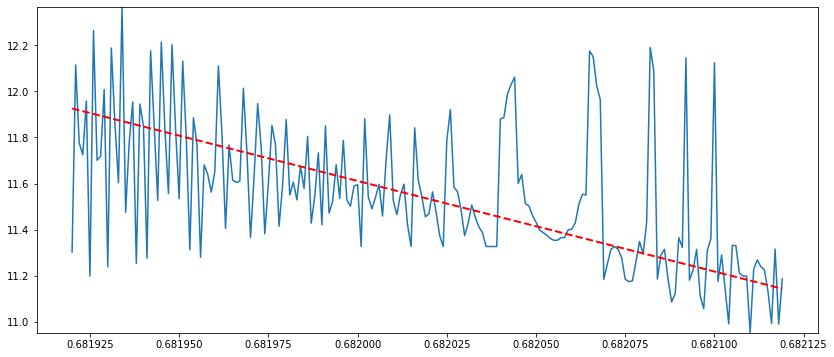

[10374.71861955 -6615.44142494  -305.26293524]
[ 5607.44025557 -4192.47092382   259.90461101]
[ 1.72424679e+08 -2.35193883e+08  8.02033807e+07]
[ 2.13951438e+08 -2.91838310e+08  9.95197879e+07]
[ 1.80761394e+08 -2.46564498e+08  8.40805337e+07]
period: 0.6820191996572913
variance: nan


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


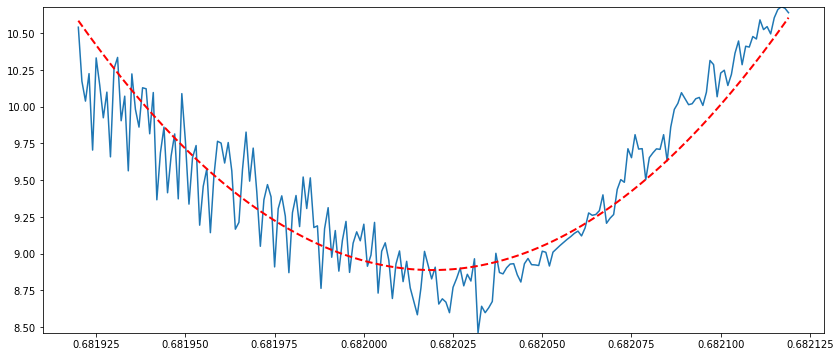

[-2790.27499646 -1689.58713733  2459.42262158]
[-3931.49677137  -264.36893888  2018.2605688 ]
[-3556.40981518  -269.79298955  1847.56245368]
[ 66053.0148814  -93530.00089479  33074.11695319]
[ 1.37971317e+08 -1.88194567e+08  6.41749331e+07]
period: -0.3027635518864995
variance: nan


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


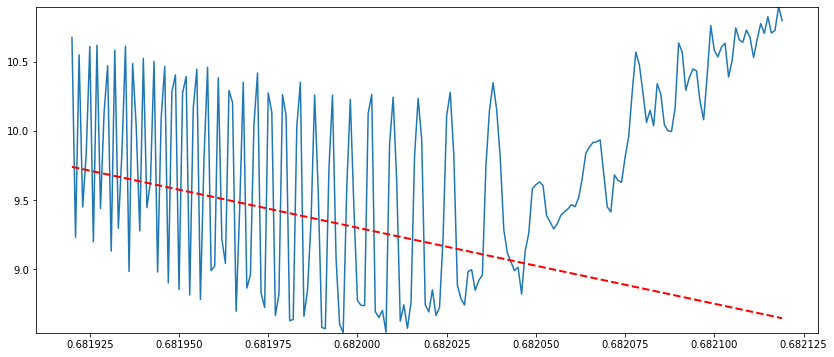

/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


[ 9770.8032341  -2502.28433773 -2829.53714925]
[  711.66124084 -3099.41671953  1791.83346629]
[1747.74712611 -805.53346488 -254.4770768 ]
[ 1.92036279e+08 -2.61949461e+08  8.93288591e+07]
[ 1.55163885e+08 -2.11652406e+08  7.21765033e+07]
period: 0.682028573354256
variance: 0.021365277006415686


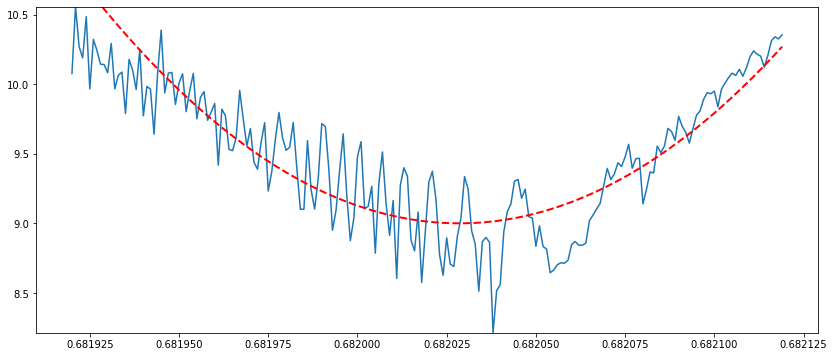

/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


[ 18522.07205628 -11529.24879748   -742.75303706]
[   98.96125727 -1732.70175095  1145.40269394]
[-673.22036893  346.51589061   86.55601244]
[ 7.78715067e+07 -1.06219156e+08  3.62215672e+07]
[ 8.12294635e+07 -1.10799152e+08  3.77832587e+07]
period: 0.6820155416010854
variance: nan


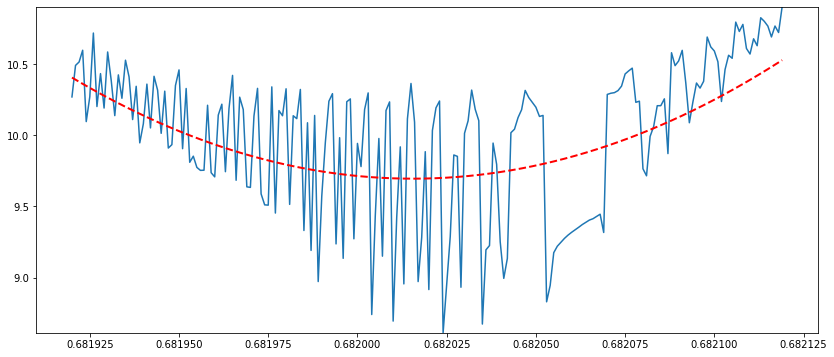

/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


[-323.46893366 1123.31394323 -603.75184056]
[-298.88694928  478.13265654 -175.20828882]
[ 313.45727337 -327.32227036   89.29743464]
[-88.60866786 200.84267943 -83.90175742]
[ 359.61768135 -402.01756682  118.76825868]
period: 0.5221162470374888
variance: inf


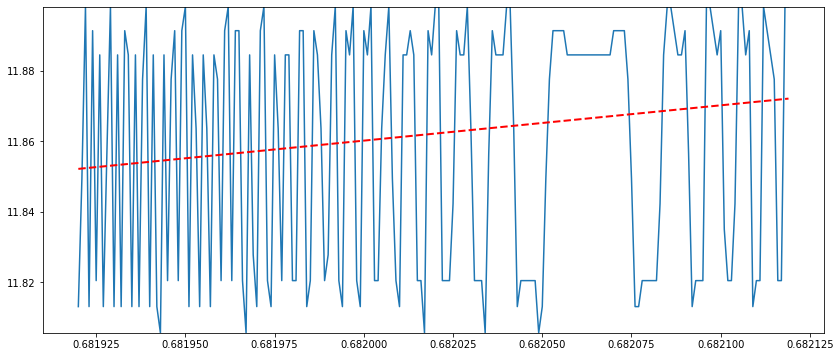

[-230.87597251  522.19359025 -236.83082059]
[ 599.044106   -304.8453844   -58.78680551]
[ 444.79509939 -431.09307135   99.03683925]
[ 424.51580284 -474.14968457  137.8295977 ]
[ 541.0591442  -637.65997951  195.13614021]
period: 0.5584594040982646
variance: inf


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


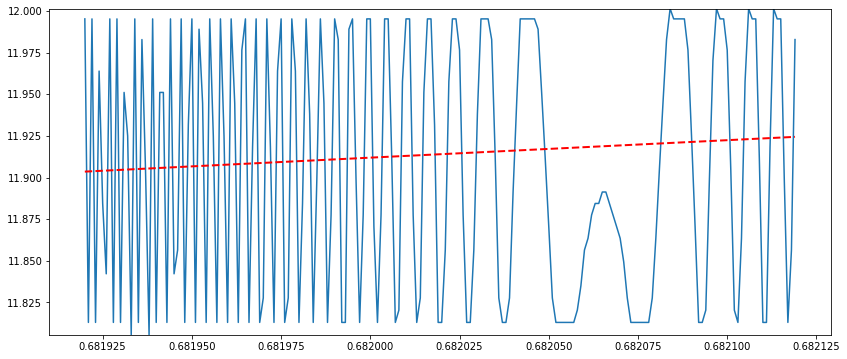

[ 11048.89657705  13247.91385711 -14166.0529836 ]
[1546.88940366 -698.47889412 -234.07844037]
[ 10443.51674868 -13465.22702114   4334.96759605]
[ 7.74629749e+07 -1.05663555e+08  3.60326647e+07]
[ 1.09804156e+08 -1.49778648e+08  5.10764994e+07]
period: 0.6820263201126864
variance: 0.0377336428437437


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


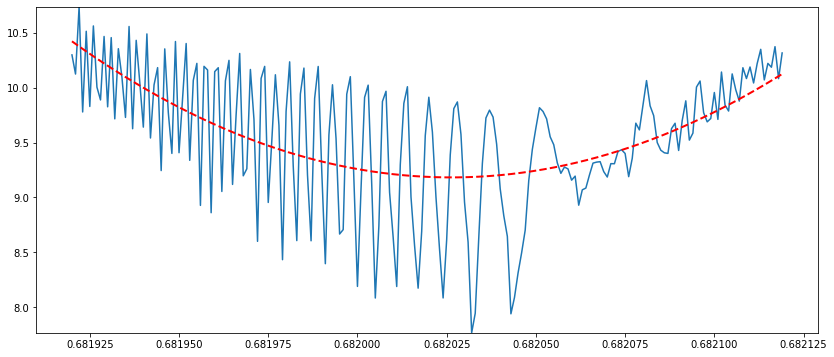

[16306.83875608  1155.02413135 -8364.09294833]
[-2376.98591337 -2599.93026366  2888.16472488]
[-5239.77072041  2547.43752678   709.26297694]
[ 1.06037320e+08 -1.44645205e+08  4.93275370e+07]
[ 1.04043663e+08 -1.41925042e+08  4.83996838e+07]
period: -0.035415329378809215
variance: nan


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


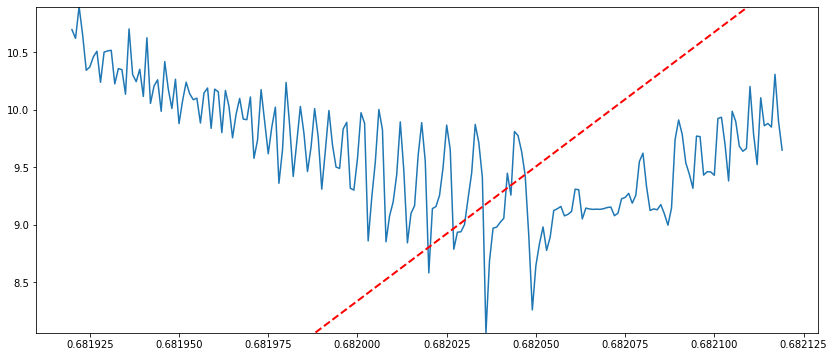

[-29281.37589135  16884.94003289   2113.63672102]
[  142.35000834 -3512.53436037  2339.31278641]
[-7132.99044308  6182.82005569  -888.99062424]
[-9203.55815105  7384.48389494  -745.50915692]
[  338.24806291 -2276.82737242  1405.48692547]
period: 3.3656177552471966
variance: 57947.93354135639


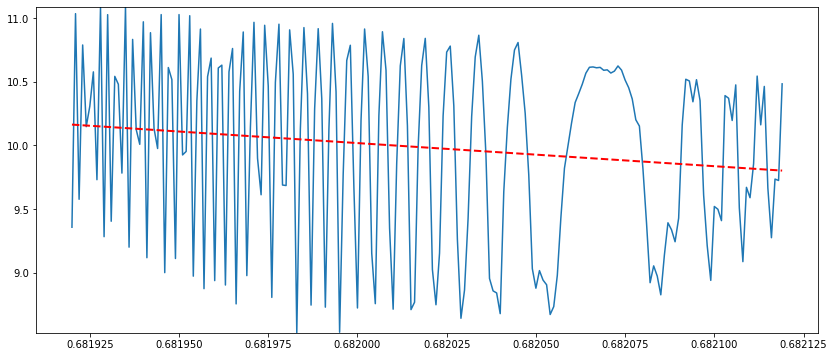

[-17121.63684506   3113.65857282   5850.34065279]
[ 3756.00238965 -1626.88165487  -627.82443068]
[ -914.3261434  -1585.44324025  1516.3281039 ]
[ 598.38432608 -776.65509365  261.17377485]
[ 58103509.53461333 -79255517.97831741  27026936.2312458 ]
period: 0.6489600911966487
variance: inf


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


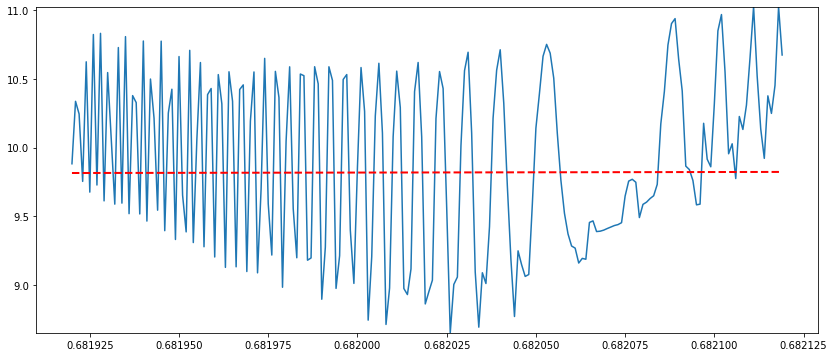

[-243.41433145 -263.20788513  301.71889798]
[-1509.68431071 -1052.91761159  1429.42853758]
[ 288143.14559273 -394231.88953442  134853.02850557]
[ 1.28166835e+08 -1.74827741e+08  5.96190578e+07]
[ 1.33968635e+08 -1.82741015e+08  6.23173536e+07]
period: 0.6820319057661374
variance: nan


/tmp/ipykernel_62213/2076294173.py:23: RuntimeWarning: invalid value encountered in sqrt
  pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit


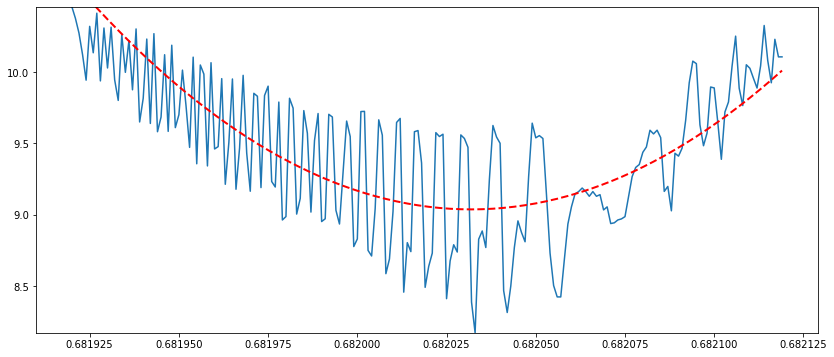

[-1845.68469232 -2448.03613136  2537.31489798]
[ 2019.63909821 -1350.19172242    -9.40291029]
[ 7300.78886828 -5129.00098491   111.42486544]
[ 3467.6715857   -820.1899713  -1044.16384775]
[ 1.11467300e+08 -1.52045422e+08  5.18488707e+07]
period: 0.11826234852889383
variance: inf


/home/donlon/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


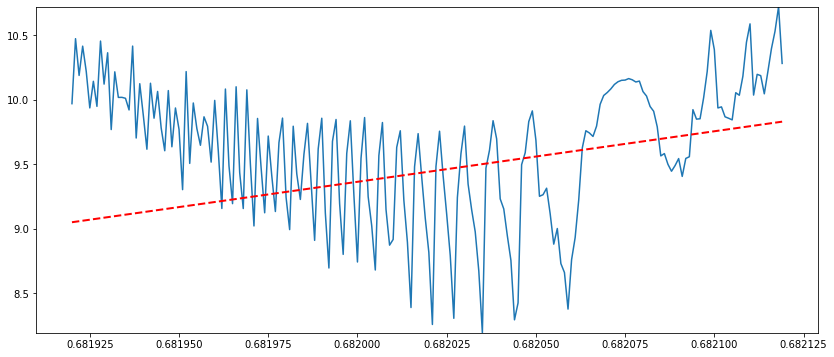

[ -69.81218179 -726.63956952  538.08091833]
[ 5540.48304718 -1947.29584316 -1238.88672506]
[ 4.44849854e+08 -6.06798097e+08  2.06925969e+08]
[ 3.61876252e+08 -4.93619322e+08  1.68331058e+08]
[ 3.04562040e+08 -4.15439253e+08  1.41670467e+08]
period: 0.6820257345751042
variance: 0.0039301942932148


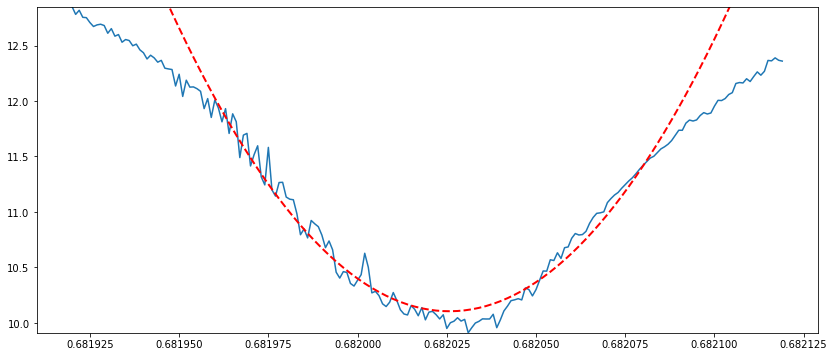

In [195]:
#plot likelihood surfaces
fit_periods = []
variances = []

def func(data, a, b, c):
    return a*data**2 + b*data + c

for key in data.keys():
    fig = plt.figure(figsize=(14, 6))
    plt.plot(times, np.log(all_like_list[key]))

    min_indx = np.argmin(all_like_list[key])
    #indx = (np.abs(times - times[min_indx]) < 0.00001)
    best_pf = 0
    best_unc = np.nan
    
    #try fitting to a variety of scales
    #in order to try to find the actual best fitting parabola to the LS
    for indx in [np.abs(times - times[min_indx]) < tol for tol in np.linspace(10*scan_width, scan_width*scan_n, 5)]:
        polyf = curve_fit(func, np.array(times)[indx], np.log(np.array(all_like_list)[key][indx]))
        pf = polyf[0]
        print(pf)
        pf_unc = np.sqrt(np.diag(polyf[1])) #diagonals of the covariance matrix for the fit
        #print(pf_unc)
        fit_unc = ((1/(4*pf[0]**2))*((pf[1]/pf[0])**2 * pf_unc[0]**2 + pf_unc[1]**2))**0.5
        if polyf[0][0] < 0:
            fit_unc = 1e10
        if fit_unc < best_unc or np.isnan(best_unc):
            best_unc = fit_unc
            best_pf = pf
    plt.plot(times, best_pf[0]*times**2 + best_pf[1]*times + best_pf[2], c='r', lw=2, ls='--')
    
    fit_period = -best_pf[1]/(2*best_pf[0])
    mle_unc = 1/(2*best_pf[0])
    variance = (best_unc**2 + fit_unc**2)**0.5 #idk what else to do but add them in quadrature
    
    fit_periods.append(fit_period)
    variances.append(variance)
    
    print('period:', fit_period)
    print('variance:', variance)
    
    plt.ylim(np.min(np.log(np.array(all_like_list)[key])),
             np.max(np.log(np.array(all_like_list)[key])))
    
    plt.show()
    
fit_periods = np.array(fit_periods)
variances = np.array(variances)

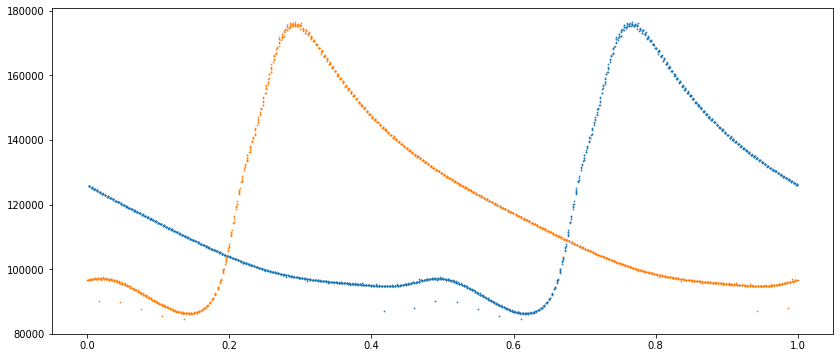

/tmp/ipykernel_62213/309669324.py:5: RuntimeWarning: invalid value encountered in remainder
  folded_bjds = (data[key]['bjds'] % best_periods[key])/best_periods[key]
/tmp/ipykernel_62213/309669324.py:8: RuntimeWarning: invalid value encountered in remainder
  folded_bjds = (data[key]['bjds'] % fit_periods[key])/fit_periods[key]


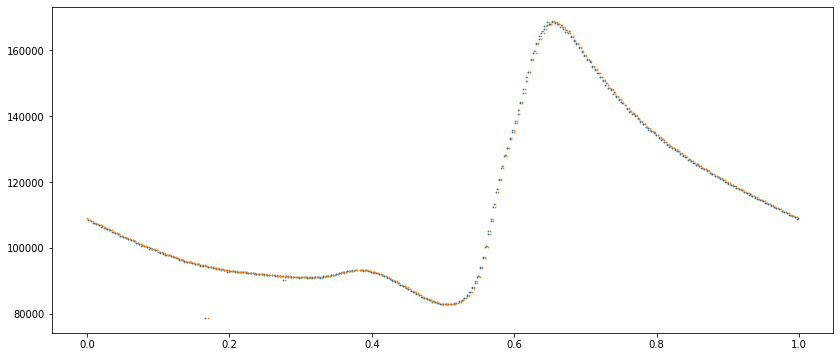

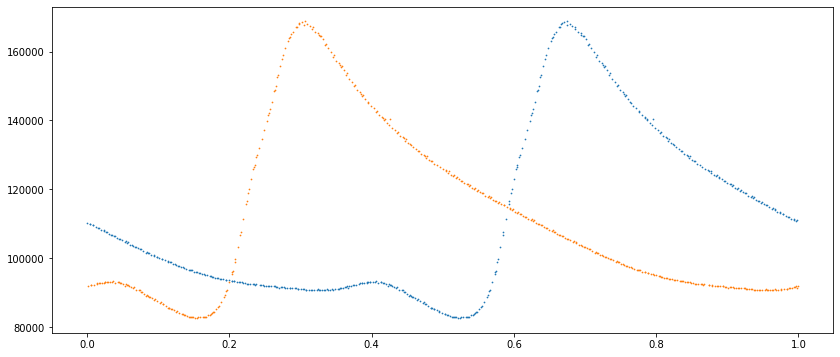

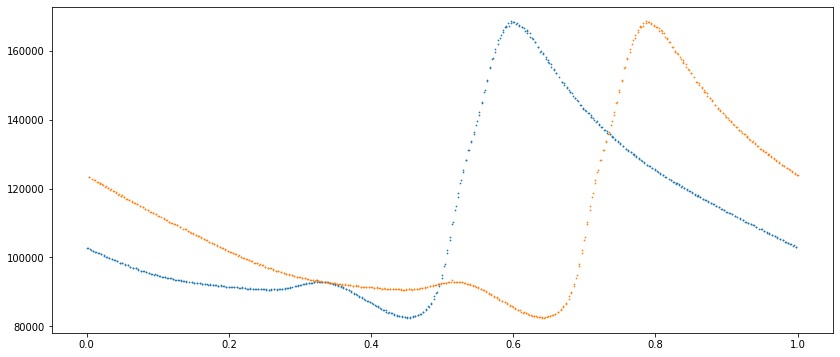

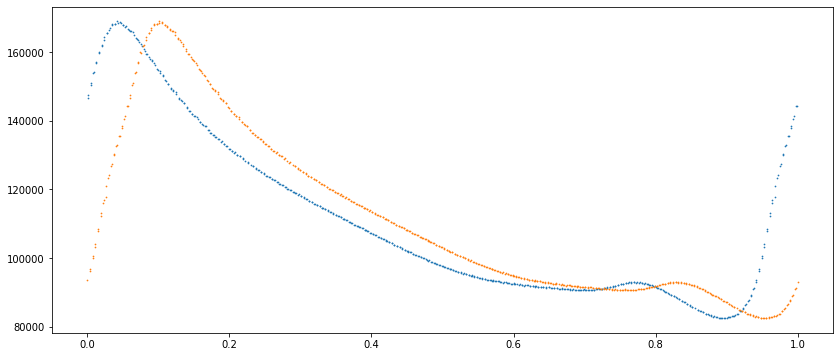

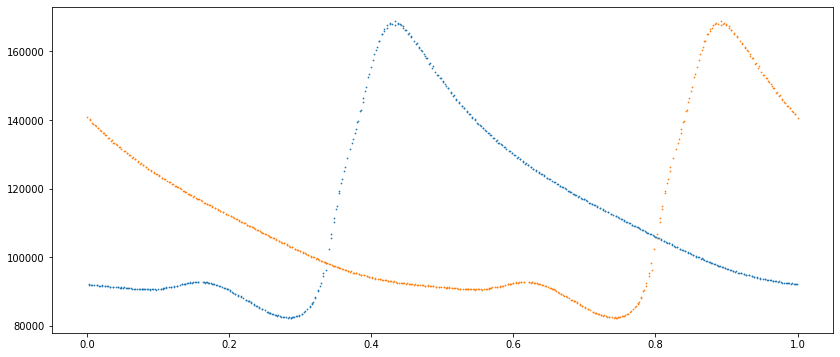

...

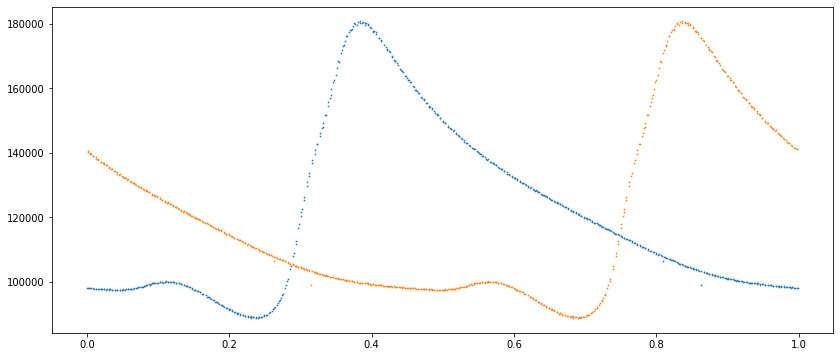

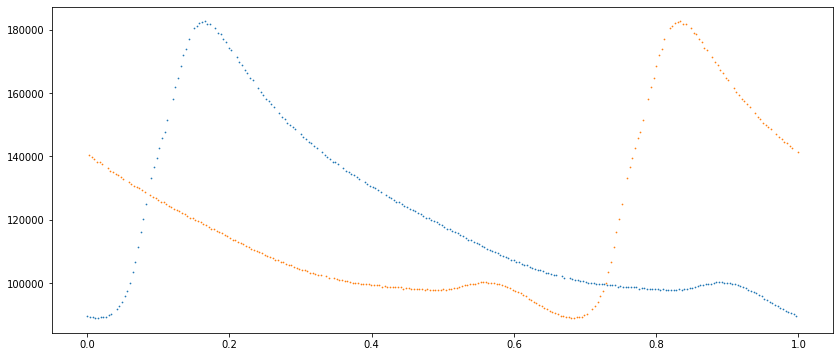

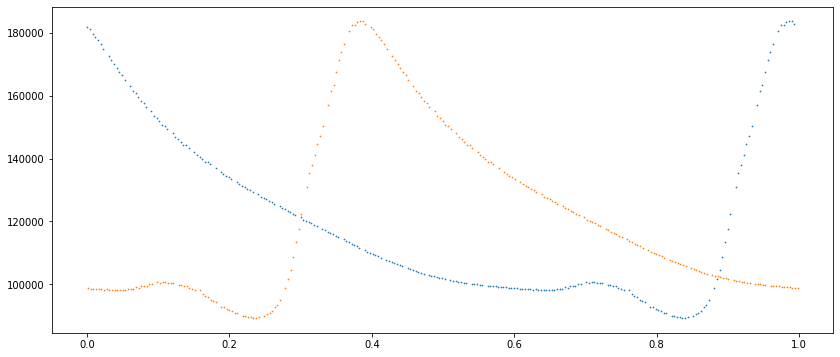

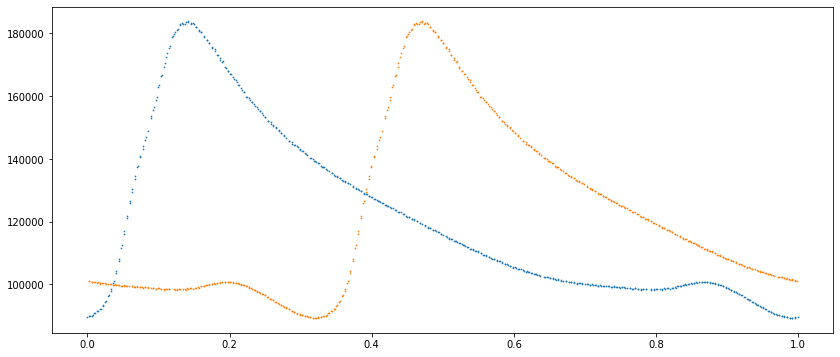

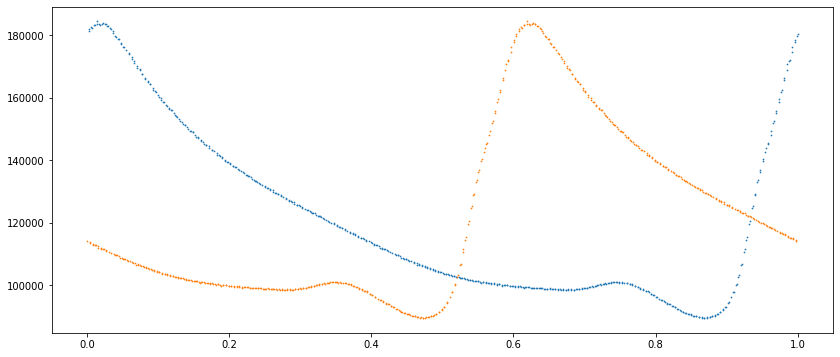

KeyboardInterrupt: 

In [197]:
#print the optimized data 
for key in data.keys():
    fig = plt.figure(figsize=(14, 6))
    
    folded_bjds = (data[key]['bjds'] % best_periods[key])/best_periods[key]
    plt.scatter(folded_bjds, data[key]['pdcsap_fluxes'], s=0.5)
    
    folded_bjds = (data[key]['bjds'] % fit_periods[key])/fit_periods[key]
    plt.scatter(folded_bjds, data[key]['pdcsap_fluxes'], s=0.5)
    
    plt.show()
    
for key in data.keys():
    
    fig = plt.figure(figsize=(14, 6))
    
    folded_bjds = (data[key]['bjds'] % best_periods[key])/best_periods[key]
    plt.scatter(folded_bjds, data[key]['pdcsap_fluxes'], s=10)
    
    folded_bjds = (data[key]['bjds'] % period)/period
    plt.scatter(folded_bjds, data[key]['pdcsap_fluxes'], s=10)
    
    plt.xlim(0.625, 0.675)
    plt.show()

dp/dt: 1.2217593737754623e-08
std dev: 6.083572309763157e-09
dp/dt: 0.5559005150678353 mm/s/yr
std dev: 0.2768025400942236 mm/s/yr


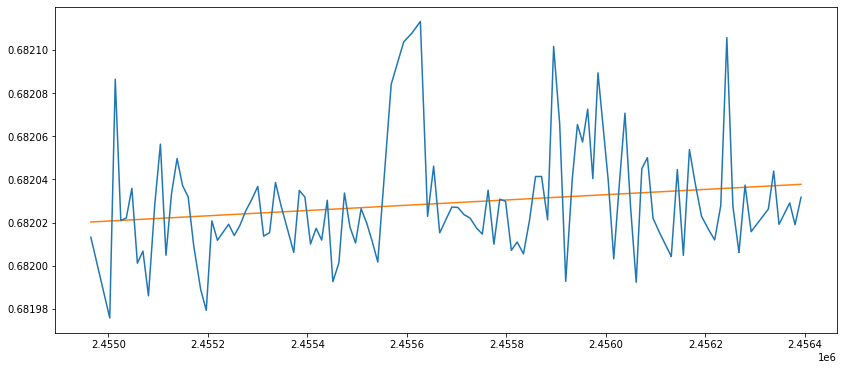

dp/dt: -9.131209011604182e-08
uncertainty: 1.4834499301923787e-08


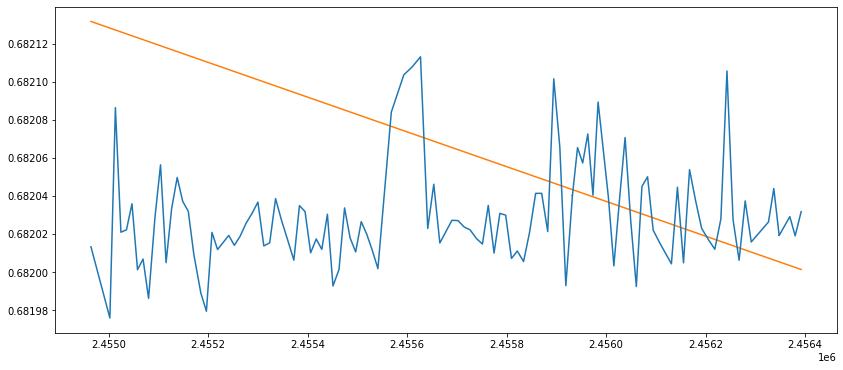

In [198]:
#plot period as a function of time

fig = plt.figure(figsize=(14, 6))
indx = [np.logical_not(np.isnan(x))][0]
x = np.array([data[key]['bjds'][1] for key in data.keys()])
indx = ([np.logical_not(np.isnan(x))][0]) * (np.abs(fit_periods - np.nanmean(fit_periods)) < np.nanstd(fit_periods))
x = x[indx]
plt.errorbar(x, fit_periods[indx], yerr=variances[indx])

lf = linregress(x, fit_periods[indx])
plt.plot([np.min(x), np.max(x)], [lf[0]*np.min(x) + lf[1], lf[0]*np.max(x) + lf[1]])
print('dp/dt:', lf.slope)
print('std dev:', lf.stderr)
conv = 45.5e6 # 3e8 m/s * 1 (dp/dt) days / (4.25 years)^2 in mm/s/yr 
print('dp/dt:', lf.slope*conv, 'mm/s/yr')
print('std dev:', lf.stderr*conv, 'mm/s/yr')
print('==========================')
plt.show()

def func(x, m, b):
    return m*x + b

cf = curve_fit(func, x, fit_periods[indx], sigma=variances[indx])
perr = np.sqrt(np.diag(cf[1]))
print('dp/dt:', cf[0][0])
print('uncertainty:', perr[0])

fig = plt.figure(figsize=(14, 6))
plt.errorbar(x, fit_periods[indx], yerr=variances[indx])
plt.plot([np.min(x), np.max(x)], [cf[0][0]*np.min(x) + cf[0][1], cf[0][0]*np.max(x) + cf[0][1]])
plt.show()